# 성별 및 정권 분석

In [1]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
import re
from tqdm import tqdm
from gensim.models import Word2Vec
from sklearn.cluster import KMeans
import os
from gensim import models
import fasttext.util
from sklearn.cluster import AgglomerativeClustering
from konlpy.tag import Okt
import logging
import hanja
from krwordrank.hangle import normalize
import datetime
%matplotlib inline

In [2]:
# 한글폰트 설정
import matplotlib as mpl
import matplotlib.pyplot as plt
 
%config InlineBackend.figure_format = 'retina'
 
!apt -qq -y install fonts-nanum
 
import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)
plt.rc('font', family='NanumBarunGothic') 
mpl.font_manager._rebuild()

Unable to locate an executable at "/Library/Java/JavaVirtualMachines/jdk-14.0.1.jdk/Contents/Home/bin/apt" (-1)


In [3]:
gender = pd.read_csv('whole-gender-bill-1320.csv', index_col=0,
                           parse_dates=['제안일자','의결일자'],encoding='utf-8-sig')
print(gender.shape)
gender.head(1)

(4295, 16)


,의안번호,의안명,제안일자,제안자구분,의결일자,의결결과,제안회기,제안이유,소관위원회,제안자,발의자,제안정당,성별,여성의원 수,정당성향,국회회기
0,131131,소득세법중개정법률안,1990-12-17,위원장,1990-12-18,원안가결,제13대 (1988~1992) 제151회,"정부제출,柳인학·강金식·금봉욱·林춘원·李경재·허만기·홍영기의원외64인 발의,1...",재무위원회,[],위원장,위원장,NaN,0,NaN,13


In [4]:
gender['제안일자'] = gender['제안일자'].dt.date
gender['의결일자'] = gender['의결일자'].dt.date

In [5]:
gender['제안일자'].unique()

array([datetime.date(1990, 12, 17), datetime.date(1990, 11, 20),
       datetime.date(1990, 10, 8), ..., datetime.date(2016, 6, 1),
       datetime.date(2016, 5, 31), datetime.date(2016, 5, 30)],
      dtype=object)

In [6]:
drop_list = [177919, 177064, 176854, 176797, 176796, 176795, 176794]

gender = gender[~gender['의안번호'].isin(drop_list)]
gender.shape

(4288, 16)

## 전체 성별-정권별 wordcloud

In [6]:
#gender = gender_total[gender_total['제안자구분'] == '의원']

In [7]:
gender['정당성향'].value_counts()

진보    2152
보수    1558
Name: 정당성향, dtype: int64

In [8]:
# 한글 전처리
def preprocessing(text): 
    text_pre1 = re.sub('[-=.#/:$}·,■?]', ' ', text)
    text_pre2 = re.sub('[^가-힣ㄱ-ㅎㅏ-ㅣa-zA-Z]', ' ', text_pre1)
    return str(text_pre2)

# 의미없는 단어 삭제 
def remove_stopword(text): 
    stopwords = ['사이','을','이','의','를','에','가','들','은','는','으로','한','도','항','관','정',
              '수','에서','로','것','그','과','제','입니다','할','하고','적','하는','로부터','면','관','항','이',
              '합니다','와','에게','고','인','하여','등','저','있습니다','말','까지','일명','보장하',
              '그리고','다','만','했습니다','안','된','못','일','더','위','최근','인한','있어'
              '있는','해','또한','명','하지','정말','물','많은','것임','류','줄','통해',
              '중','게','너무','자','이런','때','되지','위해','에는','없는','중','물이',
              '및','요','때문','관련','대한','전','라고','되었습니다','하기','나','후','같은','해서',
              '글','되어','주','차','하','내','없이','대해','잘','항','조','경우','함안','기간','하려는','일부',
              '마련','있도록','또는','함','하도록','개월','분','부터','제호','관','되고','년','월','및','등',\
              '안','바','이','것','부터','수','시','자',
            '조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출']

    text = [word for word in text if word not in stopwords]
    return text

In [9]:
gender['의안텍스트'] = (gender['의안명'] + ' ' + gender['제안이유']).str.strip()
gender['의안텍스트'] = gender['의안텍스트'].apply(lambda x:str(x).lower())

In [10]:
%time gender['의안텍스트'] = gender['의안텍스트'].apply(preprocessing)

CPU times: user 303 ms, sys: 5.55 ms, total: 308 ms
Wall time: 314 ms


In [11]:
from konlpy.tag import Mecab, Okt, Hannanum

# okt = Okt()
hannanum = Hannanum()

def get_tokens(x):
    try:
        return [i for i in hannanum.nouns(x) if len(i) > 1] if x else []
    except Exception as e:
        if str(x) == 'nan':
            return []
        print(e)
        print(str(x))
        raise e

In [12]:
# 단어에서 명사만 뽑아내기
# okt = Okt()
%time gender['tokens'] = gender['의안텍스트'].apply(get_tokens)
gender['tokens'][:3]

CPU times: user 2min 48s, sys: 1.45 s, total: 2min 50s
Wall time: 2min 34s


0    [소득세법중개정법률, 정부제출, 인학, 금봉욱, 춘원, 경재, 허만기, 홍영기의원외...
1    [특정범죄가중처벌등에관한법률중개정법률안, 정부, 제출, 각특정범죄가중처벌등에관한법률...
2    [유아의보호, 교육에관한법률안, 현대사회, 산업화, 여성, 사회참여, 가족구조, 핵...
Name: tokens, dtype: object

In [13]:
%time gender['tokens'] = gender['tokens'].apply(remove_stopword)

CPU times: user 1.47 s, sys: 13.8 ms, total: 1.48 s
Wall time: 1.52 s


In [14]:
%time gender['명사수'] = gender['tokens'].apply(len)

CPU times: user 2.87 ms, sys: 207 µs, total: 3.08 ms
Wall time: 3.05 ms


In [15]:
# 명사 수가 10개를 넘어가는 경우만 추출
#gender = gender[gender['명사수'] >= 10]
#gender = gender.reset_index(drop=True)
print(gender.shape)

(4288, 19)


## 정권 탐색 

### 노태우 정권 
- 1998.02.25 ~ 1993.02.24

In [250]:
notaewoo = gender[(gender['제안일자'] > datetime.date(1988,5,3)) & 
                        (gender['제안일자'] < datetime.date(1993,2,24))]
notaewoo.shape

(23, 19)

In [251]:
notaewoo['성별'].value_counts()

남성    7
여성    6
Name: 성별, dtype: int64

In [252]:
pd.DataFrame(notaewoo.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    4
     여성    4
진보   남성    3
     여성    2

#### 여성/남성 wordcloud

In [253]:
women = notaewoo[notaewoo['성별'] == '여성']
men = notaewoo[notaewoo['성별'] == '남성']

In [254]:
# word2vec 모델 학습에 로그를 찍기
logging.basicConfig(
    format='%(asctime)s : %(levelname)s : %(message)s', 
    level=logging.INFO)

In [255]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 15:08:43,616 : INFO : collecting all words and their counts
2020-10-20 15:08:43,617 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 15:08:43,620 : INFO : collected 704 word types from a corpus of 1067 raw words and 6 sentences
2020-10-20 15:08:43,621 : INFO : Loading a fresh vocabulary
2020-10-20 15:08:43,623 : INFO : effective_min_count=10 retains 4 unique words (0% of original 704, drops 700)
2020-10-20 15:08:43,624 : INFO : effective_min_count=10 leaves 55 word corpus (5% of original 1067, drops 1012)
2020-10-20 15:08:43,625 : INFO : deleting the raw counts dictionary of 704 items
2020-10-20 15:08:43,626 : INFO : sample=0.001 downsamples 4 most-common words
2020-10-20 15:08:43,627 : INFO : downsampling leaves estimated 3 word corpus (6.7% of prior 55)
2020-10-20 15:08:43,628 : INFO : estimated required memory for 4 words and 100 dimensions: 5200 bytes
2020-10-20 15:08:43,629 : INFO : resetting layer weights
2020-10-20 15:08:43,632 : I

2020-10-20 15:08:43,748 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:43,749 : INFO : EPOCH - 15 : training on 1067 raw words (7 effective words) took 0.0s, 1768 effective words/s
2020-10-20 15:08:43,752 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:43,753 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:43,754 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:43,755 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:43,756 : INFO : EPOCH - 16 : training on 1067 raw words (3 effective words) took 0.0s, 870 effective words/s
2020-10-20 15:08:43,760 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:43,761 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:43,761 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:43

2020-10-20 15:08:43,934 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:43,939 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:43,939 : INFO : EPOCH - 32 : training on 1067 raw words (1 effective words) took 0.0s, 131 effective words/s
2020-10-20 15:08:43,942 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:43,944 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:43,945 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:43,947 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:43,947 : INFO : EPOCH - 33 : training on 1067 raw words (3 effective words) took 0.0s, 536 effective words/s
2020-10-20 15:08:43,949 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:43,951 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:43,

2020-10-20 15:08:44,135 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,138 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,139 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,142 : INFO : EPOCH - 49 : training on 1067 raw words (3 effective words) took 0.0s, 345 effective words/s
2020-10-20 15:08:44,149 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,150 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,152 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,153 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,153 : INFO : EPOCH - 50 : training on 1067 raw words (2 effective words) took 0.0s, 408 effective words/s
2020-10-20 15:08:44,157 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,

2020-10-20 15:08:44,354 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,355 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,357 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,358 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,360 : INFO : EPOCH - 66 : training on 1067 raw words (3 effective words) took 0.0s, 458 effective words/s
2020-10-20 15:08:44,363 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,364 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,366 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,367 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,372 : INFO : EPOCH - 67 : training on 1067 raw words (1 effective words) took 0.0s, 114 effective words/s
2020-10-20 15:08:44,

2020-10-20 15:08:44,573 : INFO : EPOCH - 82 : training on 1067 raw words (1 effective words) took 0.0s, 212 effective words/s
2020-10-20 15:08:44,576 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,577 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,579 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,580 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,581 : INFO : EPOCH - 83 : training on 1067 raw words (0 effective words) took 0.0s, 0 effective words/s
2020-10-20 15:08:44,584 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,585 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,587 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,589 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,59

2020-10-20 15:08:44,734 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,735 : INFO : EPOCH - 99 : training on 1067 raw words (3 effective words) took 0.0s, 609 effective words/s
2020-10-20 15:08:44,738 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,740 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,742 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,743 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,744 : INFO : EPOCH - 100 : training on 1067 raw words (4 effective words) took 0.0s, 686 effective words/s
2020-10-20 15:08:44,745 : INFO : training on a 106700 raw words (371 effective words) took 1.1s, 334 effective words/s
2020-10-20 15:08:44,747 : INFO : collecting all words and their counts
2020-10-20 15:08:44,749 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
202

2020-10-20 15:08:44,898 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,899 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,900 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,901 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,902 : INFO : EPOCH - 14 : training on 1189 raw words (5 effective words) took 0.0s, 939 effective words/s
2020-10-20 15:08:44,906 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:44,908 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:44,909 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:44,910 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:44,911 : INFO : EPOCH - 15 : training on 1189 raw words (8 effective words) took 0.0s, 1402 effective words/s
2020-10-20 15:08:44

2020-10-20 15:08:45,045 : INFO : EPOCH - 30 : training on 1189 raw words (4 effective words) took 0.0s, 869 effective words/s
2020-10-20 15:08:45,048 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,050 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,051 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,052 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,054 : INFO : EPOCH - 31 : training on 1189 raw words (5 effective words) took 0.0s, 809 effective words/s
2020-10-20 15:08:45,057 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,058 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,060 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,062 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,

2020-10-20 15:08:45,224 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,225 : INFO : EPOCH - 47 : training on 1189 raw words (6 effective words) took 0.0s, 1071 effective words/s
2020-10-20 15:08:45,228 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,229 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,231 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,231 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,233 : INFO : EPOCH - 48 : training on 1189 raw words (6 effective words) took 0.0s, 1438 effective words/s
2020-10-20 15:08:45,237 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,239 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,241 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:4

2020-10-20 15:08:45,386 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,388 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,390 : INFO : EPOCH - 64 : training on 1189 raw words (3 effective words) took 0.0s, 553 effective words/s
2020-10-20 15:08:45,393 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,394 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,394 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,396 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,397 : INFO : EPOCH - 65 : training on 1189 raw words (4 effective words) took 0.0s, 860 effective words/s
2020-10-20 15:08:45,400 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,402 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,

2020-10-20 15:08:45,540 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,542 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,543 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,545 : INFO : EPOCH - 81 : training on 1189 raw words (5 effective words) took 0.0s, 895 effective words/s
2020-10-20 15:08:45,548 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,549 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,550 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,551 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,553 : INFO : EPOCH - 82 : training on 1189 raw words (6 effective words) took 0.0s, 1107 effective words/s
2020-10-20 15:08:45,556 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45

2020-10-20 15:08:45,874 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,876 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,877 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,878 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,879 : INFO : EPOCH - 98 : training on 1189 raw words (2 effective words) took 0.0s, 471 effective words/s
2020-10-20 15:08:45,883 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 15:08:45,884 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 15:08:45,886 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 15:08:45,887 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 15:08:45,891 : INFO : EPOCH - 99 : training on 1189 raw words (5 effective words) took 0.0s, 575 effective words/s
2020-10-20 15:08:45,

In [256]:
#부녀자, 여자, 여성 모두 없음
#print(model_women.wv.most_similar('부녀자'))
#print(model_women.wv.most_similar('여자'))
#print(model_women.wv.most_similar('여성'))

In [257]:
# 또한 모두 없음. 
#print(model_men.wv.most_similar('부녀자'))
#print(model_men.wv.most_similar('여자'))
#print(model_men.wv.most_similar('여성'))

In [258]:
import nltk 
from wordcloud import WordCloud

def total_tokens(df): 
    gender_tokens = []
    for row in df: 
        for word in row: 
            gender_tokens.append(word)
    return gender_tokens

def frewords_vis(tokens): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    plt.figure(figsize=(12,6))
    ko.plot(50) # 상위 50 토큰를 정렬하여 보여줌 
    plt.show()
    
def wordcloud_vis(tokens, color): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    data = ko.vocab().most_common(150)
    data2 = dict(data)
    font_path = '/usr/share/fonts/BlackHanSans-Regular.ttf'

    wordcloud = WordCloud(font_path=font_path,
                          width = 800, 
                          colormap = f'{color}',
                         height = 800)

    wordcloud = wordcloud.generate_from_frequencies(data2)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [259]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [260]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

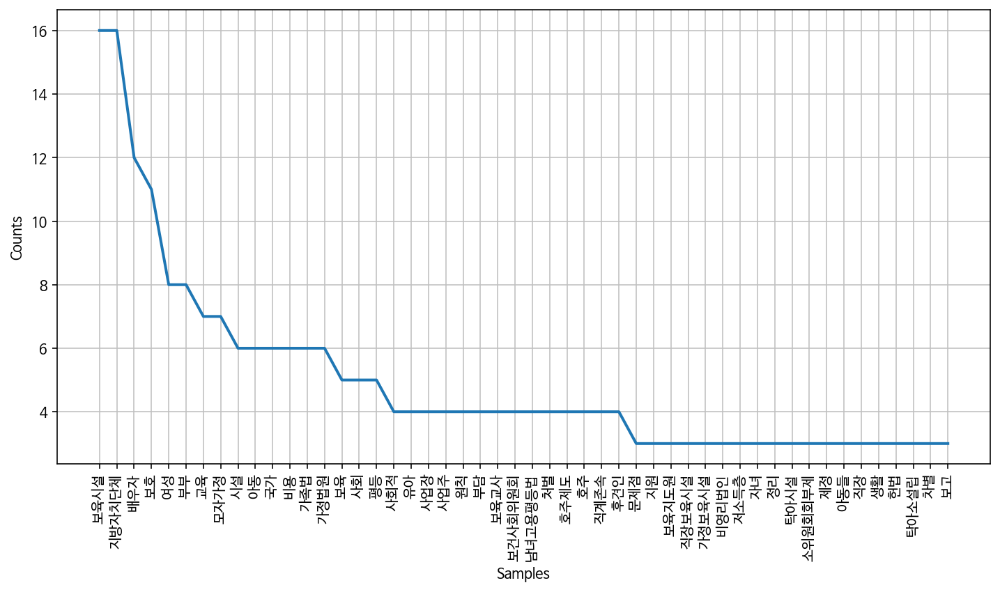

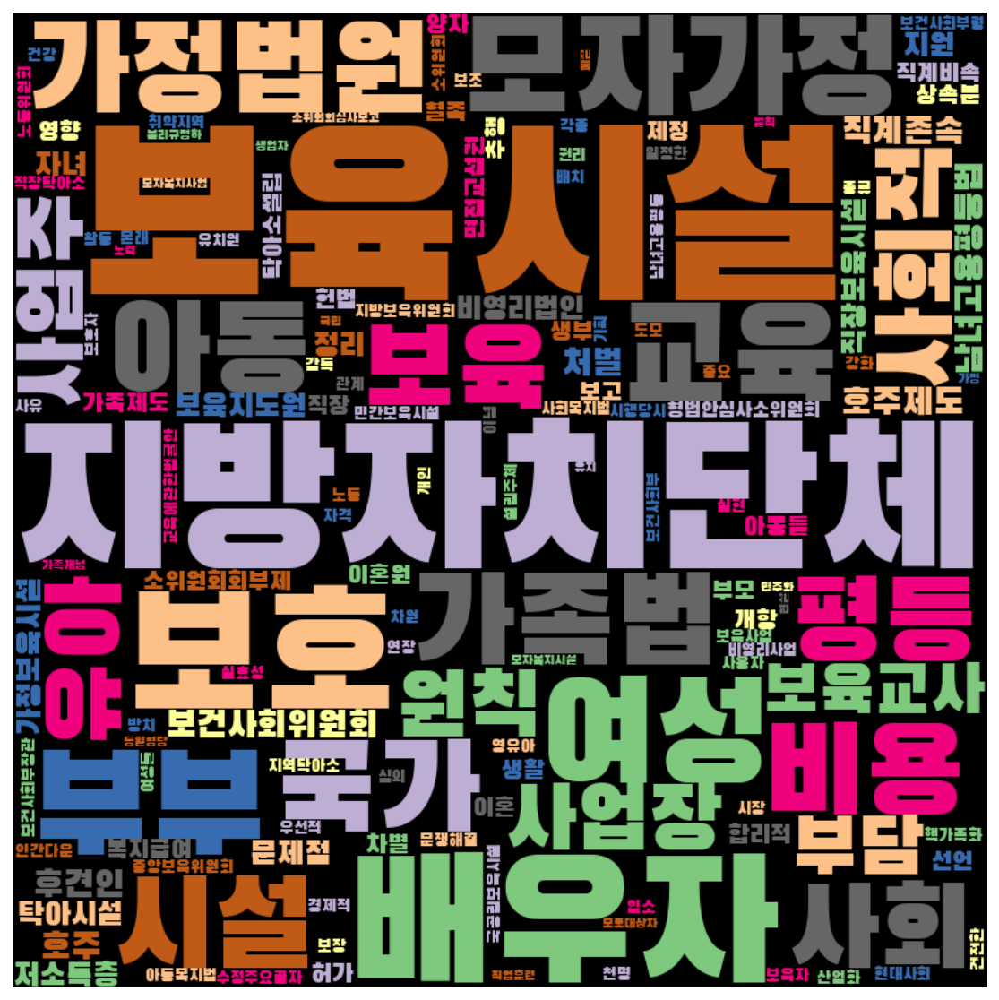

In [261]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

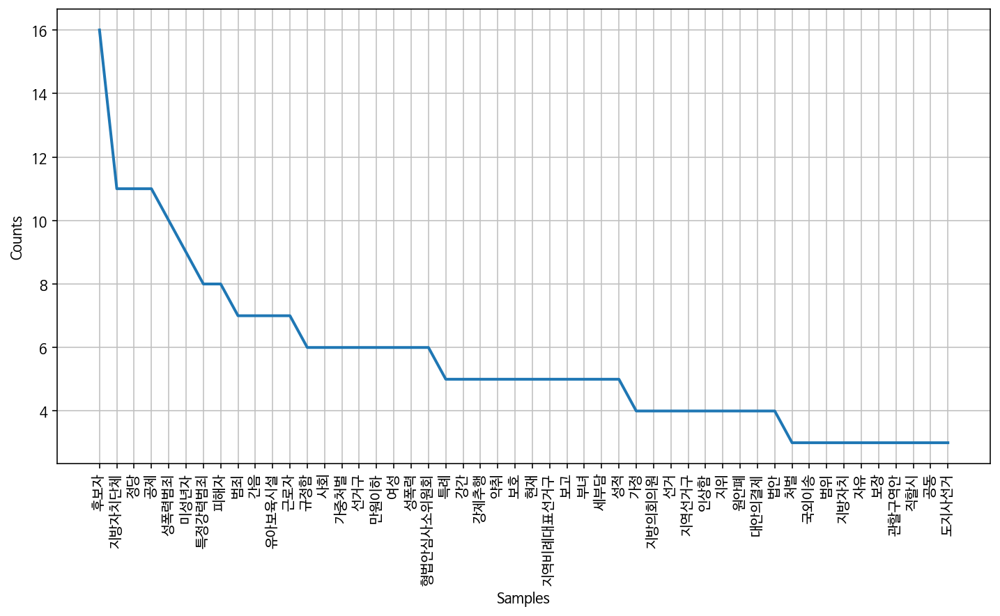

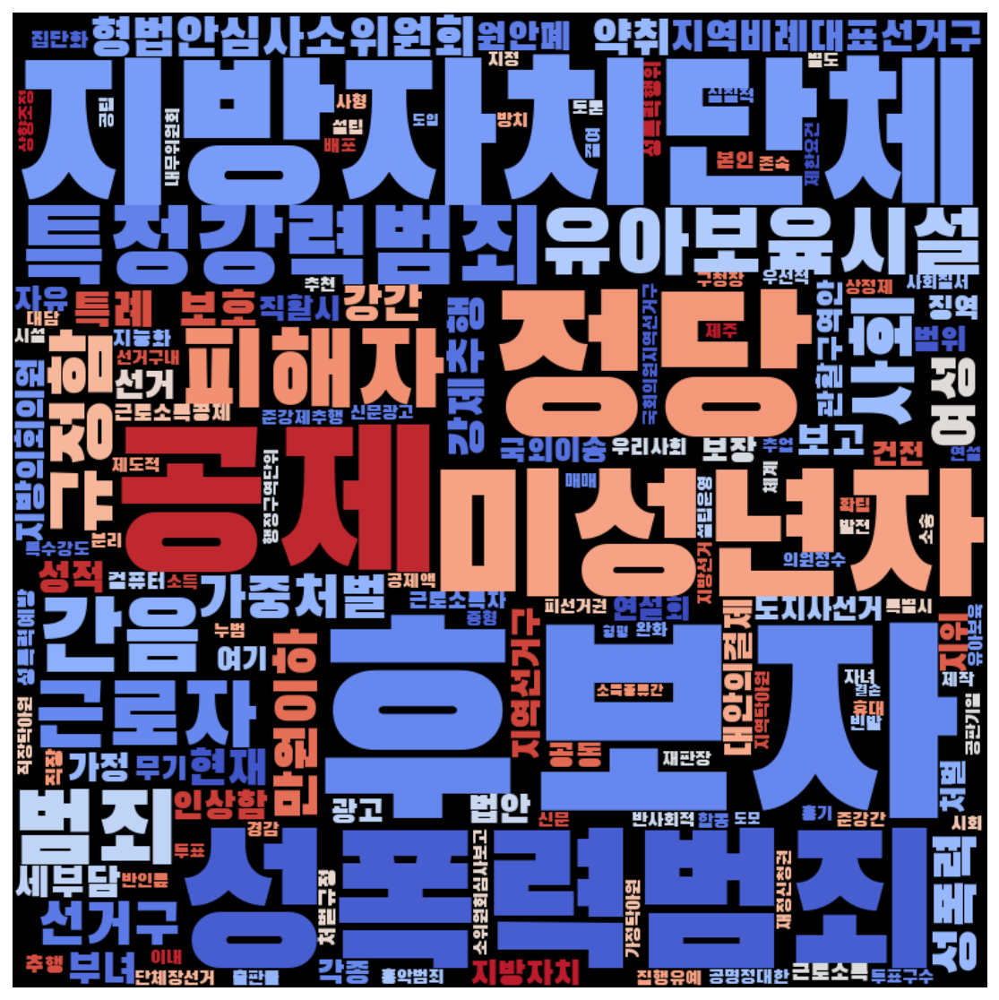

In [262]:
frewords_vis(men_word)
wordcloud_vis(men_word, 'coolwarm')

## 김영삼 정권 
- 1993.02.25 ~ 1998.02.24

In [49]:
kimyoungsam = gender[(gender['제안일자'] > datetime.date(1993,2,25)) & 
                        (gender['제안일자'] < datetime.date(1998,2,24))]
kimyoungsam.shape

(62, 19)

In [50]:
kimyoungsam['성별'].value_counts()

남성    25
여성    15
Name: 성별, dtype: int64

In [51]:
pd.DataFrame(kimyoungsam.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    9
     여성    9
진보   남성   16
     여성    6

In [52]:
women = kimyoungsam[kimyoungsam['성별'] == '여성']
men = kimyoungsam[kimyoungsam['성별'] == '남성']

In [53]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:47:23,078 : INFO : collecting all words and their counts
2020-10-20 14:47:23,080 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:47:23,082 : INFO : collected 946 word types from a corpus of 1840 raw words and 15 sentences
2020-10-20 14:47:23,084 : INFO : Loading a fresh vocabulary
2020-10-20 14:47:23,086 : INFO : effective_min_count=10 retains 17 unique words (1% of original 946, drops 929)
2020-10-20 14:47:23,088 : INFO : effective_min_count=10 leaves 269 word corpus (14% of original 1840, drops 1571)
2020-10-20 14:47:23,090 : INFO : deleting the raw counts dictionary of 946 items
2020-10-20 14:47:23,091 : INFO : sample=0.001 downsamples 17 most-common words
2020-10-20 14:47:23,092 : INFO : downsampling leaves estimated 38 word corpus (14.4% of prior 269)
2020-10-20 14:47:23,092 : INFO : estimated required memory for 17 words and 100 dimensions: 22100 bytes
2020-10-20 14:47:23,093 : INFO : resetting layer weights
2020-10-20 14:47:

2020-10-20 14:47:23,228 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,229 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,229 : INFO : EPOCH - 15 : training on 1840 raw words (43 effective words) took 0.0s, 13632 effective words/s
2020-10-20 14:47:23,233 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,234 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,235 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,236 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,236 : INFO : EPOCH - 16 : training on 1840 raw words (33 effective words) took 0.0s, 12768 effective words/s
2020-10-20 14:47:23,239 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,240 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:

2020-10-20 14:47:23,409 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,413 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,414 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,421 : INFO : EPOCH - 32 : training on 1840 raw words (37 effective words) took 0.0s, 2166 effective words/s
2020-10-20 14:47:23,429 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,430 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,431 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,433 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,435 : INFO : EPOCH - 33 : training on 1840 raw words (38 effective words) took 0.0s, 6331 effective words/s
2020-10-20 14:47:23,437 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47

2020-10-20 14:47:23,668 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,669 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,669 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,671 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,672 : INFO : EPOCH - 49 : training on 1840 raw words (37 effective words) took 0.0s, 7951 effective words/s
2020-10-20 14:47:23,675 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,677 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,679 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,680 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,687 : INFO : EPOCH - 50 : training on 1840 raw words (43 effective words) took 0.0s, 3795 effective words/s
2020-10-20 14:47

2020-10-20 14:47:23,848 : INFO : EPOCH - 65 : training on 1840 raw words (52 effective words) took 0.0s, 5594 effective words/s
2020-10-20 14:47:23,851 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,852 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,854 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,856 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:23,857 : INFO : EPOCH - 66 : training on 1840 raw words (39 effective words) took 0.0s, 6758 effective words/s
2020-10-20 14:47:23,859 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:23,861 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:23,862 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:23,863 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47

2020-10-20 14:47:24,030 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,031 : INFO : EPOCH - 82 : training on 1840 raw words (43 effective words) took 0.0s, 10829 effective words/s
2020-10-20 14:47:24,038 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,040 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,041 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,043 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,045 : INFO : EPOCH - 83 : training on 1840 raw words (37 effective words) took 0.0s, 5635 effective words/s
2020-10-20 14:47:24,051 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,055 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,058 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:4

2020-10-20 14:47:24,216 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,218 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,221 : INFO : EPOCH - 99 : training on 1840 raw words (32 effective words) took 0.0s, 1752 effective words/s
2020-10-20 14:47:24,225 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,227 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,230 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,232 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,234 : INFO : EPOCH - 100 : training on 1840 raw words (37 effective words) took 0.0s, 4195 effective words/s
2020-10-20 14:47:24,236 : INFO : training on a 184000 raw words (3902 effective words) took 1.1s, 3449 effective words/s
2020-10-20 14:47:24,238 : INFO : collecting all words and their counts
2020-

2020-10-20 14:47:24,388 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,390 : INFO : EPOCH - 13 : training on 2844 raw words (54 effective words) took 0.0s, 6750 effective words/s
2020-10-20 14:47:24,394 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,397 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,398 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,401 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,403 : INFO : EPOCH - 14 : training on 2844 raw words (58 effective words) took 0.0s, 5847 effective words/s
2020-10-20 14:47:24,408 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,409 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,411 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47

2020-10-20 14:47:24,556 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,558 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,559 : INFO : EPOCH - 30 : training on 2844 raw words (55 effective words) took 0.0s, 7297 effective words/s
2020-10-20 14:47:24,564 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,566 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,567 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,568 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,570 : INFO : EPOCH - 31 : training on 2844 raw words (53 effective words) took 0.0s, 9053 effective words/s
2020-10-20 14:47:24,575 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,577 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47

2020-10-20 14:47:24,853 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,855 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,856 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,858 : INFO : EPOCH - 47 : training on 2844 raw words (51 effective words) took 0.0s, 6848 effective words/s
2020-10-20 14:47:24,861 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:24,862 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:24,864 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:24,865 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:24,867 : INFO : EPOCH - 48 : training on 2844 raw words (49 effective words) took 0.0s, 8939 effective words/s
2020-10-20 14:47:24,870 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47

2020-10-20 14:47:25,032 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:25,034 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:25,035 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:25,036 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:25,038 : INFO : EPOCH - 64 : training on 2844 raw words (54 effective words) took 0.0s, 10238 effective words/s
2020-10-20 14:47:25,041 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:25,042 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:25,044 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:25,046 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:25,047 : INFO : EPOCH - 65 : training on 2844 raw words (49 effective words) took 0.0s, 7918 effective words/s
2020-10-20 14:4

2020-10-20 14:47:25,197 : INFO : EPOCH - 80 : training on 2844 raw words (44 effective words) took 0.0s, 8096 effective words/s
2020-10-20 14:47:25,200 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:25,202 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:25,202 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:25,205 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:25,206 : INFO : EPOCH - 81 : training on 2844 raw words (60 effective words) took 0.0s, 10275 effective words/s
2020-10-20 14:47:25,209 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:25,210 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:25,211 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:25,212 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:4

2020-10-20 14:47:25,464 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:25,465 : INFO : EPOCH - 97 : training on 2844 raw words (63 effective words) took 0.0s, 10967 effective words/s
2020-10-20 14:47:25,474 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:25,475 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:25,476 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:25,477 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:25,479 : INFO : EPOCH - 98 : training on 2844 raw words (53 effective words) took 0.0s, 6427 effective words/s
2020-10-20 14:47:25,488 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:25,490 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:25,491 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:4

In [54]:
#print(model_women.wv.most_similar('부녀자'))
#print(model_women.wv.most_similar('여자'))
print(model_women.wv.most_similar('여성'))

2020-10-20 14:47:25,513 : INFO : precomputing L2-norms of word weight vectors


[('위반', 0.996229887008667), ('신설', 0.9961315989494324), ('직장내', 0.9956104159355164), ('근로자', 0.9875710010528564), ('차별', 0.9830042719841003), ('규정함', 0.9438737630844116), ('지방자치단체', 0.9276500940322876), ('처벌', 0.8877902030944824), ('예방', 0.8866255283355713), ('가정', 0.8516836166381836)]


In [55]:
#print(model_men.wv.most_similar('부녀자'))
#print(model_men.wv.most_similar('여자'))
print(model_men.wv.most_similar('여성'))

2020-10-20 14:47:25,528 : INFO : precomputing L2-norms of word weight vectors


[('추진', 0.9801953434944153), ('강화', 0.9477157592773438), ('지원', 0.9295043349266052), ('기능', 0.9290119409561157), ('도모', 0.9208499193191528), ('지방자치단체', 0.8993468284606934), ('범위', 0.8953198194503784), ('국가', 0.8779966831207275), ('퇴직', 0.8506755828857422), ('개편', 0.8358843326568604)]


In [56]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [57]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

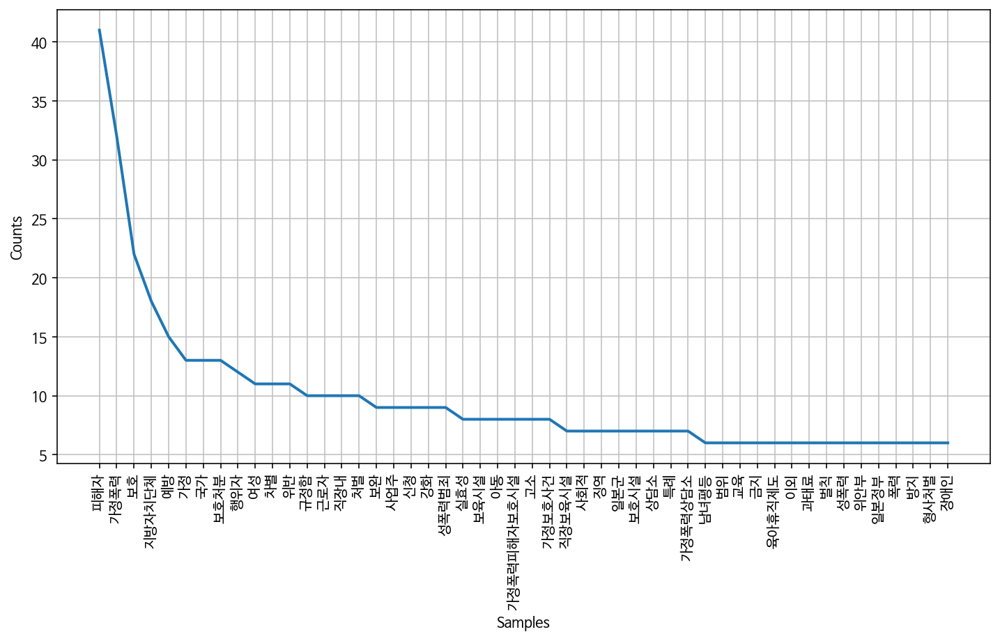

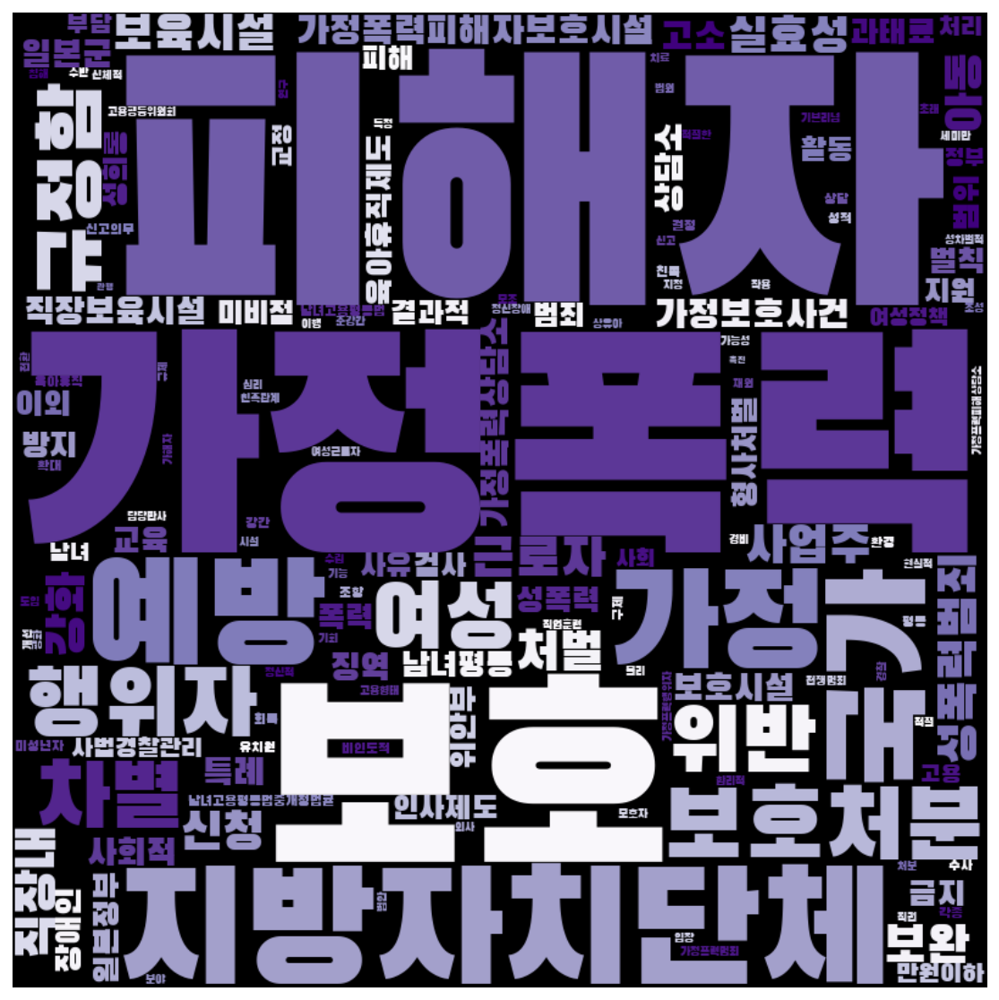

In [58]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

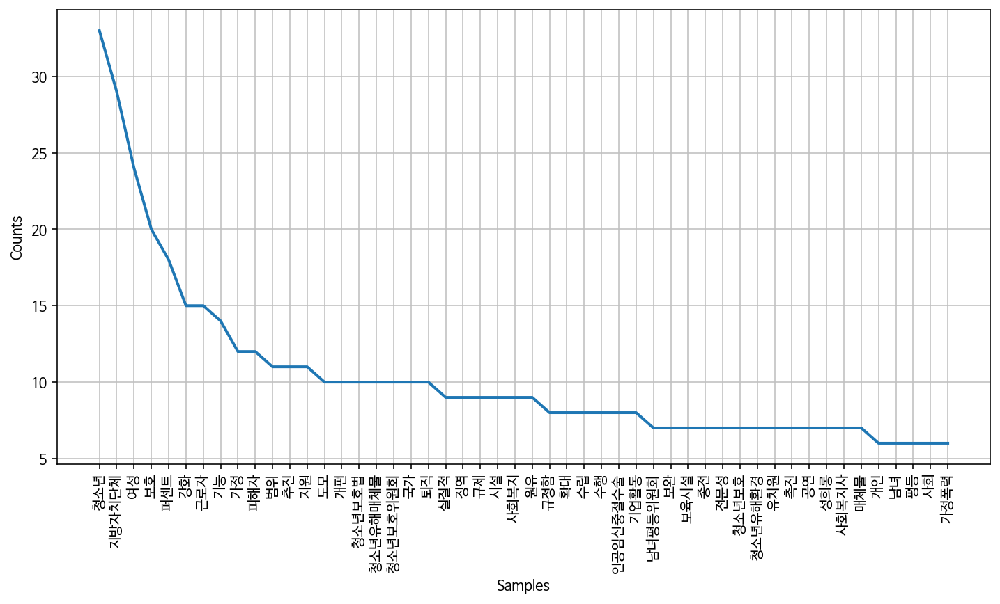

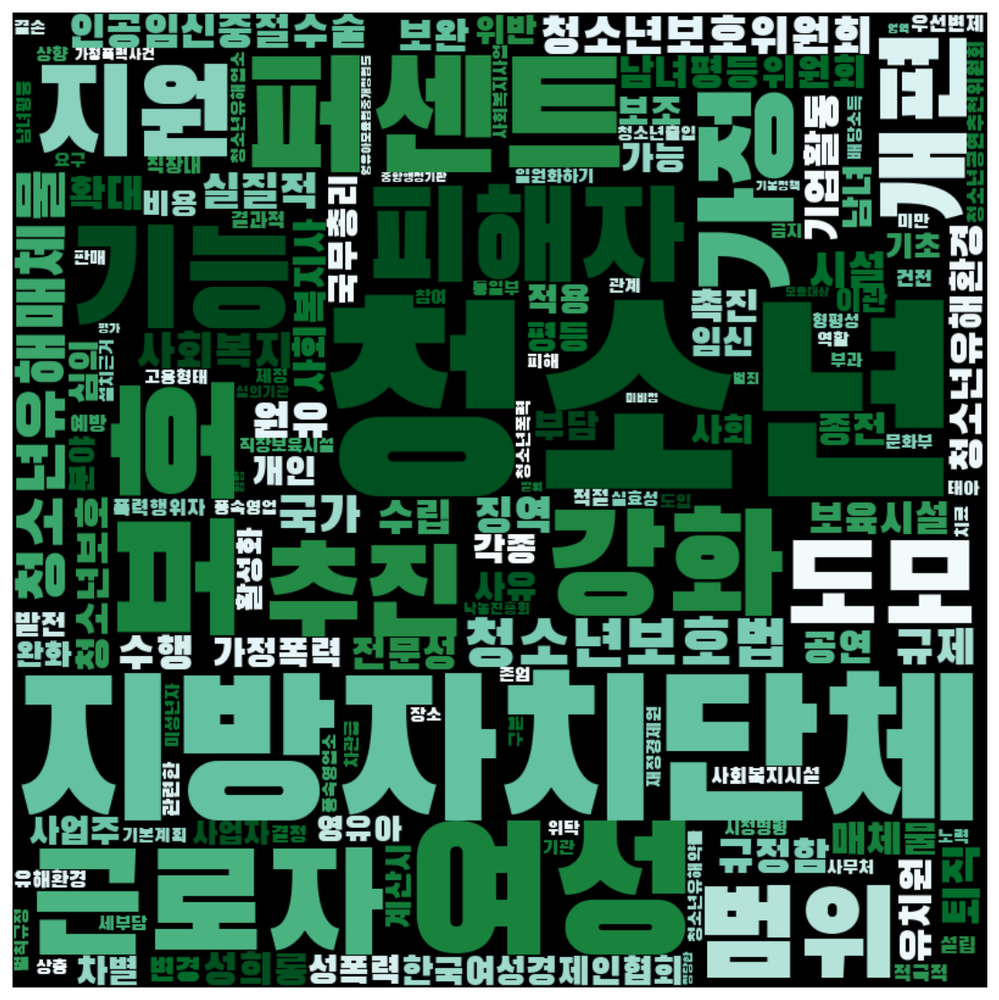

In [59]:
frewords_vis(men_word)
wordcloud_vis(men_word, 'coolwarm')

## 김대중 정권 
- 1998.02.25 ~ 2003.02.24

In [60]:
kimdaejoong = gender[(gender['제안일자'] > datetime.date(1998,2,25)) & 
                        (gender['제안일자'] < datetime.date(2003,2,24))]
kimdaejoong.shape

(92, 19)

In [61]:
kimdaejoong['성별'].value_counts()

남성    31
여성    23
Name: 성별, dtype: int64

In [62]:
pd.DataFrame(kimdaejoong.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   22
     여성   16
진보   남성    7
     여성    7

In [63]:
women = kimdaejoong[kimdaejoong['성별'] == '여성']
men = kimdaejoong[kimdaejoong['성별'] == '남성']

In [64]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:47:56,994 : INFO : collecting all words and their counts
2020-10-20 14:47:56,995 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:47:56,997 : INFO : collected 1061 word types from a corpus of 2157 raw words and 23 sentences
2020-10-20 14:47:56,999 : INFO : Loading a fresh vocabulary
2020-10-20 14:47:57,001 : INFO : effective_min_count=10 retains 19 unique words (1% of original 1061, drops 1042)
2020-10-20 14:47:57,002 : INFO : effective_min_count=10 leaves 312 word corpus (14% of original 2157, drops 1845)
2020-10-20 14:47:57,003 : INFO : deleting the raw counts dictionary of 1061 items
2020-10-20 14:47:57,004 : INFO : sample=0.001 downsamples 19 most-common words
2020-10-20 14:47:57,006 : INFO : downsampling leaves estimated 48 word corpus (15.4% of prior 312)
2020-10-20 14:47:57,007 : INFO : estimated required memory for 19 words and 100 dimensions: 24700 bytes
2020-10-20 14:47:57,008 : INFO : resetting layer weights
2020-10-20 14

2020-10-20 14:47:57,128 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,129 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,130 : INFO : EPOCH - 15 : training on 2157 raw words (40 effective words) took 0.0s, 10443 effective words/s
2020-10-20 14:47:57,134 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,135 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,136 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,137 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,137 : INFO : EPOCH - 16 : training on 2157 raw words (44 effective words) took 0.0s, 12210 effective words/s
2020-10-20 14:47:57,141 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,142 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:

2020-10-20 14:47:57,315 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,318 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,319 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,321 : INFO : EPOCH - 32 : training on 2157 raw words (47 effective words) took 0.0s, 5479 effective words/s
2020-10-20 14:47:57,325 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,328 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,331 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,334 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,335 : INFO : EPOCH - 33 : training on 2157 raw words (54 effective words) took 0.0s, 5377 effective words/s
2020-10-20 14:47:57,338 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47

2020-10-20 14:47:57,528 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,529 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,530 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,531 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,533 : INFO : EPOCH - 49 : training on 2157 raw words (49 effective words) took 0.0s, 8112 effective words/s
2020-10-20 14:47:57,539 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,541 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,543 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,545 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,547 : INFO : EPOCH - 50 : training on 2157 raw words (38 effective words) took 0.0s, 4249 effective words/s
2020-10-20 14:47

2020-10-20 14:47:57,702 : INFO : EPOCH - 65 : training on 2157 raw words (41 effective words) took 0.0s, 7937 effective words/s
2020-10-20 14:47:57,705 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,706 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,707 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,708 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,708 : INFO : EPOCH - 66 : training on 2157 raw words (57 effective words) took 0.0s, 15495 effective words/s
2020-10-20 14:47:57,711 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,712 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,714 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,715 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:4

2020-10-20 14:47:57,856 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,857 : INFO : EPOCH - 82 : training on 2157 raw words (64 effective words) took 0.0s, 14789 effective words/s
2020-10-20 14:47:57,859 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,861 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,863 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:57,864 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:57,865 : INFO : EPOCH - 83 : training on 2157 raw words (39 effective words) took 0.0s, 6890 effective words/s
2020-10-20 14:47:57,869 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:57,870 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:57,871 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:4

2020-10-20 14:47:58,020 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,022 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,023 : INFO : EPOCH - 99 : training on 2157 raw words (46 effective words) took 0.0s, 4664 effective words/s
2020-10-20 14:47:58,027 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,030 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,033 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,035 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,037 : INFO : EPOCH - 100 : training on 2157 raw words (50 effective words) took 0.0s, 5028 effective words/s
2020-10-20 14:47:58,039 : INFO : training on a 215700 raw words (4724 effective words) took 1.0s, 4625 effective words/s
2020-10-20 14:47:58,042 : INFO : collecting all words and their counts
2020-

2020-10-20 14:47:58,205 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,205 : INFO : EPOCH - 13 : training on 3823 raw words (163 effective words) took 0.0s, 22290 effective words/s
2020-10-20 14:47:58,210 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,213 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,217 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,220 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,226 : INFO : EPOCH - 14 : training on 3823 raw words (167 effective words) took 0.0s, 9509 effective words/s
2020-10-20 14:47:58,232 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,233 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,234 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14

2020-10-20 14:47:58,391 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,392 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,394 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,395 : INFO : EPOCH - 30 : training on 3823 raw words (157 effective words) took 0.0s, 32272 effective words/s
2020-10-20 14:47:58,399 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,400 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,400 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,401 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,402 : INFO : EPOCH - 31 : training on 3823 raw words (134 effective words) took 0.0s, 36235 effective words/s
2020-10-20 14:47:58,407 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 1

2020-10-20 14:47:58,648 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,650 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,651 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,653 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,654 : INFO : EPOCH - 47 : training on 3823 raw words (158 effective words) took 0.0s, 24096 effective words/s
2020-10-20 14:47:58,660 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,664 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,667 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,669 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,671 : INFO : EPOCH - 48 : training on 3823 raw words (162 effective words) took 0.0s, 14359 effective words/s
2020-10-20 1

2020-10-20 14:47:58,822 : INFO : EPOCH - 63 : training on 3823 raw words (169 effective words) took 0.0s, 15640 effective words/s
2020-10-20 14:47:58,826 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,829 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,831 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,833 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:58,834 : INFO : EPOCH - 64 : training on 3823 raw words (137 effective words) took 0.0s, 16907 effective words/s
2020-10-20 14:47:58,838 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:58,840 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:58,841 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:58,842 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 1

2020-10-20 14:47:59,001 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:59,002 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:59,004 : INFO : EPOCH - 80 : training on 3823 raw words (147 effective words) took 0.0s, 19382 effective words/s
2020-10-20 14:47:59,014 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:59,017 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:59,017 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:59,019 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:59,021 : INFO : EPOCH - 81 : training on 3823 raw words (154 effective words) took 0.0s, 16296 effective words/s
2020-10-20 14:47:59,024 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:59,026 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 1

2020-10-20 14:47:59,300 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:59,303 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:59,305 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:59,307 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:59,308 : INFO : EPOCH - 97 : training on 3823 raw words (164 effective words) took 0.0s, 19112 effective words/s
2020-10-20 14:47:59,315 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:47:59,316 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:47:59,320 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:47:59,322 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:47:59,324 : INFO : EPOCH - 98 : training on 3823 raw words (152 effective words) took 0.0s, 15985 effective words/s
2020-10-20 1

In [65]:
#print(model_women.wv.most_similar('부녀자'))
#print(model_women.wv.most_similar('여자'))
print(model_women.wv.most_similar('여성'))

2020-10-20 14:47:59,392 : INFO : precomputing L2-norms of word weight vectors


[('지급', 0.9981222152709961), ('강화', 0.9913583993911743), ('육아휴직', 0.9383410811424255), ('신설', 0.9237974882125854), ('휴직기간', 0.9172959327697754), ('근로자', 0.9110305905342102), ('알선', 0.90169757604599), ('휴직', 0.8987417817115784), ('대상', 0.8971198797225952), ('범죄', 0.8937870860099792)]


In [66]:
#print(model_men.wv.most_similar('부녀자'))
#print(model_men.wv.most_similar('여자'))
print(model_men.wv.most_similar('여성'))

2020-10-20 14:47:59,436 : INFO : precomputing L2-norms of word weight vectors


[('정당', 0.9141327142715454), ('추천', 0.9037448763847351), ('공직선거후보자', 0.8990353941917419), ('선출', 0.8870104551315308), ('신설', 0.7885251045227051), ('개선', 0.716322660446167), ('수립', 0.6465904116630554), ('근로자', 0.637304425239563), ('국민년', 0.6298764944076538), ('확대', 0.6197993159294128)]


In [67]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [68]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

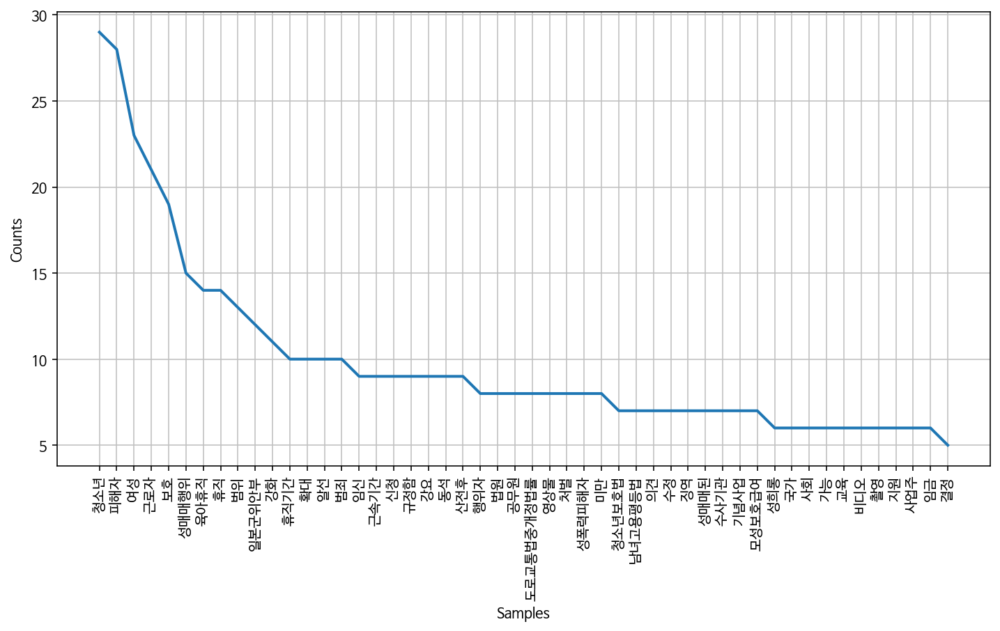

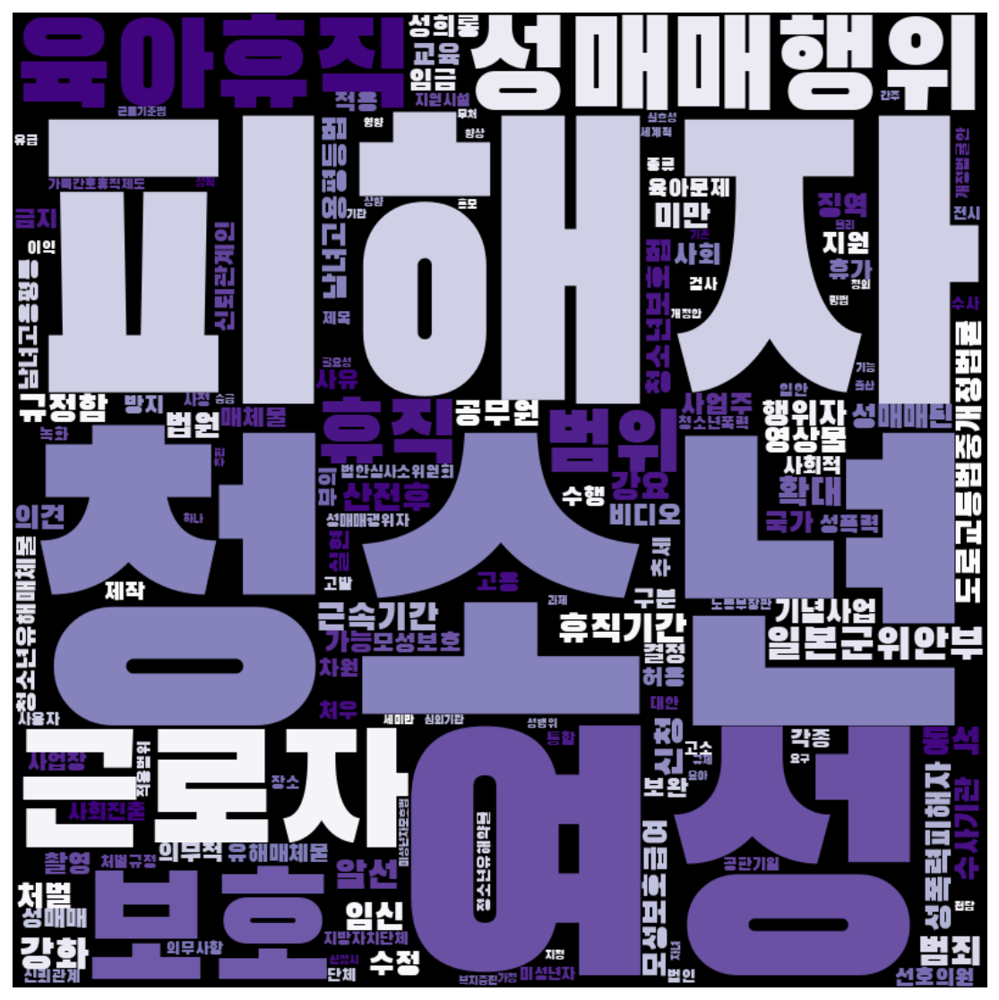

In [69]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

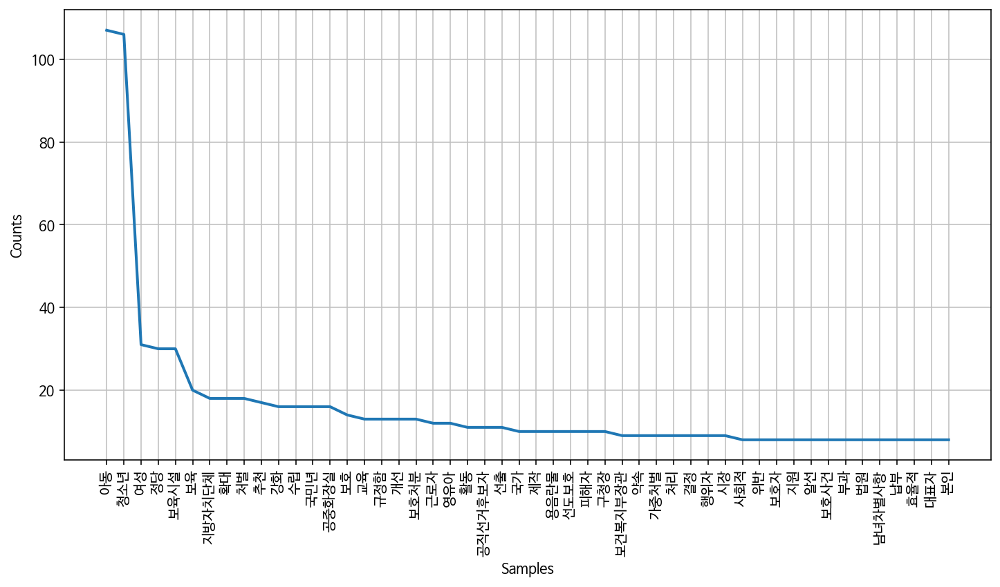

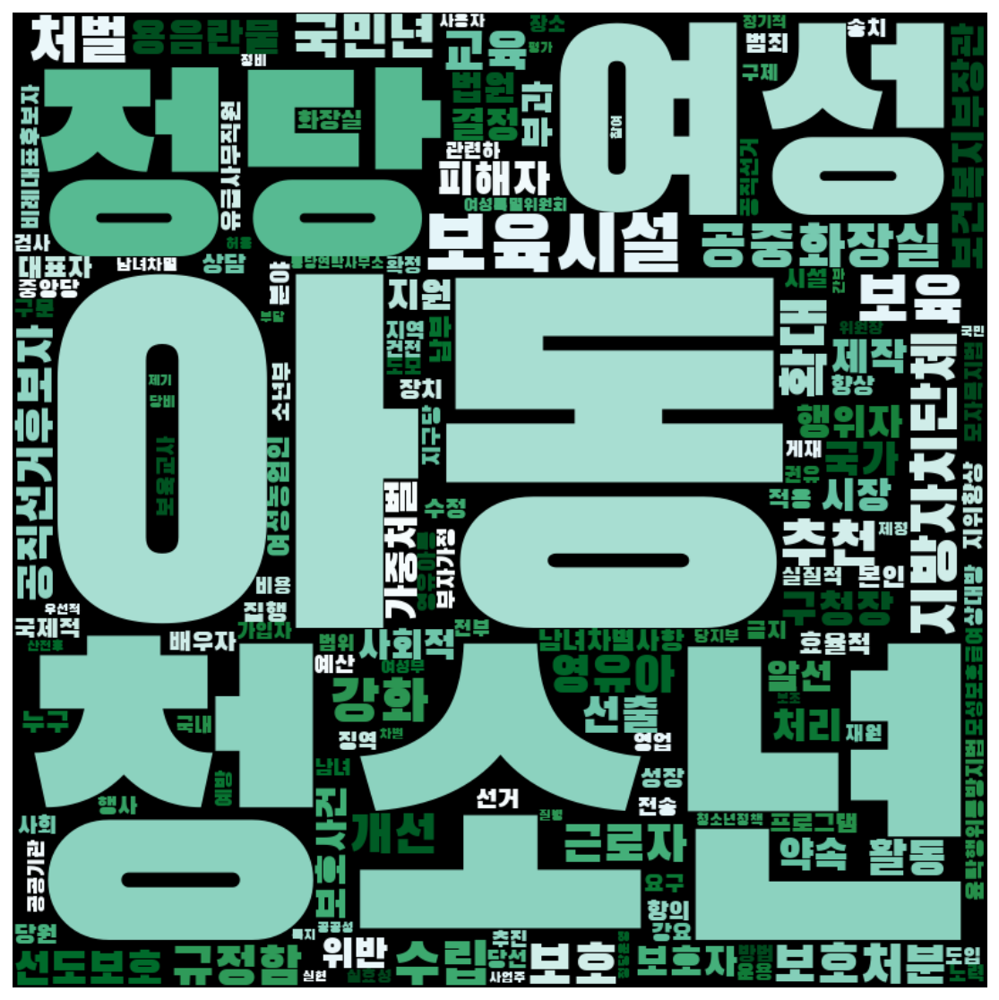

In [70]:
frewords_vis(men_word)
wordcloud_vis(men_word, 'coolwarm')

## 노무현 정권  
- 2003.02.25 ~ 2004.04.14

In [71]:
romoohyun = gender[(gender['제안일자'] > datetime.date(2003,2,25)) & 
                        (gender['제안일자'] < datetime.date(2008,2,24))]
romoohyun.shape

(447, 19)

In [72]:
romoohyun['성별'].value_counts()

여성    182
남성    165
Name: 성별, dtype: int64

In [73]:
pd.DataFrame(romoohyun.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   86
     여성   97
진보   남성   77
     여성   85

In [74]:
women = romoohyun[romoohyun['성별'] == '여성']
men = romoohyun[romoohyun['성별'] == '남성']

In [75]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:48:26,728 : INFO : collecting all words and their counts
2020-10-20 14:48:26,730 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:48:26,736 : INFO : collected 3930 word types from a corpus of 14955 raw words and 182 sentences
2020-10-20 14:48:26,737 : INFO : Loading a fresh vocabulary
2020-10-20 14:48:26,741 : INFO : effective_min_count=10 retains 308 unique words (7% of original 3930, drops 3622)
2020-10-20 14:48:26,742 : INFO : effective_min_count=10 leaves 7002 word corpus (46% of original 14955, drops 7953)
2020-10-20 14:48:26,745 : INFO : deleting the raw counts dictionary of 3930 items
2020-10-20 14:48:26,746 : INFO : sample=0.001 downsamples 113 most-common words
2020-10-20 14:48:26,747 : INFO : downsampling leaves estimated 5135 word corpus (73.3% of prior 7002)
2020-10-20 14:48:26,749 : INFO : estimated required memory for 308 words and 100 dimensions: 400400 bytes
2020-10-20 14:48:26,751 : INFO : resetting layer weights
20

2020-10-20 14:48:27,353 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:27,360 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:27,362 : INFO : EPOCH - 15 : training on 14955 raw words (5138 effective words) took 0.0s, 185635 effective words/s
2020-10-20 14:48:27,367 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:27,371 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:27,385 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:27,398 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:27,399 : INFO : EPOCH - 16 : training on 14955 raw words (5140 effective words) took 0.0s, 154445 effective words/s
2020-10-20 14:48:27,406 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:27,411 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 14:48:27,935 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:27,942 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:27,954 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:27,965 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:27,966 : INFO : EPOCH - 32 : training on 14955 raw words (5153 effective words) took 0.0s, 151462 effective words/s
2020-10-20 14:48:27,972 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:27,978 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:27,992 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:28,001 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:28,002 : INFO : EPOCH - 33 : training on 14955 raw words (5141 effective words) took 0.0s, 168768 effective words/s
2020-1

2020-10-20 14:48:28,524 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:28,525 : INFO : EPOCH - 48 : training on 14955 raw words (5142 effective words) took 0.0s, 155055 effective words/s
2020-10-20 14:48:28,533 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:28,538 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:28,550 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:28,560 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:28,563 : INFO : EPOCH - 49 : training on 14955 raw words (5143 effective words) took 0.0s, 151825 effective words/s
2020-10-20 14:48:28,569 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:28,573 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:28,588 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-20 14:48:29,091 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:29,104 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:29,114 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:29,118 : INFO : EPOCH - 65 : training on 14955 raw words (5160 effective words) took 0.0s, 176369 effective words/s
2020-10-20 14:48:29,127 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:29,129 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:29,144 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:29,151 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:29,151 : INFO : EPOCH - 66 : training on 14955 raw words (5142 effective words) took 0.0s, 180293 effective words/s
2020-10-20 14:48:29,162 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-20 14:48:29,667 : INFO : EPOCH - 81 : training on 14955 raw words (5118 effective words) took 0.0s, 183330 effective words/s
2020-10-20 14:48:29,674 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:29,678 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:29,690 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:29,699 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:29,699 : INFO : EPOCH - 82 : training on 14955 raw words (5154 effective words) took 0.0s, 176761 effective words/s
2020-10-20 14:48:29,709 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:29,718 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:29,720 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:29,731 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-20 14:48:30,208 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:30,215 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:30,216 : INFO : EPOCH - 98 : training on 14955 raw words (5143 effective words) took 0.0s, 163375 effective words/s
2020-10-20 14:48:30,224 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:30,240 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:30,248 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:30,250 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:30,252 : INFO : EPOCH - 99 : training on 14955 raw words (5128 effective words) took 0.0s, 160041 effective words/s
2020-10-20 14:48:30,266 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:30,271 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 14:48:30,787 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:30,791 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:30,792 : INFO : EPOCH - 12 : training on 15827 raw words (4850 effective words) took 0.0s, 191991 effective words/s
2020-10-20 14:48:30,799 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:30,802 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:30,816 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:30,823 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:30,824 : INFO : EPOCH - 13 : training on 15827 raw words (4900 effective words) took 0.0s, 178568 effective words/s
2020-10-20 14:48:30,828 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:30,834 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 14:48:31,324 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:31,330 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:31,340 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:31,349 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:31,350 : INFO : EPOCH - 29 : training on 15827 raw words (4874 effective words) took 0.0s, 170124 effective words/s
2020-10-20 14:48:31,361 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:31,365 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:31,376 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:31,383 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:31,385 : INFO : EPOCH - 30 : training on 15827 raw words (4871 effective words) took 0.0s, 169311 effective words/s
2020-1

2020-10-20 14:48:31,863 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:31,869 : INFO : EPOCH - 45 : training on 15827 raw words (4873 effective words) took 0.0s, 148422 effective words/s
2020-10-20 14:48:31,874 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:31,883 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:31,897 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:31,899 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:31,899 : INFO : EPOCH - 46 : training on 15827 raw words (4891 effective words) took 0.0s, 193265 effective words/s
2020-10-20 14:48:31,905 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:31,908 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:31,922 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-20 14:48:32,421 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:32,433 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:32,434 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:32,435 : INFO : EPOCH - 62 : training on 15827 raw words (4867 effective words) took 0.0s, 221645 effective words/s
2020-10-20 14:48:32,440 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:32,450 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:32,457 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:32,469 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:32,470 : INFO : EPOCH - 63 : training on 15827 raw words (4846 effective words) took 0.0s, 152192 effective words/s
2020-10-20 14:48:32,476 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-20 14:48:32,935 : INFO : EPOCH - 78 : training on 15827 raw words (4826 effective words) took 0.0s, 181064 effective words/s
2020-10-20 14:48:32,944 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:32,945 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:32,964 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:32,965 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:32,966 : INFO : EPOCH - 79 : training on 15827 raw words (4808 effective words) took 0.0s, 206740 effective words/s
2020-10-20 14:48:32,974 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:32,975 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:32,988 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:32,997 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-20 14:48:33,466 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:33,472 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:33,473 : INFO : EPOCH - 95 : training on 15827 raw words (4885 effective words) took 0.0s, 182513 effective words/s
2020-10-20 14:48:33,484 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:33,486 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:48:33,503 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:48:33,503 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:48:33,504 : INFO : EPOCH - 96 : training on 15827 raw words (4854 effective words) took 0.0s, 176095 effective words/s
2020-10-20 14:48:33,510 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:48:33,516 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

In [76]:
print(model_women.wv.most_similar('여성'))

2020-10-20 14:48:33,648 : INFO : precomputing L2-norms of word weight vectors


[('남성', 0.46089431643486023), ('참여', 0.3749340772628784), ('향상', 0.37145519256591797), ('후보', 0.36683475971221924), ('수준', 0.36162686347961426), ('확대', 0.3421269655227661), ('기존', 0.30536288022994995), ('모성보호', 0.2999345660209656), ('위생용품', 0.2942485809326172), ('정당', 0.28839394450187683)]


In [77]:
print(model_men.wv.most_similar('여성'))

2020-10-20 14:48:33,661 : INFO : precomputing L2-norms of word weight vectors


[('남성', 0.498141884803772), ('보장', 0.39433592557907104), ('주요', 0.3839572072029114), ('여성근로자', 0.3823705315589905), ('합리적', 0.3529103100299835), ('현실적', 0.34030479192733765), ('유족연금', 0.33656153082847595), ('출산', 0.33325356245040894), ('국가공무원법', 0.33041030168533325), ('육아휴직', 0.3301980793476105)]


In [78]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [79]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

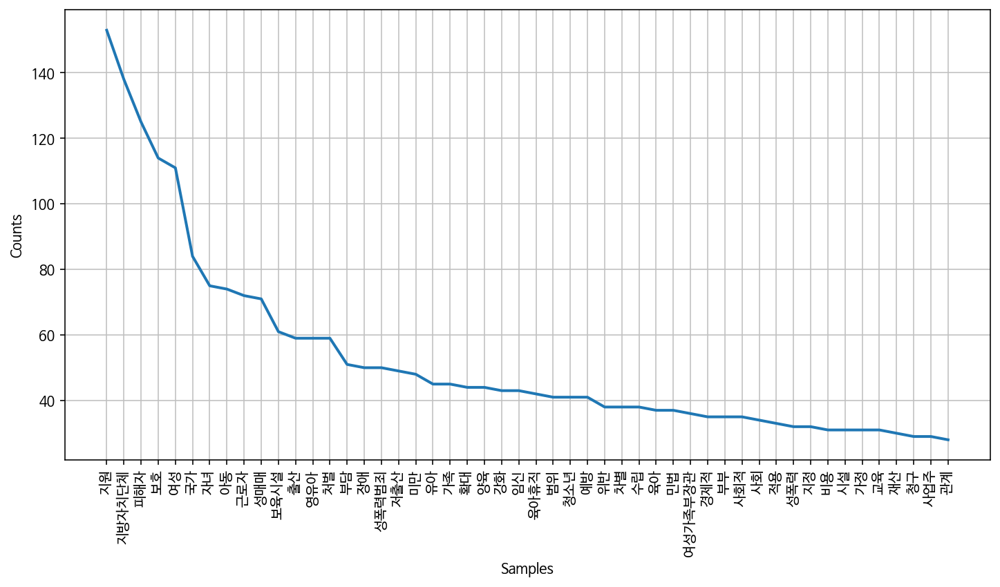

ValueError: ' Purples' is not a valid value for name; supported values are 'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r'

In [80]:
frewords_vis(women_word)
wordcloud_vis(women_word,' Accent')

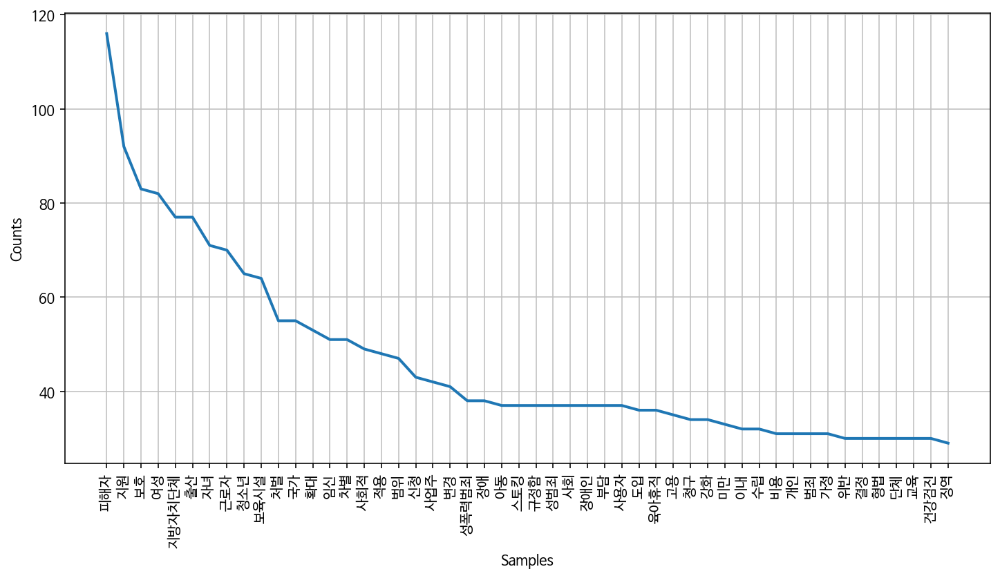

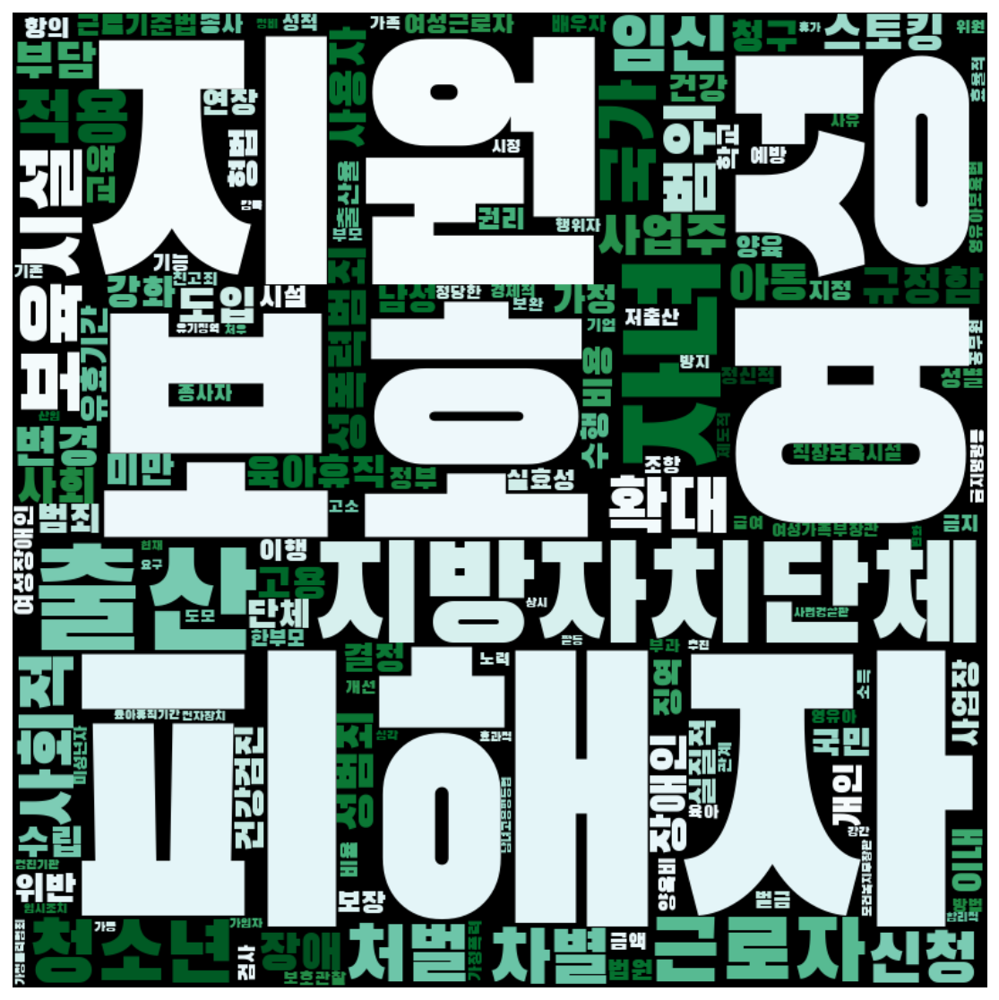

In [81]:
frewords_vis(men_word)
wordcloud_vis(men_word,'coolwarm')

In [82]:
# 문장 벡터 생성
def get_sentence_mean_vector(morphs, model):
    vector = []
    for i in morphs:
        try:
            vector.append(model.wv[i])
        except:
            pass
    try:
        return np.mean(vector, axis=0)
    except:
        pass
    
# 엘보우 함수
def elbow(X):
    sse = []
    for i in tqdm(range(1,15), desc = '엘보우'):
        km = KMeans(init='k-means++', n_clusters = i, random_state=0)
        km.fit(X)
        sse.append(km.inertia_)
        
    plt.plot(range(1,15), sse, marker='o')
    plt.xlabel("number of cluster")
    plt.ylabel("SSE")
    plt.show()

In [83]:
women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))

<ipython-input-83-87b19f55aed6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
<ipython-input-83-87b19f55aed6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))


엘보우: 100%|██████████| 14/14 [00:00<00:00, 17.62it/s]


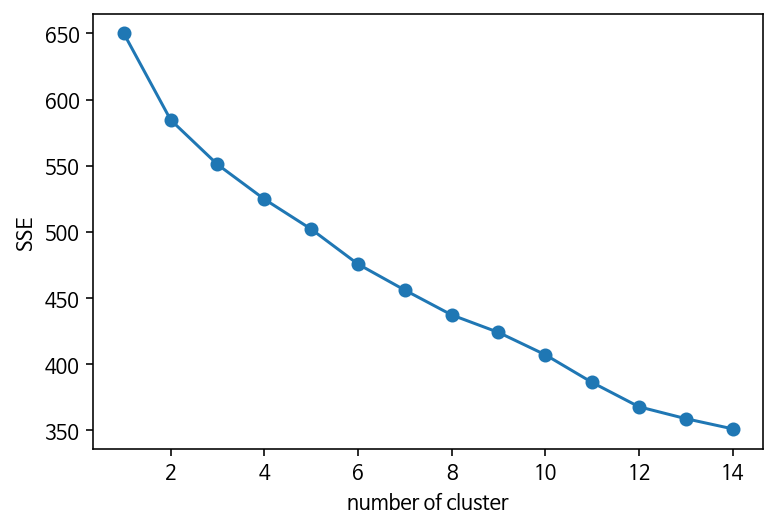

In [84]:
word_vectors_women = women['문장벡터'].to_list() # 함수에 넣을 X값 지정
elbow(word_vectors_women)

In [85]:
from sklearn.metrics import silhouette_samples
from sklearn.datasets import make_blobs
from matplotlib import cm

def plotSilhouette(X, y_km):
    cluster_labels = np.unique(y_km)
    n_clusters = cluster_labels.shape[0]
    silhouette_vals = silhouette_samples(X, y_km, metric = 'euclidean')
    y_ax_lower, y_ax_upper = 0, 0
    yticks = []

    for i, c in enumerate(cluster_labels):
        c_silhouette_vals = silhouette_vals[y_km == c]
        c_silhouette_vals.sort()
        y_ax_upper += len(c_silhouette_vals)
        color = cm.jet(i/n_clusters)

        plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0,
                edgecolor='none', color=color)
        yticks.append((y_ax_lower + y_ax_upper)/2)
        y_ax_lower += len(c_silhouette_vals)

    silhoutte_avg = np.mean(silhouette_vals)
    plt.axvline(silhoutte_avg, color = 'red', linestyle='--')
    plt.yticks(yticks, cluster_labels+1)
    plt.ylabel('K')
    plt.xlabel('silhouette')
    plt.show()

/usr/local/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


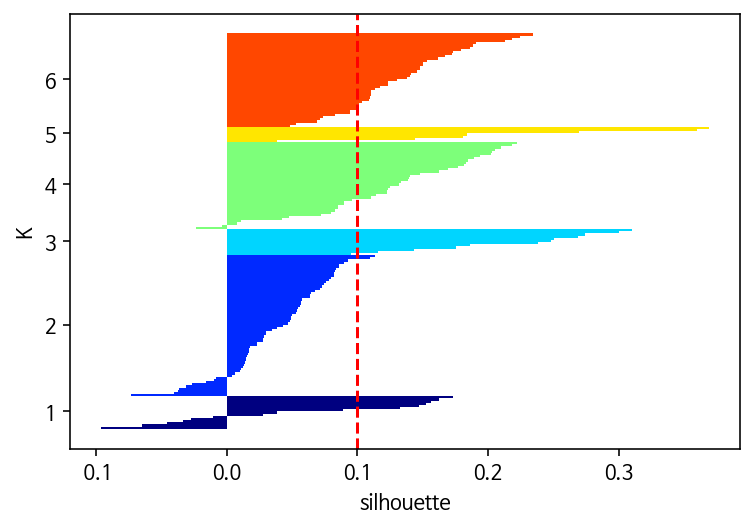

In [86]:
word_vectors_women = women['문장벡터'].to_list()
k= 6

X, y = make_blobs(n_samples=150, n_features=2, centers=3, cluster_std=0.5,
                  shuffle=True, random_state=0)
km = KMeans(n_clusters=k, algorithm='auto', random_state=42)
y_km = km.fit_predict(word_vectors_women)
plotSilhouette(word_vectors_women, y_km)

In [87]:
# K means 수행 
word_vectors_women = women['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_women)
women['category'] = idx

<ipython-input-87-758a1e279dd2>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['category'] = idx


In [88]:
women['category'].value_counts()

0    67
2    46
1    25
4    24
5    16
3     4
Name: category, dtype: int64

In [89]:
women_g1 = women[women['category'] == 0]
women_g2 = women[women['category'] == 1]
women_g3 = women[women['category'] == 2]
women_g4 = women[women['category'] == 3]
women_g5 = women[women['category'] == 4]
women_g6 = women[women['category'] == 5]

In [90]:
women_g1_tokens = total_tokens(women_g1['tokens'])
women_g2_tokens = total_tokens(women_g2['tokens'])
women_g3_tokens = total_tokens(women_g3['tokens'])
women_g4_tokens = total_tokens(women_g4['tokens'])
women_g5_tokens = total_tokens(women_g5['tokens'])
women_g6_tokens = total_tokens(women_g6['tokens'])

In [91]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
women_g1_tokens = [each_word for each_word in women_g1_tokens if each_word not in stopwords]
women_g2_tokens = [each_word for each_word in women_g2_tokens if each_word not in stopwords]
women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

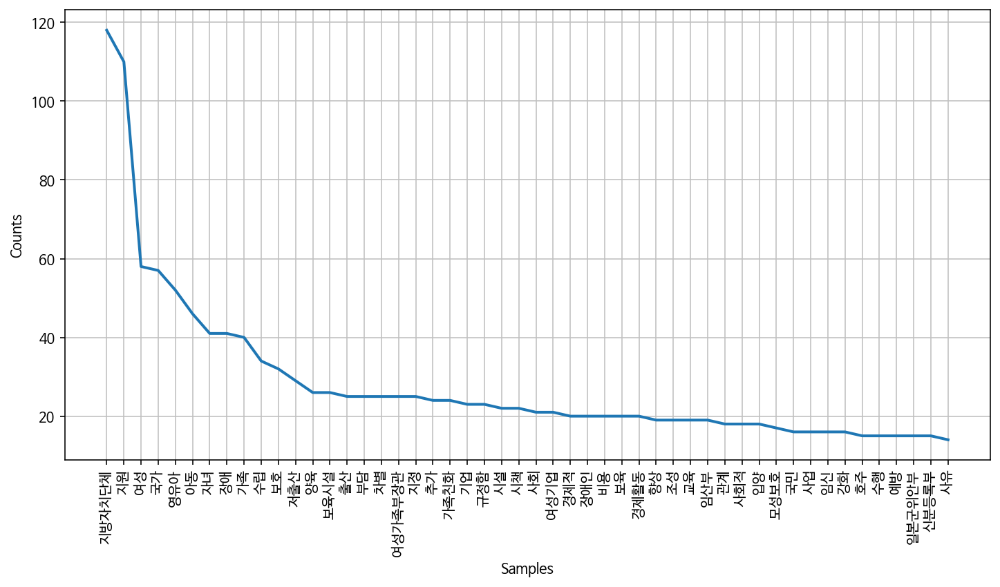

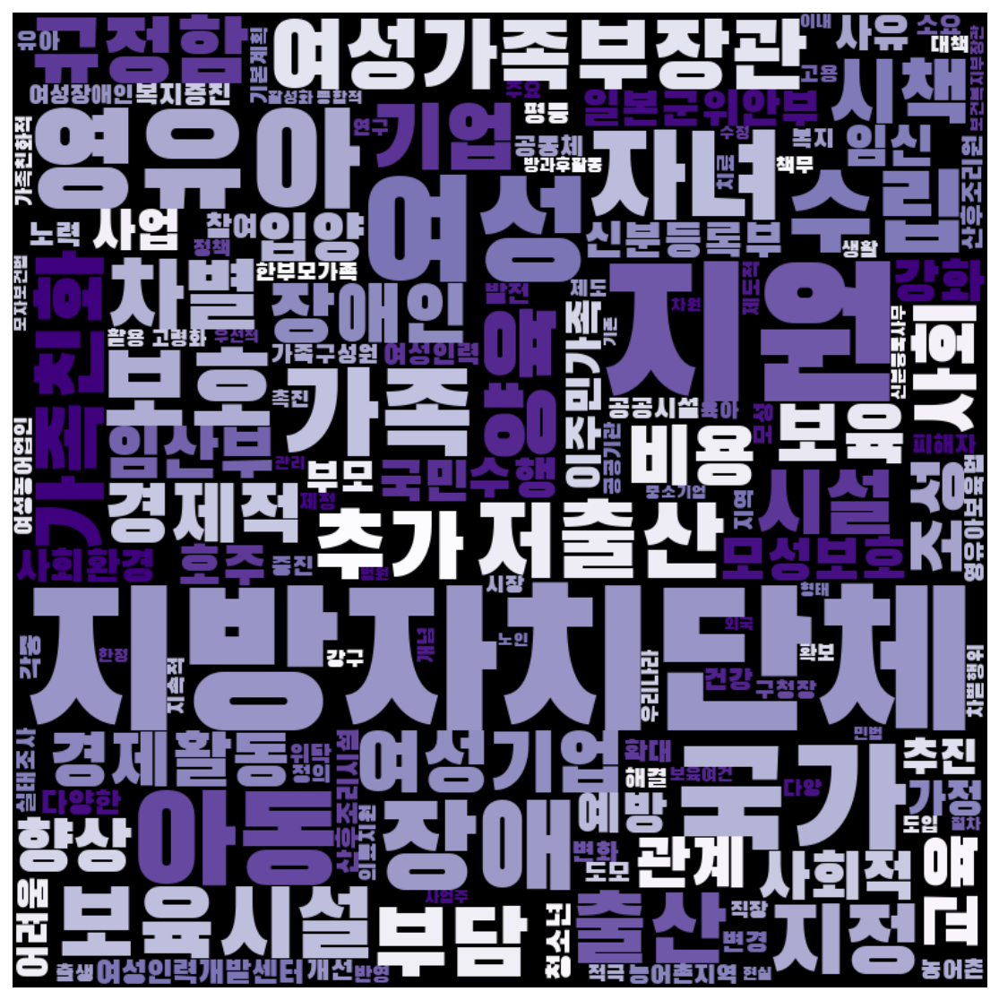

In [93]:
frewords_vis(women_g1_tokens)
wordcloud_vis(women_g1_tokens,'Accent')

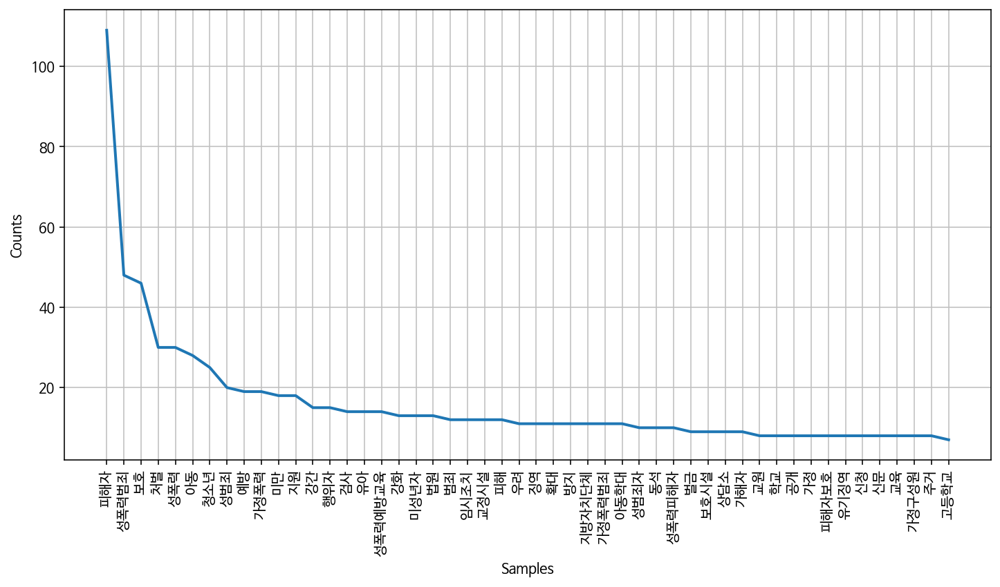

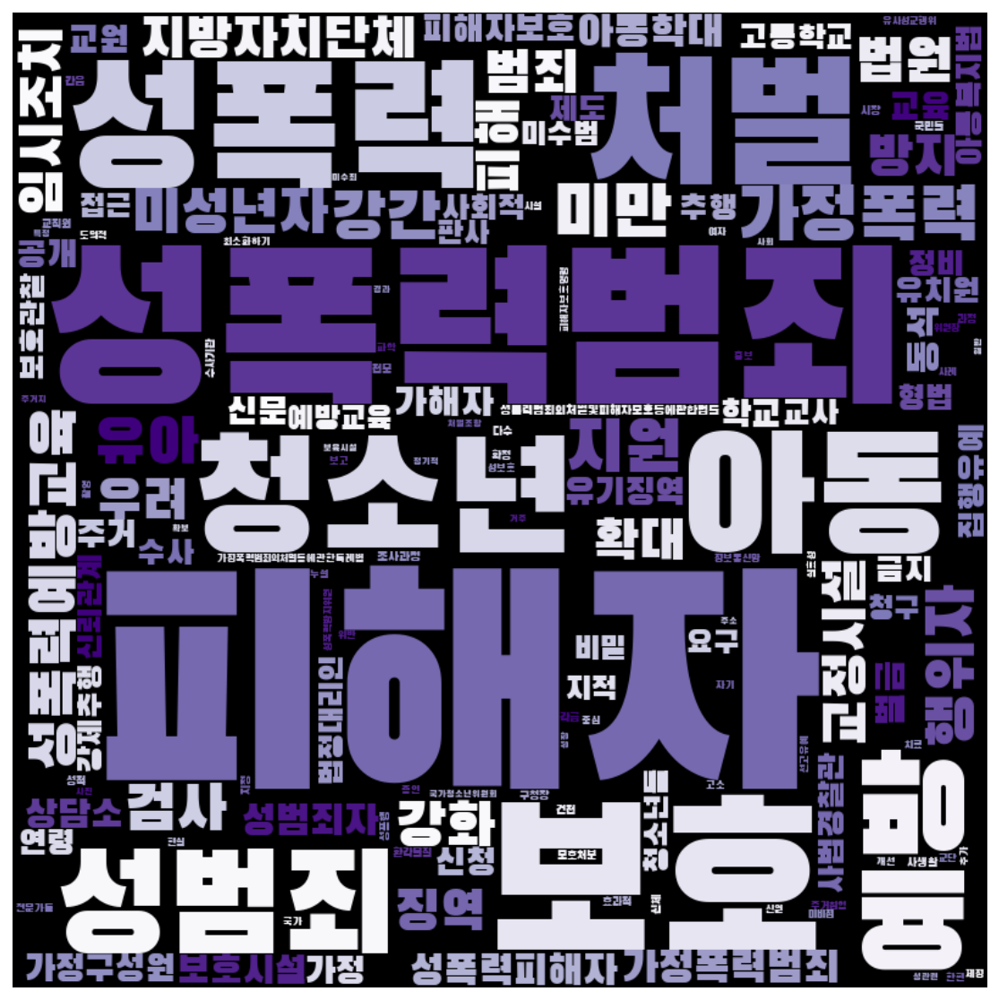

In [94]:
frewords_vis(women_g2_tokens)
wordcloud_vis(women_g2_tokens,'Accent')

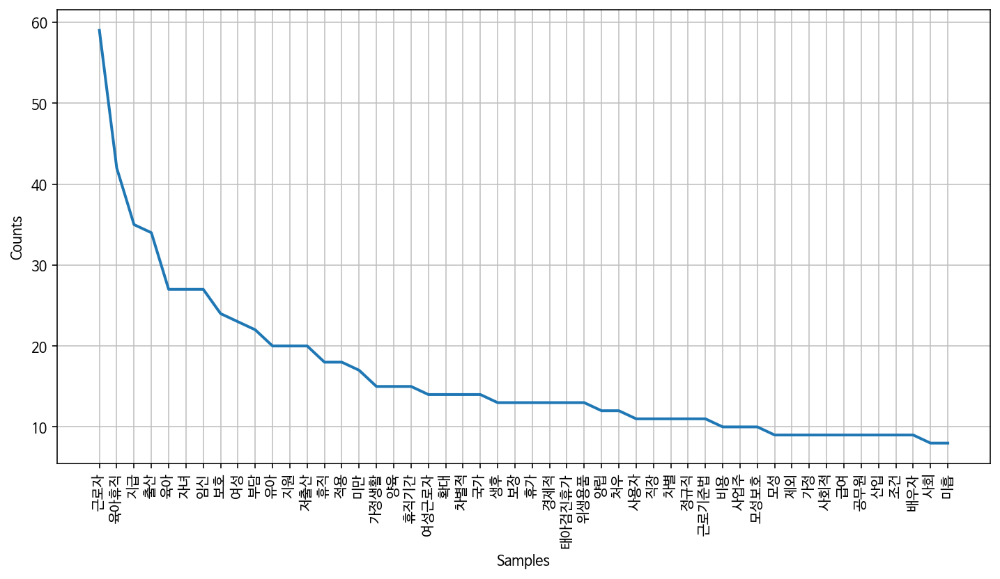

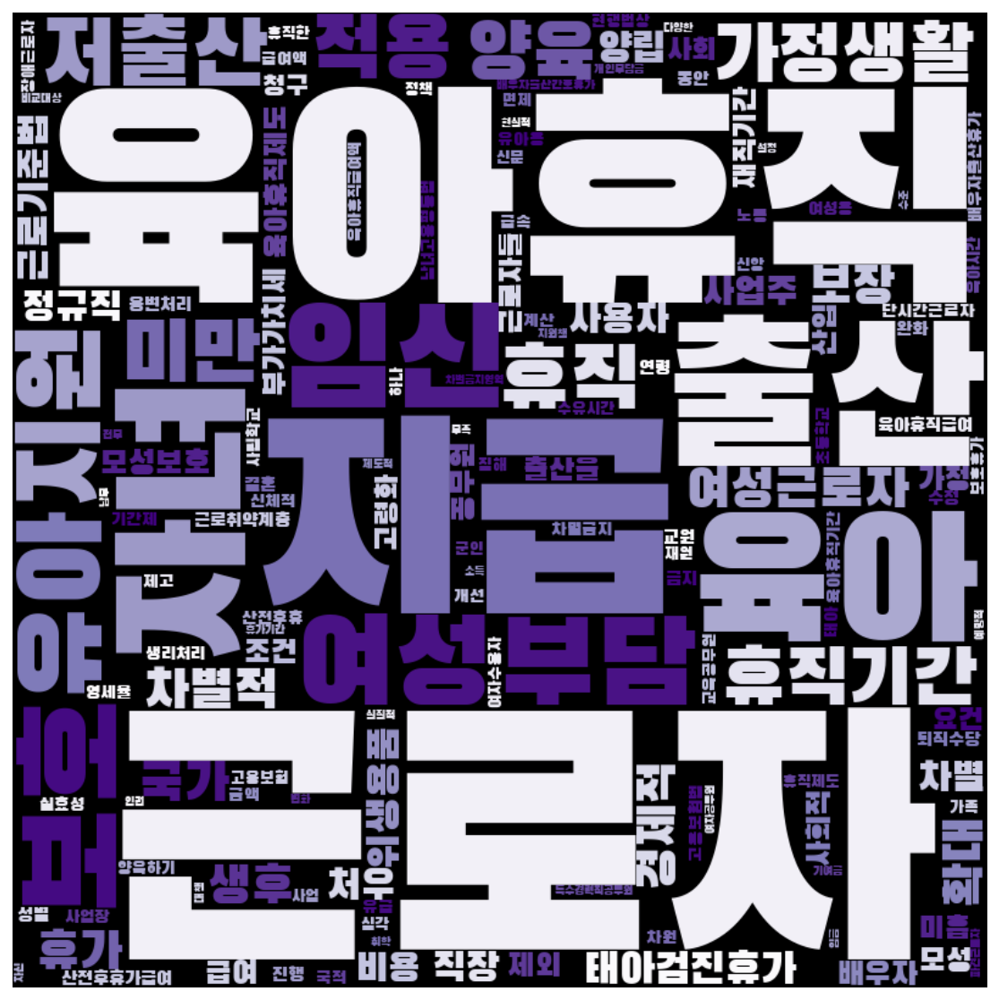

In [95]:
frewords_vis(women_g3_tokens)
wordcloud_vis(women_g3_tokens, 'Accent')

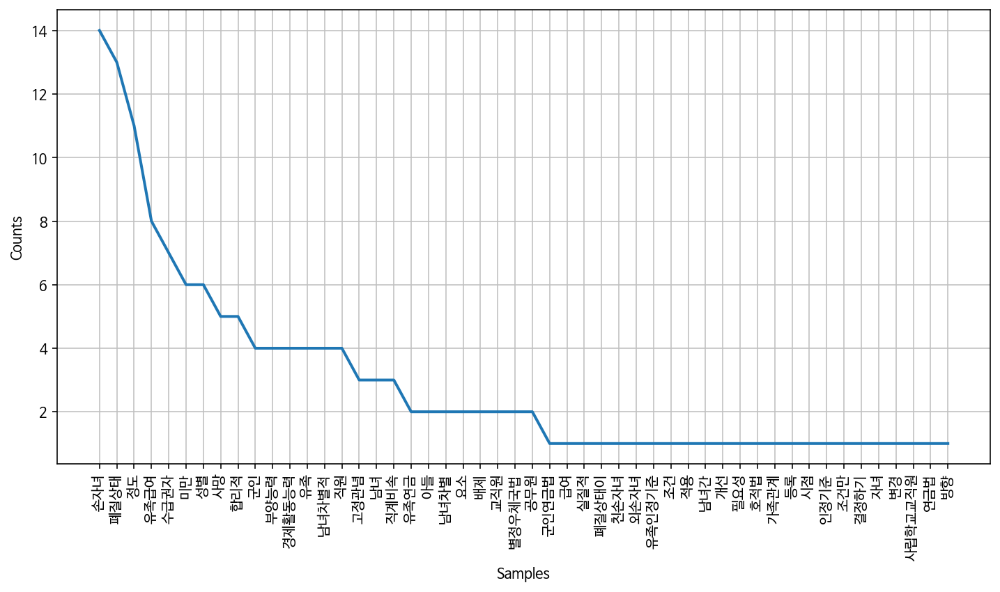

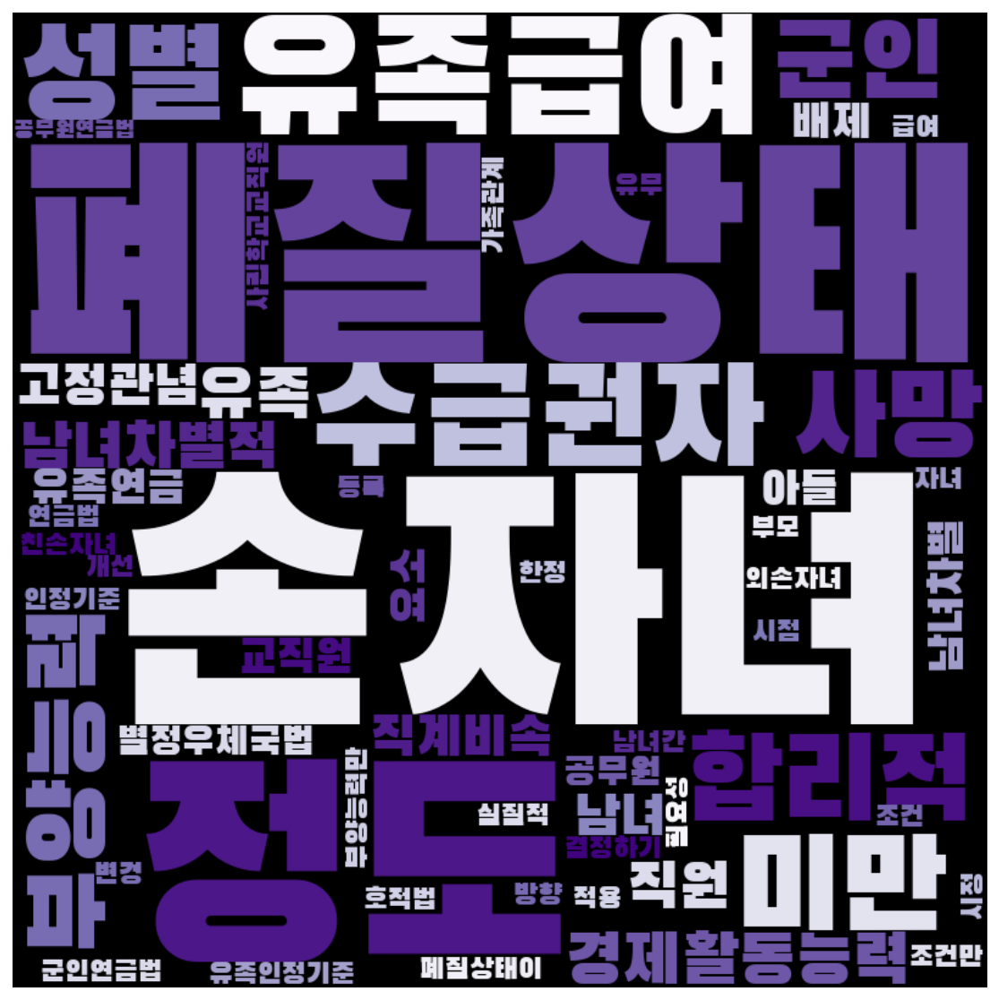

In [96]:
frewords_vis(women_g4_tokens)
wordcloud_vis(women_g4_tokens,'Accent')

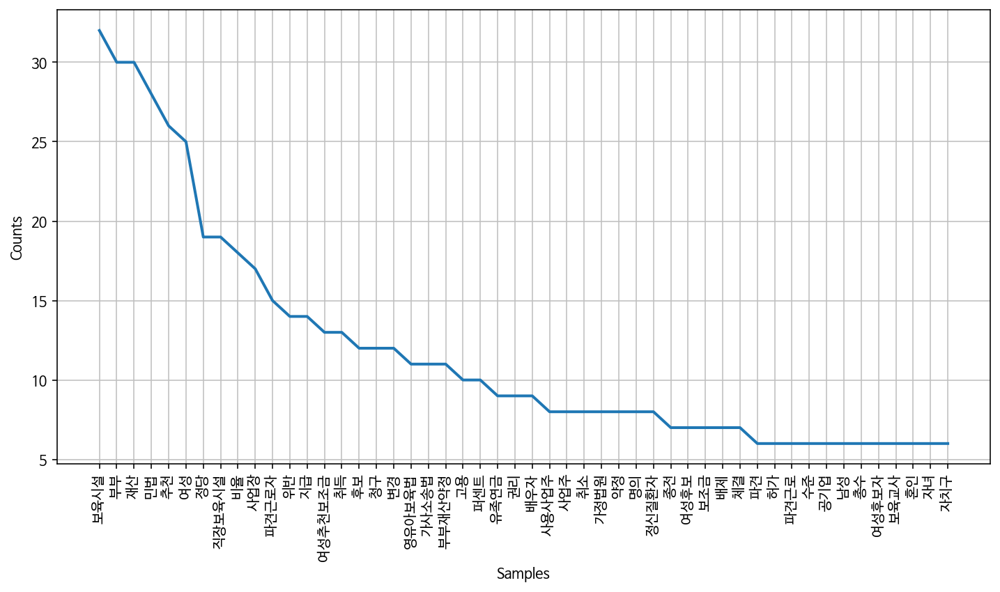

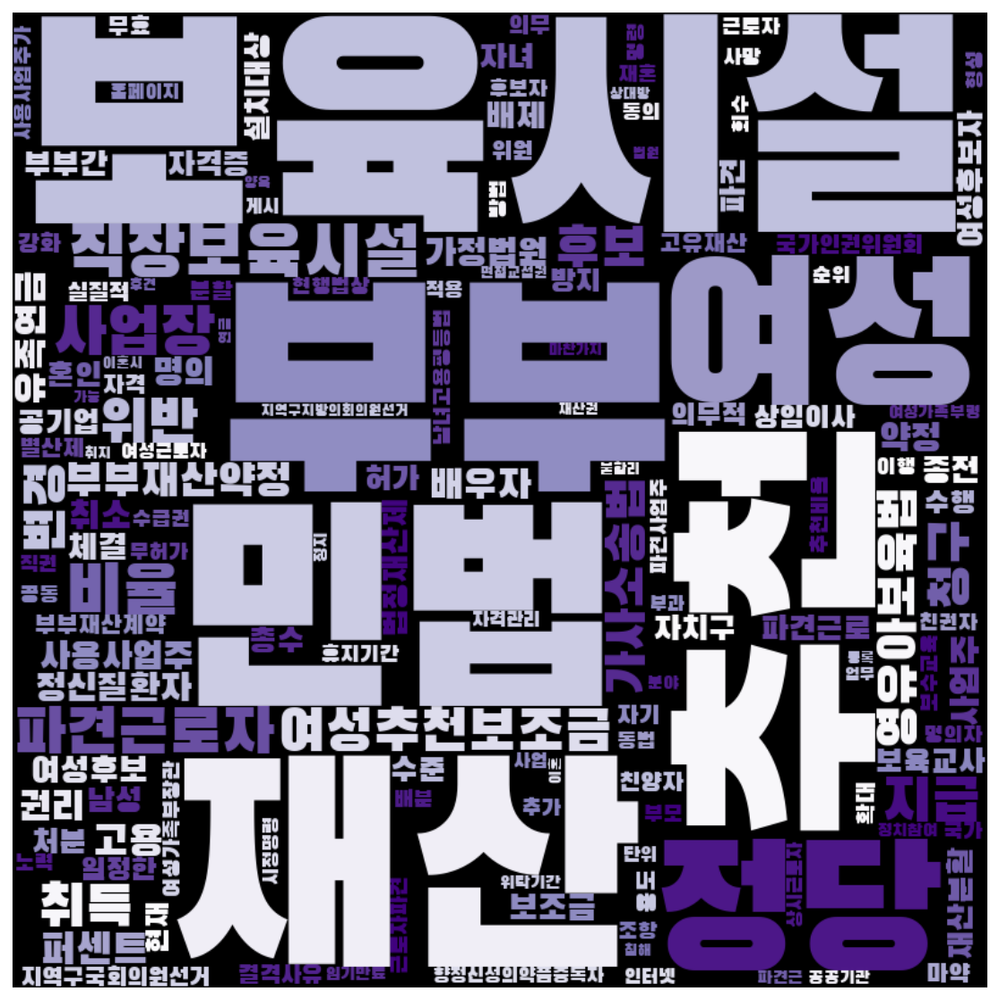

In [97]:
frewords_vis(women_g5_tokens)
wordcloud_vis(women_g5_tokens, 'Accent')

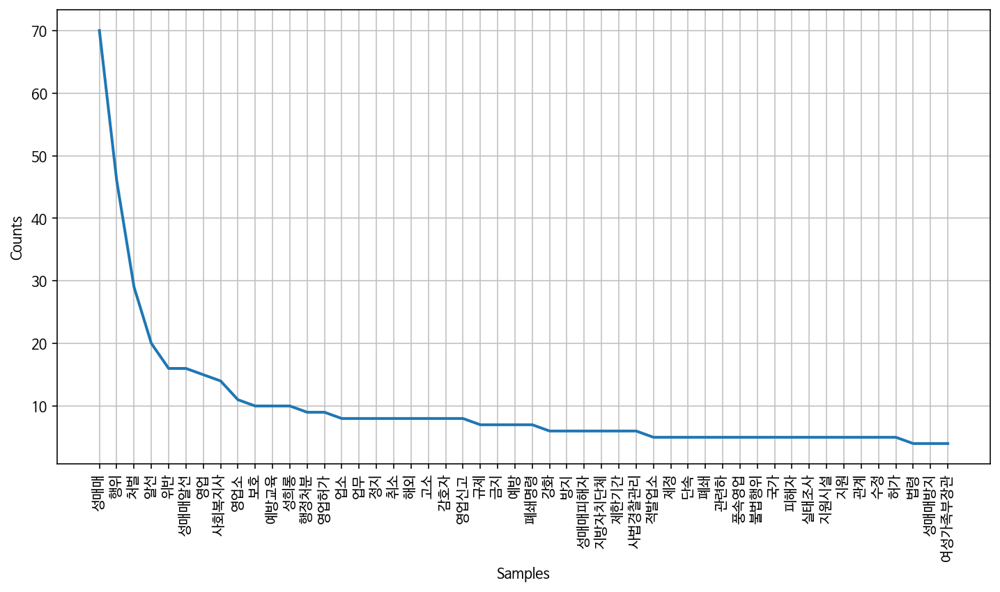

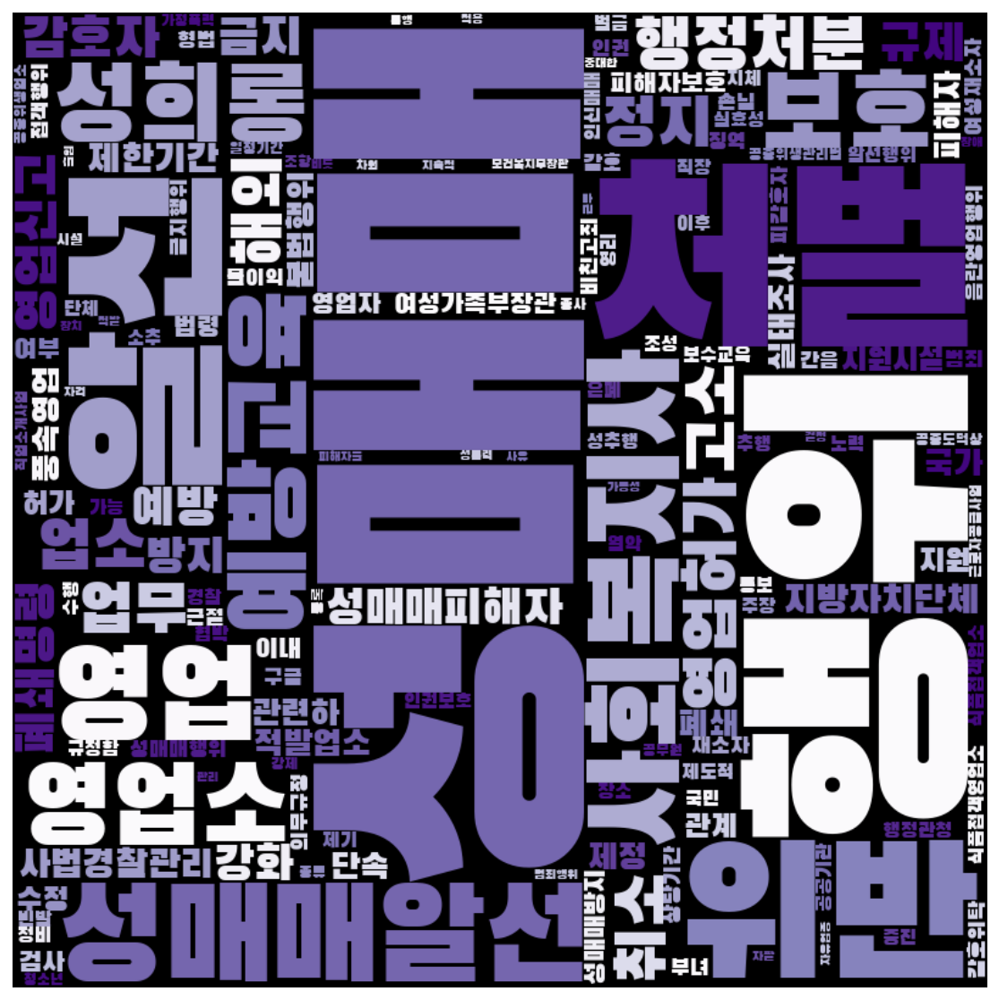

In [98]:
frewords_vis(women_g6_tokens)
wordcloud_vis(women_g6_tokens,'Accent')

엘보우: 100%|██████████| 14/14 [00:00<00:00, 18.80it/s]


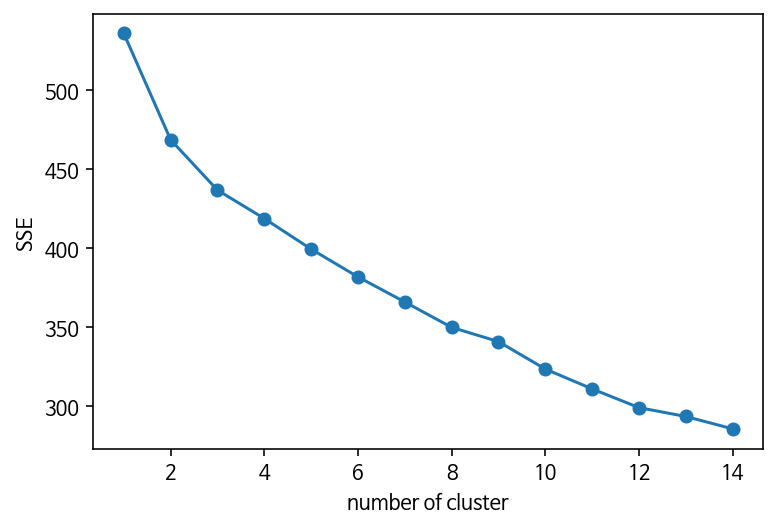

In [99]:
word_vectors_men = men['문장벡터'].to_list() # 함수에 넣을 X값 지정
elbow(word_vectors_men)

/usr/local/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


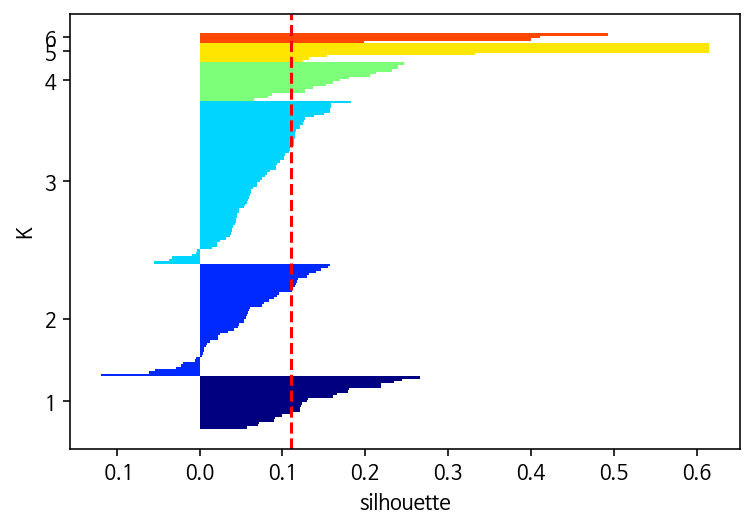

In [100]:
word_vectors_men = men['문장벡터'].to_list()
k= 6

X, y = make_blobs(n_samples=150, n_features=2, centers=3, cluster_std=0.5,
                  shuffle=True, random_state=0)
km = KMeans(n_clusters=k, algorithm='auto', random_state=42)
y_km = km.fit_predict(word_vectors_men)
plotSilhouette(word_vectors_men, y_km)

In [101]:
# K means 수행 
word_vectors_men = men['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_men)
men['category'] = idx

<ipython-input-101-ea17c2f5c726>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['category'] = idx


In [102]:
men['category'].value_counts()

1    45
4    40
2    36
5    28
3    11
0     5
Name: category, dtype: int64

In [103]:
men_g1 = men[men['category'] == 0]
men_g2 = men[men['category'] == 1]
men_g3 = men[men['category'] == 2]
men_g4 = men[men['category'] == 3]
men_g5 = men[men['category'] == 4]
men_g6 = men[men['category'] == 5]

In [104]:
men_g1_tokens = total_tokens(men_g1['tokens'])
men_g2_tokens = total_tokens(men_g2['tokens'])
men_g3_tokens = total_tokens(men_g3['tokens'])
men_g4_tokens = total_tokens(men_g4['tokens'])
men_g5_tokens = total_tokens(men_g5['tokens'])
men_g6_tokens = total_tokens(men_g6['tokens'])

In [105]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
men_g1_tokens = [each_word for each_word in men_g1_tokens if each_word not in stopwords]
men_g2_tokens = [each_word for each_word in men_g2_tokens if each_word not in stopwords]
men_g3_tokens = [each_word for each_word in men_g3_tokens if each_word not in stopwords]
men_g4_tokens = [each_word for each_word in men_g4_tokens if each_word not in stopwords]
men_g5_tokens = [each_word for each_word in men_g5_tokens if each_word not in stopwords]
men_g6_tokens = [each_word for each_word in men_g6_tokens if each_word not in stopwords]

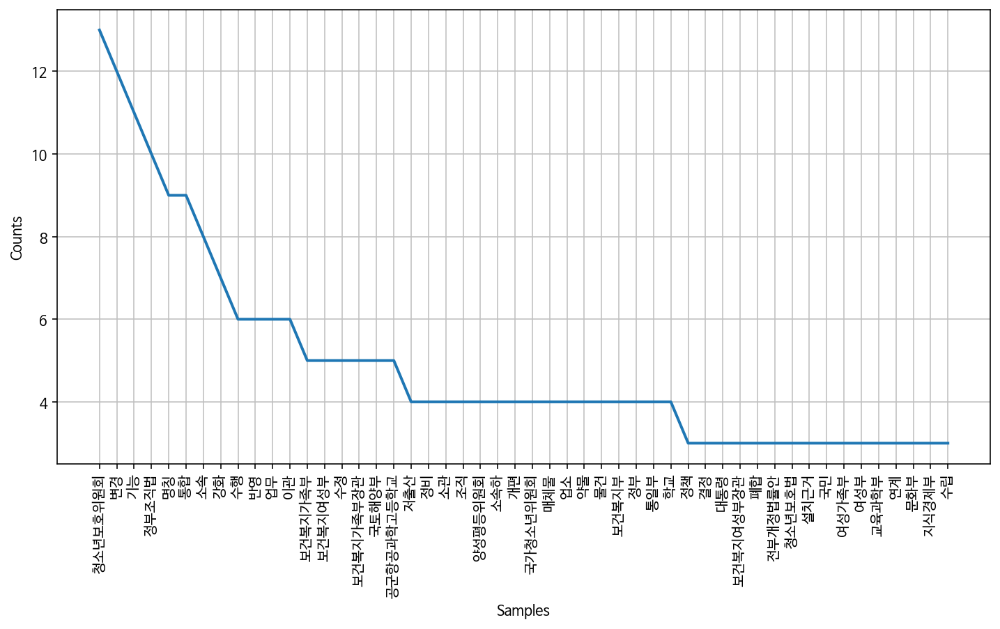

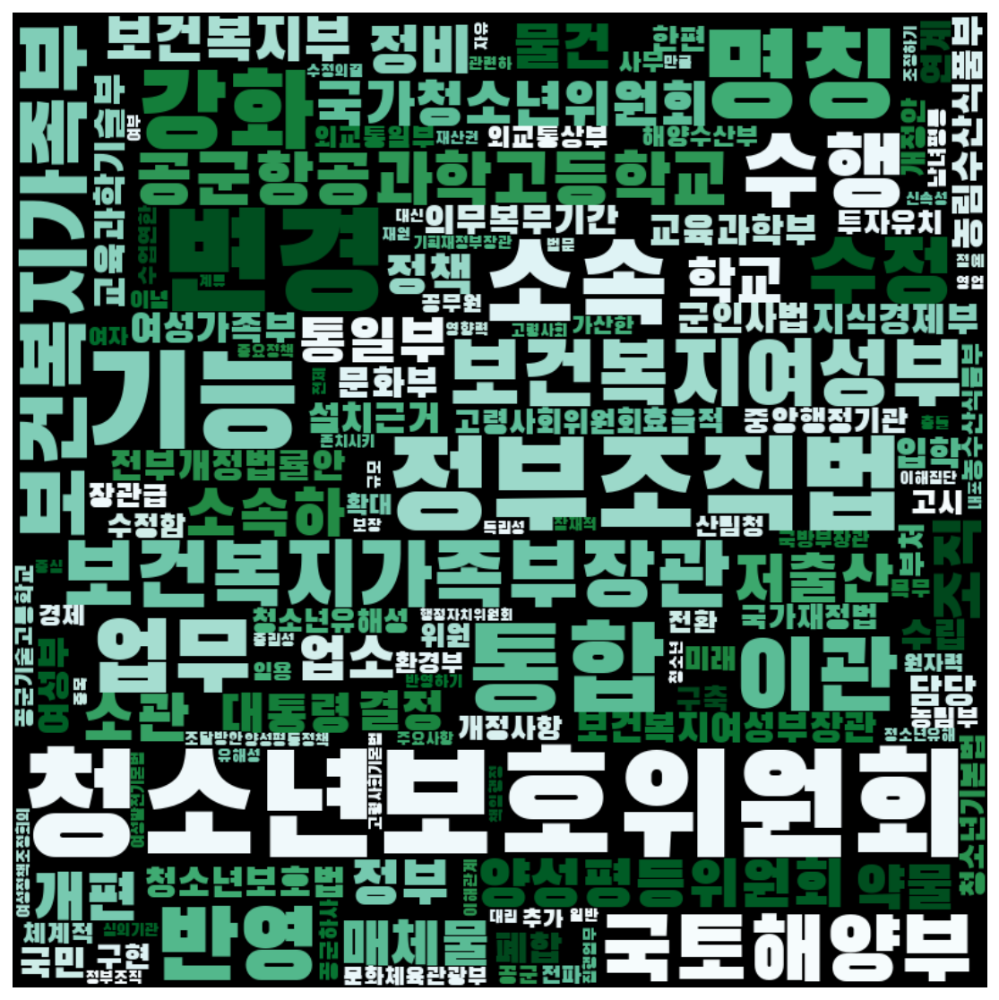

In [106]:
frewords_vis(men_g1_tokens)
wordcloud_vis(men_g1_tokens, 'coolwarm')

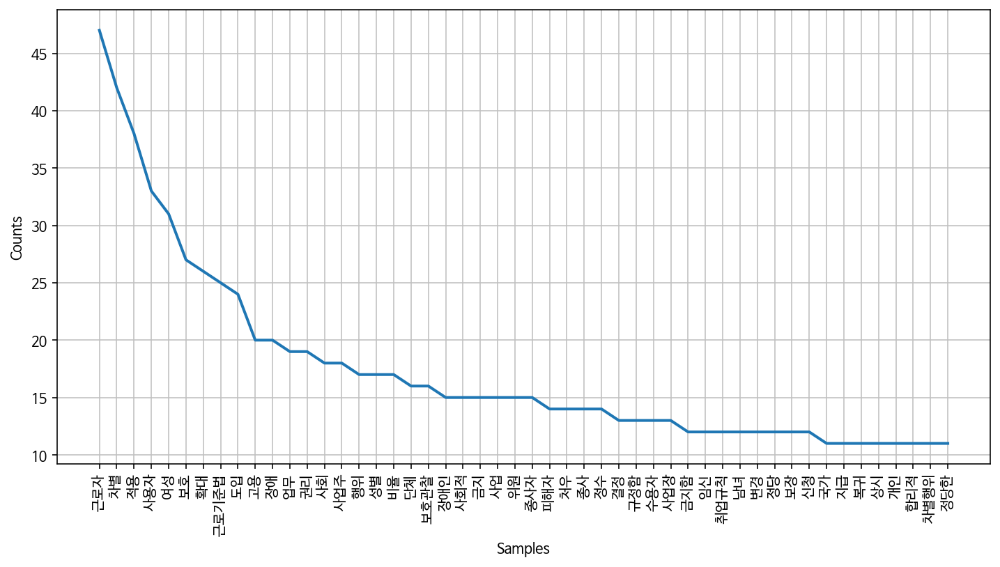

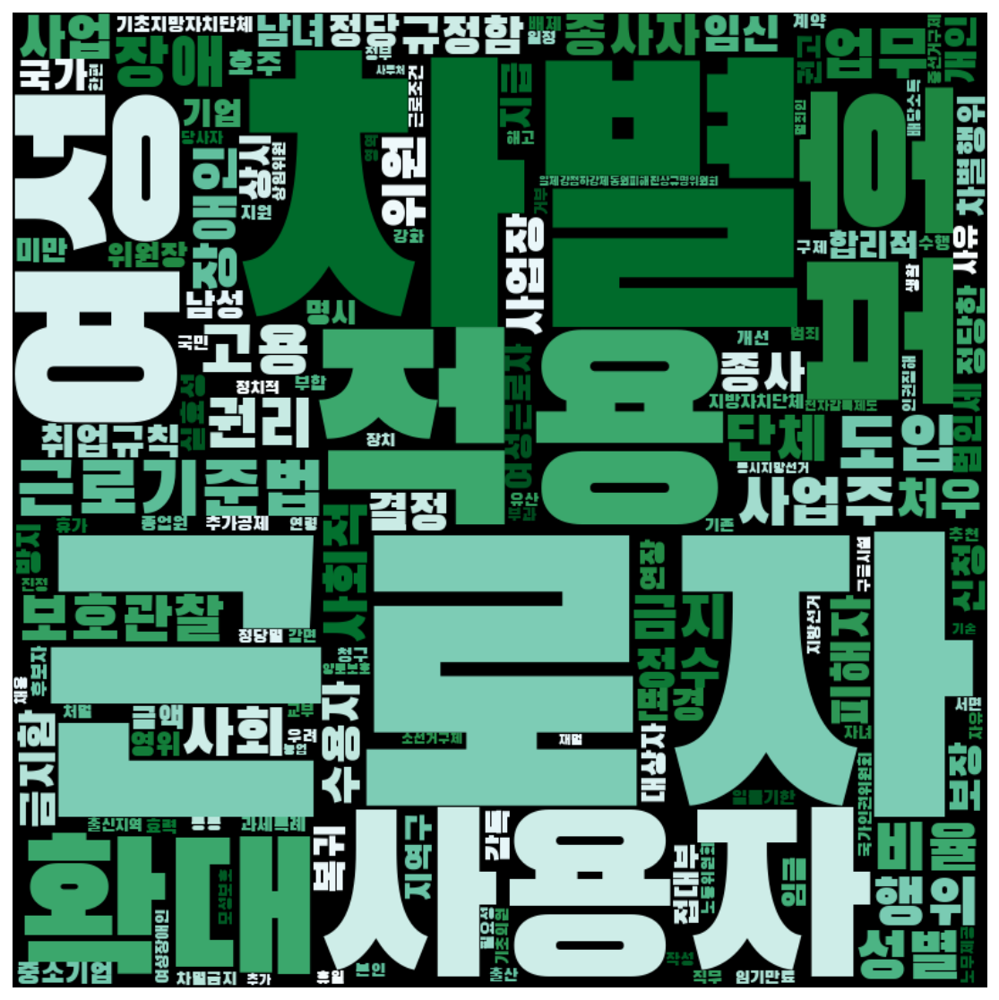

In [107]:
frewords_vis(men_g2_tokens)
wordcloud_vis(men_g2_tokens,'coolwarm')

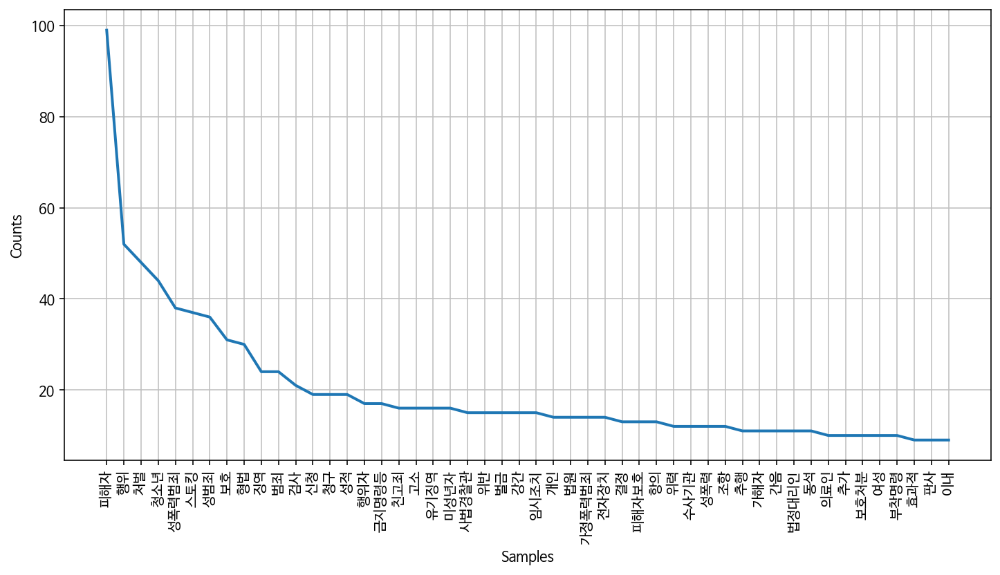

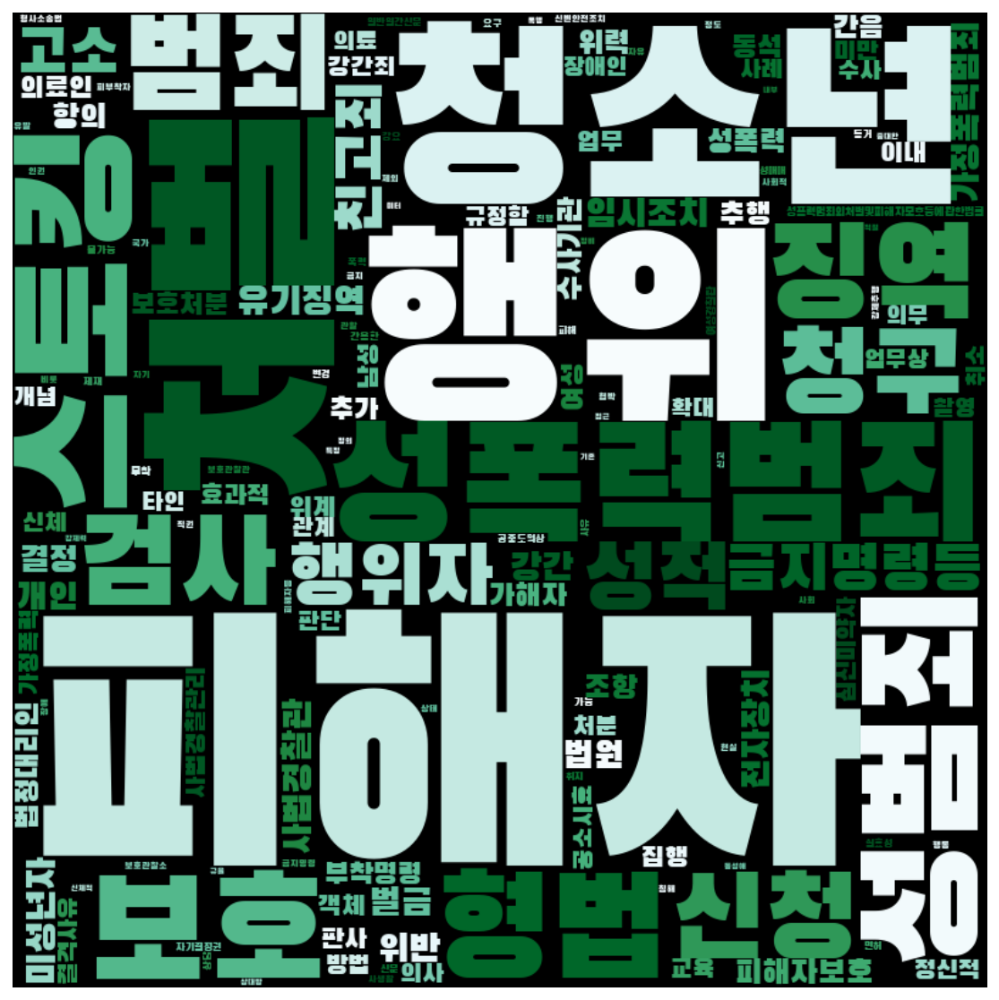

In [108]:
frewords_vis(men_g3_tokens)
wordcloud_vis(men_g3_tokens,'coolwarm')

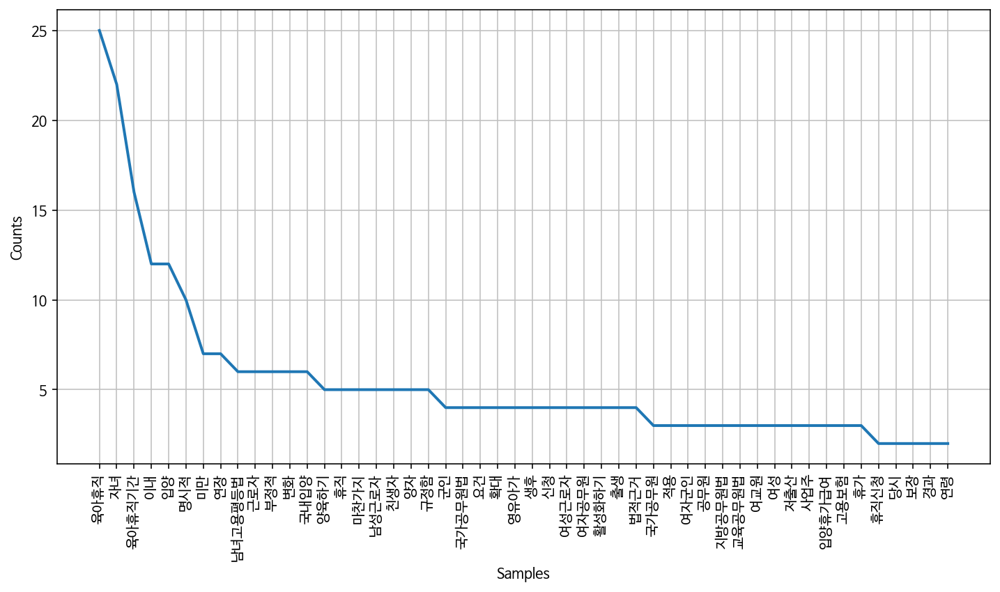

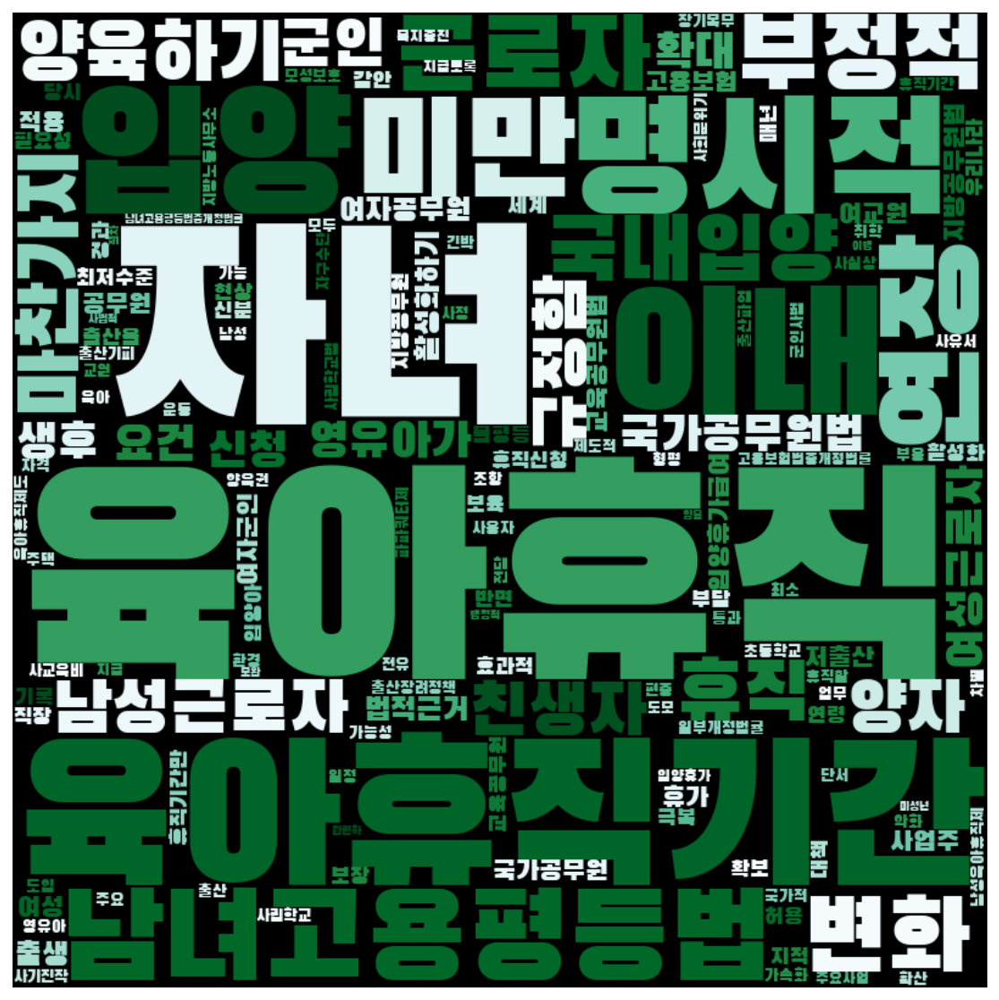

In [109]:
frewords_vis(men_g4_tokens)
wordcloud_vis(men_g4_tokens,'coolwarm')

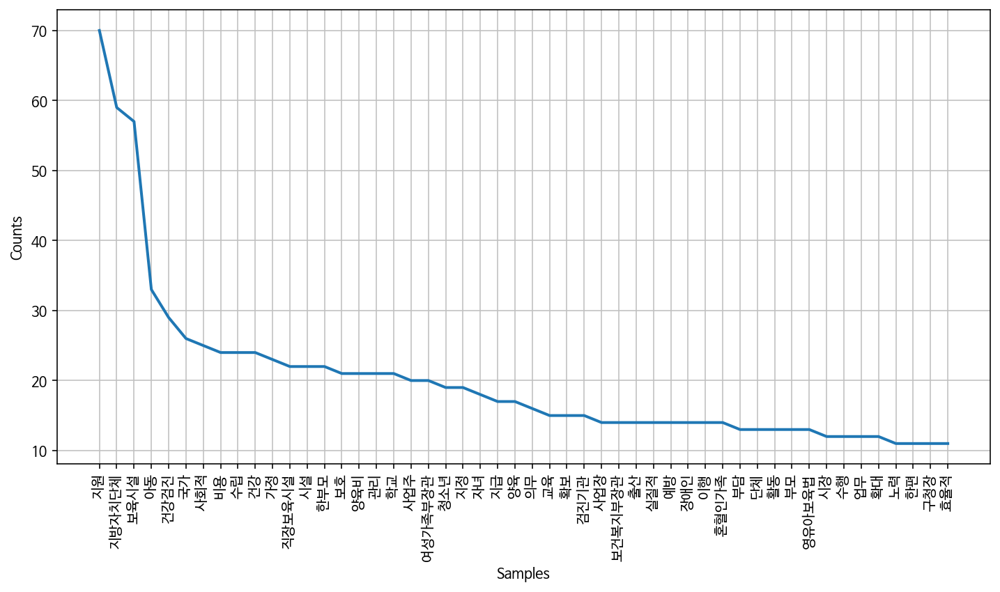

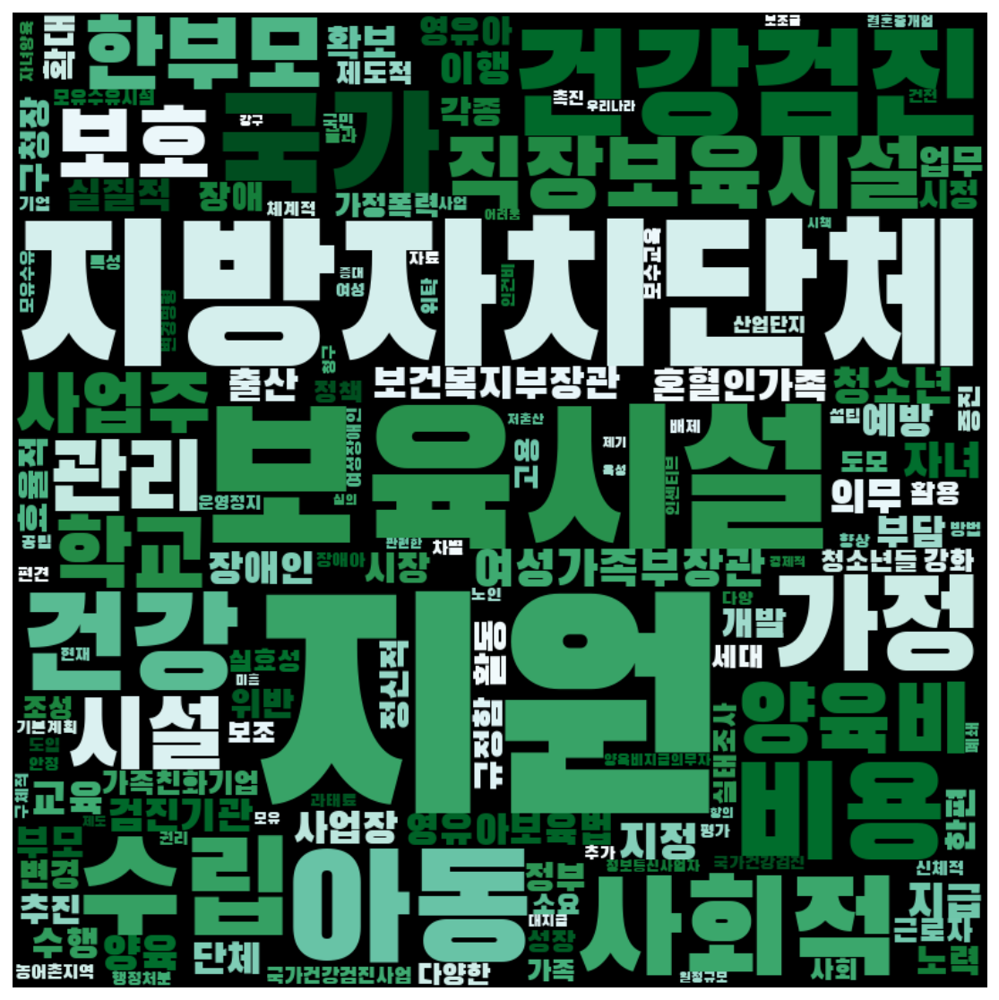

In [110]:
frewords_vis(men_g5_tokens)
wordcloud_vis(men_g5_tokens,'coolwarm')

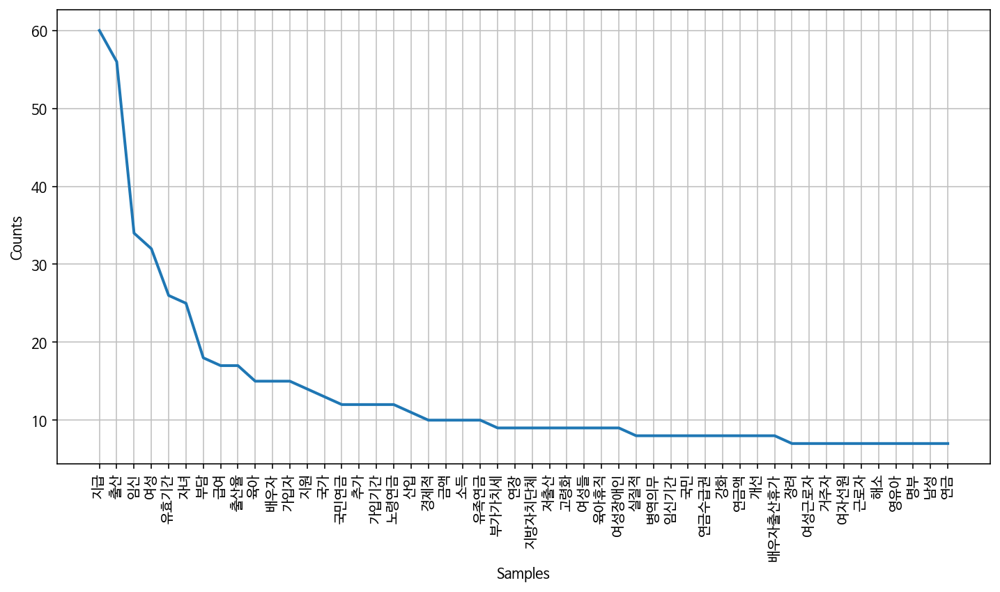

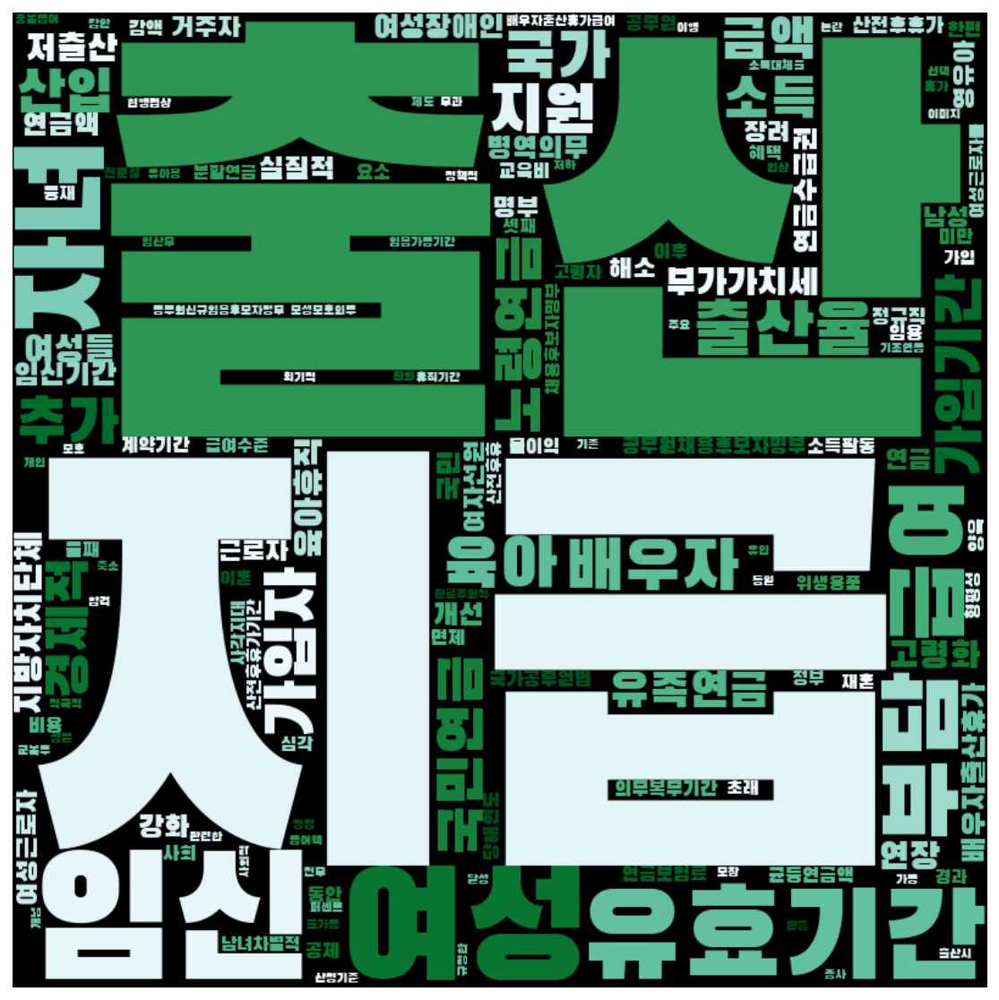

In [111]:
frewords_vis(men_g6_tokens)
wordcloud_vis(men_g6_tokens,'coolwarm')

## 이명박 정권
- 2008.02.25 ~ 2013.02.24

In [112]:
leemyungbak = gender[(gender['제안일자'] > datetime.date(2008,2,25)) & 
                        (gender['제안일자'] < datetime.date(2013,2,24))]
leemyungbak.shape

(1131, 19)

In [113]:
leemyungbak['성별'].value_counts()

남성    590
여성    412
Name: 성별, dtype: int64

In [114]:
pd.DataFrame(leemyungbak.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  321
     여성  242
진보   남성  244
     여성  169

In [115]:
women = leemyungbak[leemyungbak['성별'] == '여성']
men = leemyungbak[leemyungbak['성별'] == '남성']

In [116]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:50:24,837 : INFO : collecting all words and their counts
2020-10-20 14:50:24,839 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:50:24,851 : INFO : collected 6296 word types from a corpus of 34740 raw words and 412 sentences
2020-10-20 14:50:24,852 : INFO : Loading a fresh vocabulary
2020-10-20 14:50:24,858 : INFO : effective_min_count=10 retains 708 unique words (11% of original 6296, drops 5588)
2020-10-20 14:50:24,859 : INFO : effective_min_count=10 leaves 22016 word corpus (63% of original 34740, drops 12724)
2020-10-20 14:50:24,863 : INFO : deleting the raw counts dictionary of 6296 items
2020-10-20 14:50:24,864 : INFO : sample=0.001 downsamples 77 most-common words
2020-10-20 14:50:24,866 : INFO : downsampling leaves estimated 18211 word corpus (82.7% of prior 22016)
2020-10-20 14:50:24,868 : INFO : estimated required memory for 708 words and 100 dimensions: 920400 bytes
2020-10-20 14:50:24,869 : INFO : resetting layer weight

2020-10-20 14:50:26,192 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:26,197 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:26,200 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:26,201 : INFO : EPOCH - 15 : training on 34740 raw words (18301 effective words) took 0.1s, 341877 effective words/s
2020-10-20 14:50:26,249 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:26,267 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:26,275 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:26,276 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:26,277 : INFO : EPOCH - 16 : training on 34740 raw words (18195 effective words) took 0.1s, 248799 effective words/s
2020-10-20 14:50:26,322 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:50:27,413 : INFO : EPOCH - 31 : training on 34740 raw words (18253 effective words) took 0.1s, 280286 effective words/s
2020-10-20 14:50:27,466 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:27,468 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:27,487 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:27,489 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:27,490 : INFO : EPOCH - 32 : training on 34740 raw words (18196 effective words) took 0.1s, 260917 effective words/s
2020-10-20 14:50:27,540 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:27,543 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:27,559 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:27,561 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:50:28,675 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:28,691 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:28,693 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:28,694 : INFO : EPOCH - 48 : training on 34740 raw words (18199 effective words) took 0.1s, 236691 effective words/s
2020-10-20 14:50:28,740 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:28,748 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:28,757 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:28,761 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:28,762 : INFO : EPOCH - 49 : training on 34740 raw words (18149 effective words) took 0.1s, 280001 effective words/s
2020-10-20 14:50:28,809 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:50:29,867 : INFO : EPOCH - 64 : training on 34740 raw words (18319 effective words) took 0.1s, 261624 effective words/s
2020-10-20 14:50:29,911 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:29,923 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:29,928 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:29,934 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:29,935 : INFO : EPOCH - 65 : training on 34740 raw words (18226 effective words) took 0.1s, 298790 effective words/s
2020-10-20 14:50:29,974 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:29,988 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:29,992 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:29,999 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:50:31,097 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:31,116 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:31,117 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:31,119 : INFO : EPOCH - 81 : training on 34740 raw words (18231 effective words) took 0.1s, 269925 effective words/s
2020-10-20 14:50:31,165 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:31,177 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:31,187 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:31,192 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:31,193 : INFO : EPOCH - 82 : training on 34740 raw words (18244 effective words) took 0.1s, 266554 effective words/s
2020-10-20 14:50:31,243 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:50:32,354 : INFO : EPOCH - 97 : training on 34740 raw words (18182 effective words) took 0.1s, 231695 effective words/s
2020-10-20 14:50:32,398 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:32,410 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:32,420 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:32,421 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:32,422 : INFO : EPOCH - 98 : training on 34740 raw words (18129 effective words) took 0.1s, 282876 effective words/s
2020-10-20 14:50:32,465 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:32,479 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:32,486 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:32,494 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:50:33,967 : INFO : EPOCH - 11 : training on 45274 raw words (26287 effective words) took 0.1s, 307321 effective words/s
2020-10-20 14:50:34,043 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:34,046 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:34,049 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:34,064 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:34,065 : INFO : EPOCH - 12 : training on 45274 raw words (26263 effective words) took 0.1s, 282010 effective words/s
2020-10-20 14:50:34,137 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:34,140 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:34,143 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:34,156 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:50:35,667 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:35,668 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:35,687 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:35,689 : INFO : EPOCH - 28 : training on 45274 raw words (26306 effective words) took 0.1s, 283587 effective words/s
2020-10-20 14:50:35,777 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:35,780 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:35,784 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:35,801 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:35,801 : INFO : EPOCH - 29 : training on 45274 raw words (26206 effective words) took 0.1s, 262338 effective words/s
2020-10-20 14:50:35,880 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:50:37,280 : INFO : EPOCH - 44 : training on 45274 raw words (26230 effective words) took 0.1s, 282074 effective words/s
2020-10-20 14:50:37,349 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:37,358 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:37,361 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:37,371 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:37,372 : INFO : EPOCH - 45 : training on 45274 raw words (26264 effective words) took 0.1s, 297305 effective words/s
2020-10-20 14:50:37,451 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:37,452 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:37,456 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:37,467 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:50:38,990 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:38,991 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:39,004 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:39,005 : INFO : EPOCH - 61 : training on 45274 raw words (26235 effective words) took 0.1s, 296524 effective words/s
2020-10-20 14:50:39,104 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:39,106 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:39,108 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:39,127 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:39,128 : INFO : EPOCH - 62 : training on 45274 raw words (26242 effective words) took 0.1s, 225971 effective words/s
2020-10-20 14:50:39,210 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:50:40,710 : INFO : EPOCH - 77 : training on 45274 raw words (26388 effective words) took 0.1s, 213227 effective words/s
2020-10-20 14:50:40,796 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:40,799 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:40,803 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:40,823 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:40,823 : INFO : EPOCH - 78 : training on 45274 raw words (26211 effective words) took 0.1s, 258899 effective words/s
2020-10-20 14:50:40,900 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:40,903 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:40,906 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:40,924 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:50:42,460 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:42,461 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:42,462 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:42,464 : INFO : EPOCH - 94 : training on 45274 raw words (26295 effective words) took 0.1s, 299313 effective words/s
2020-10-20 14:50:42,538 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:50:42,545 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:50:42,547 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:50:42,564 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:50:42,565 : INFO : EPOCH - 95 : training on 45274 raw words (26301 effective words) took 0.1s, 274528 effective words/s
2020-10-20 14:50:42,630 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [117]:
print(model_women.wv.most_similar('여성'))

2020-10-20 14:50:43,079 : INFO : precomputing L2-norms of word weight vectors


[('정치참여', 0.4973973035812378), ('남성', 0.4747106432914734), ('임원', 0.4580496549606323), ('여성조합원', 0.4330078065395355), ('정부', 0.42765066027641296), ('지역구지방의회의원선거', 0.42397773265838623), ('경제활동', 0.41788390278816223), ('현행법상', 0.41122913360595703), ('세계', 0.4050350487232208), ('추천', 0.3957912027835846)]


In [118]:
print(model_men.wv.most_similar('여성'))

2020-10-20 14:50:43,092 : INFO : precomputing L2-norms of word weight vectors


[('관점', 0.45897090435028076), ('여성비하적', 0.453431636095047), ('관념', 0.44982191920280457), ('남성', 0.44195082783699036), ('우리나라', 0.428625226020813), ('표현', 0.40900498628616333), ('임원', 0.40787094831466675), ('국가공무원법', 0.40664005279541016), ('고정관념', 0.39655715227127075), ('내포', 0.3756996691226959)]


In [119]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [120]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

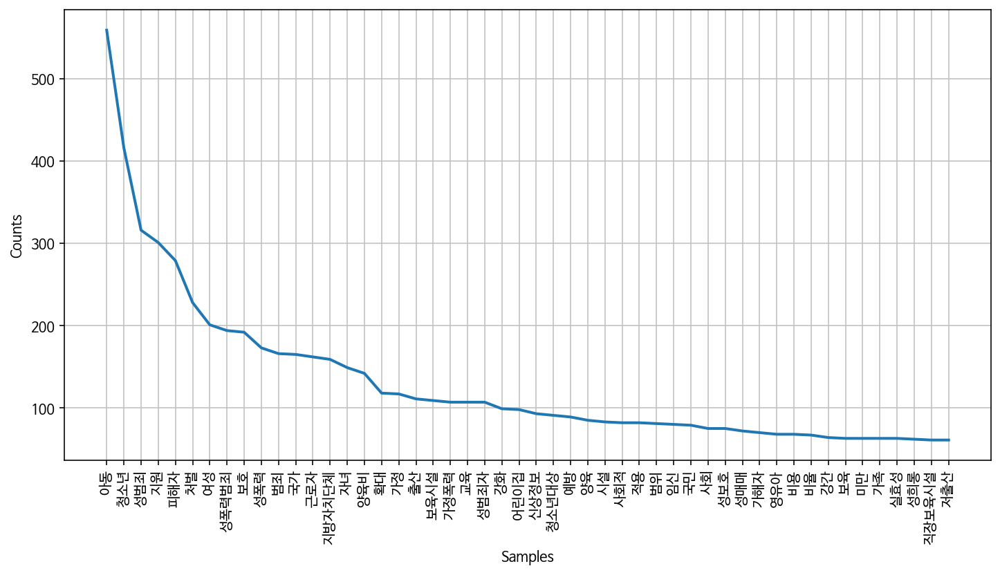

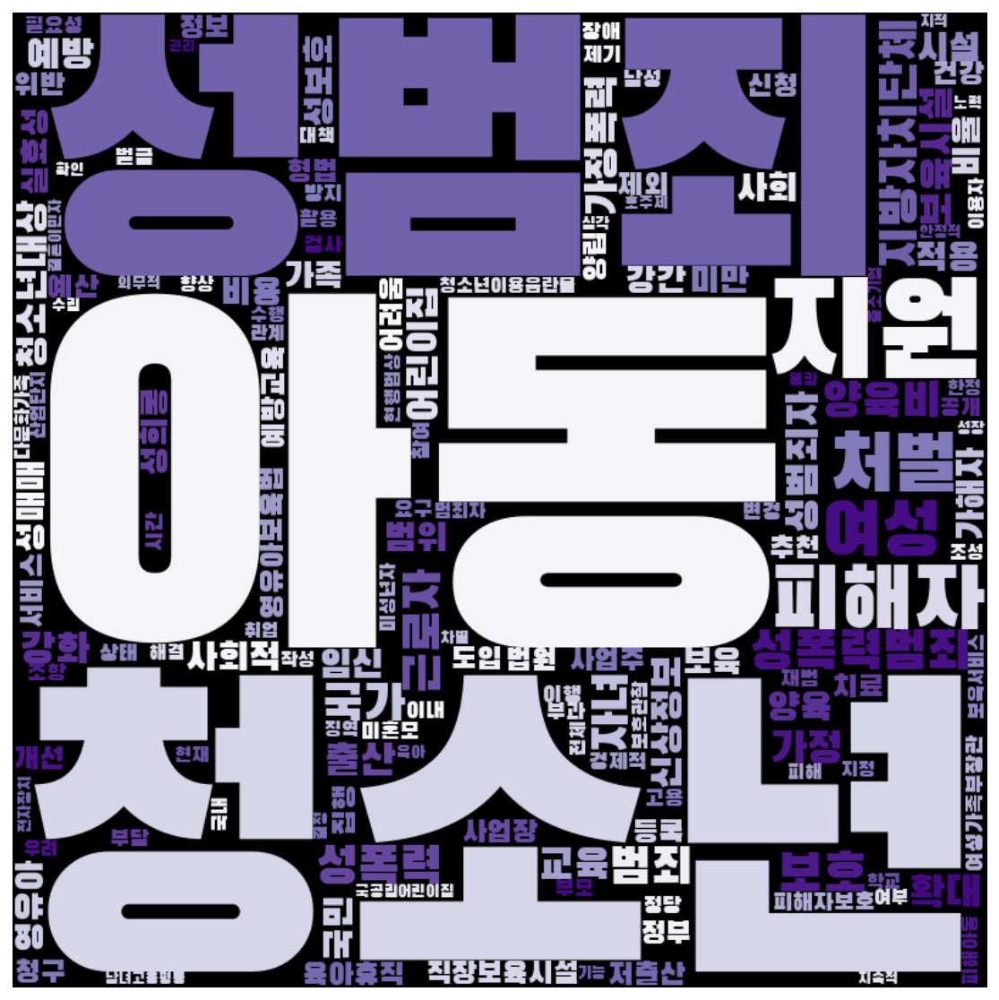

In [121]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

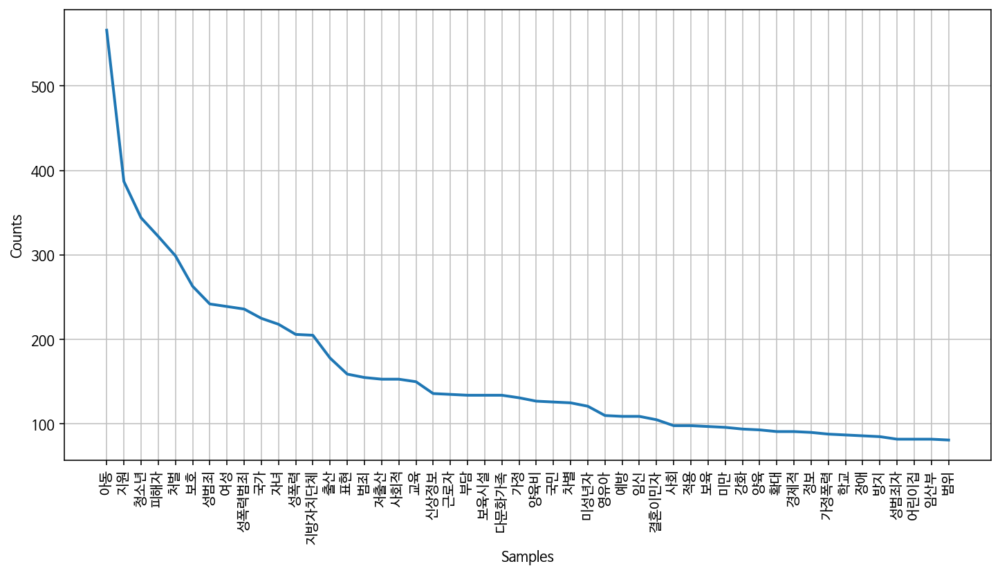

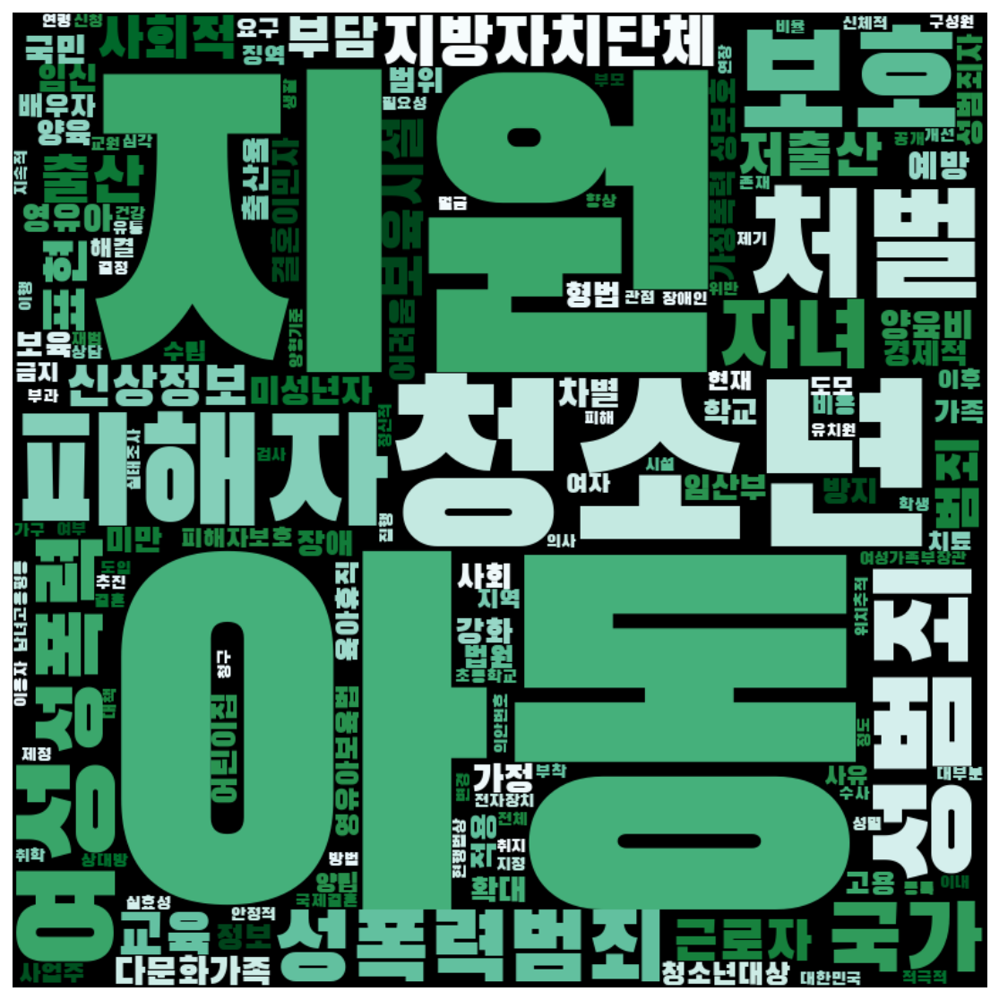

In [122]:
frewords_vis(men_word)
wordcloud_vis(men_word, 'coolwarm')

In [123]:
women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))

<ipython-input-123-87b19f55aed6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
<ipython-input-123-87b19f55aed6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))


엘보우: 100%|██████████| 14/14 [00:01<00:00, 10.07it/s]


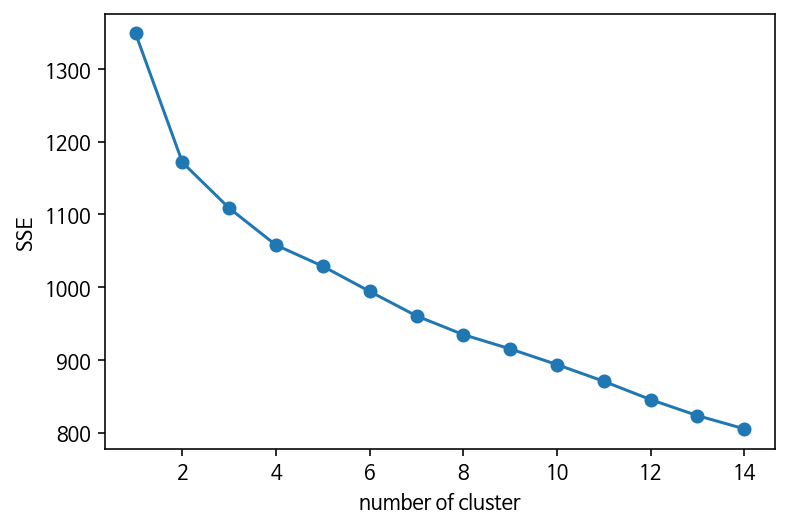

In [124]:
word_vectors_women = women['문장벡터'].to_list() # 함수에 넣을 X값 지정
elbow(word_vectors_women)

In [125]:
# K means 수행 
word_vectors_women = women['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_women)
women['category'] = idx

<ipython-input-125-758a1e279dd2>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['category'] = idx


In [126]:
women['category'].value_counts()

1    145
4    124
5     49
2     41
0     36
3     17
Name: category, dtype: int64

In [127]:
women_g1 = women[women['category'] == 0]
women_g2 = women[women['category'] == 1]
women_g3 = women[women['category'] == 2]
women_g4 = women[women['category'] == 3]
women_g5 = women[women['category'] == 4]
women_g6 = women[women['category'] == 5]

In [128]:
women_g1_tokens = total_tokens(women_g1['tokens'])
women_g2_tokens = total_tokens(women_g2['tokens'])
women_g3_tokens = total_tokens(women_g3['tokens'])
women_g4_tokens = total_tokens(women_g4['tokens'])
women_g5_tokens = total_tokens(women_g5['tokens'])
women_g6_tokens = total_tokens(women_g6['tokens'])

In [129]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
women_g1_tokens = [each_word for each_word in women_g1_tokens if each_word not in stopwords]
women_g2_tokens = [each_word for each_word in women_g2_tokens if each_word not in stopwords]
women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

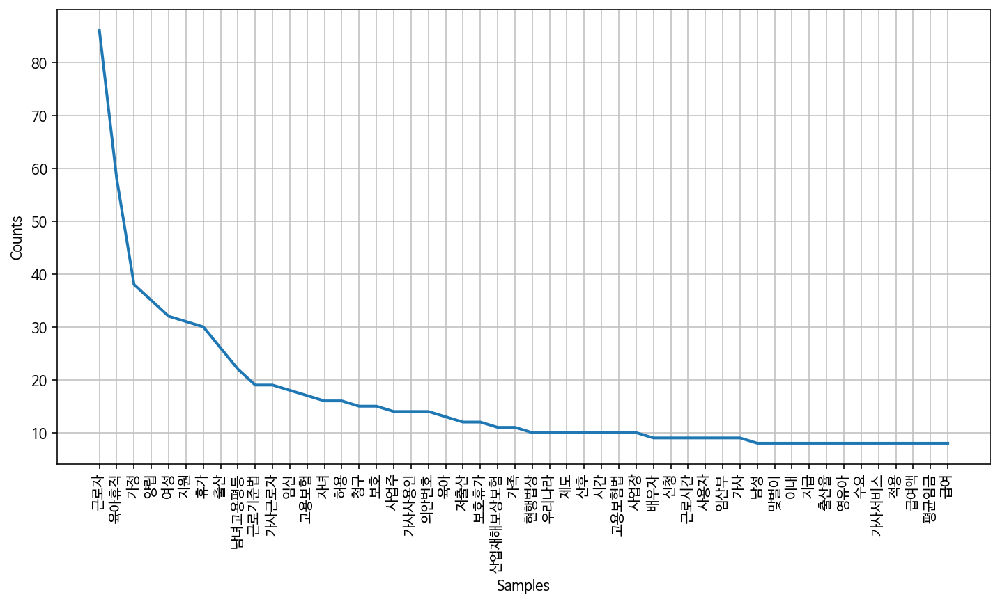

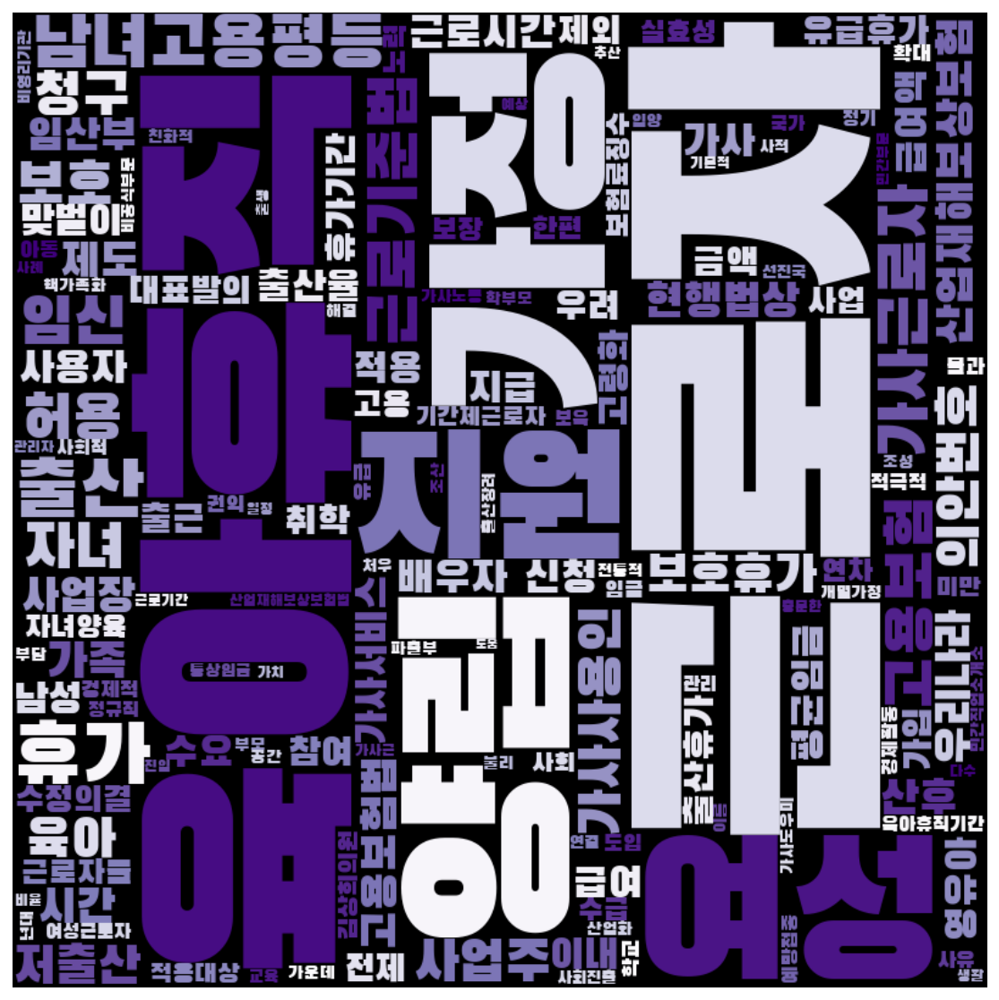

In [130]:
frewords_vis(women_g1_tokens)
wordcloud_vis(women_g1_tokens, 'Accent')

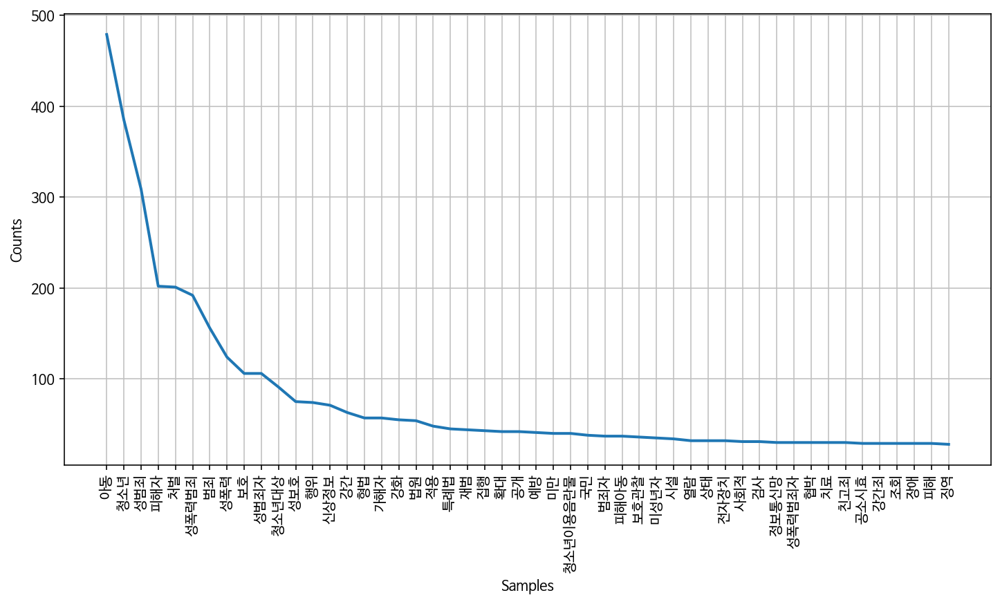

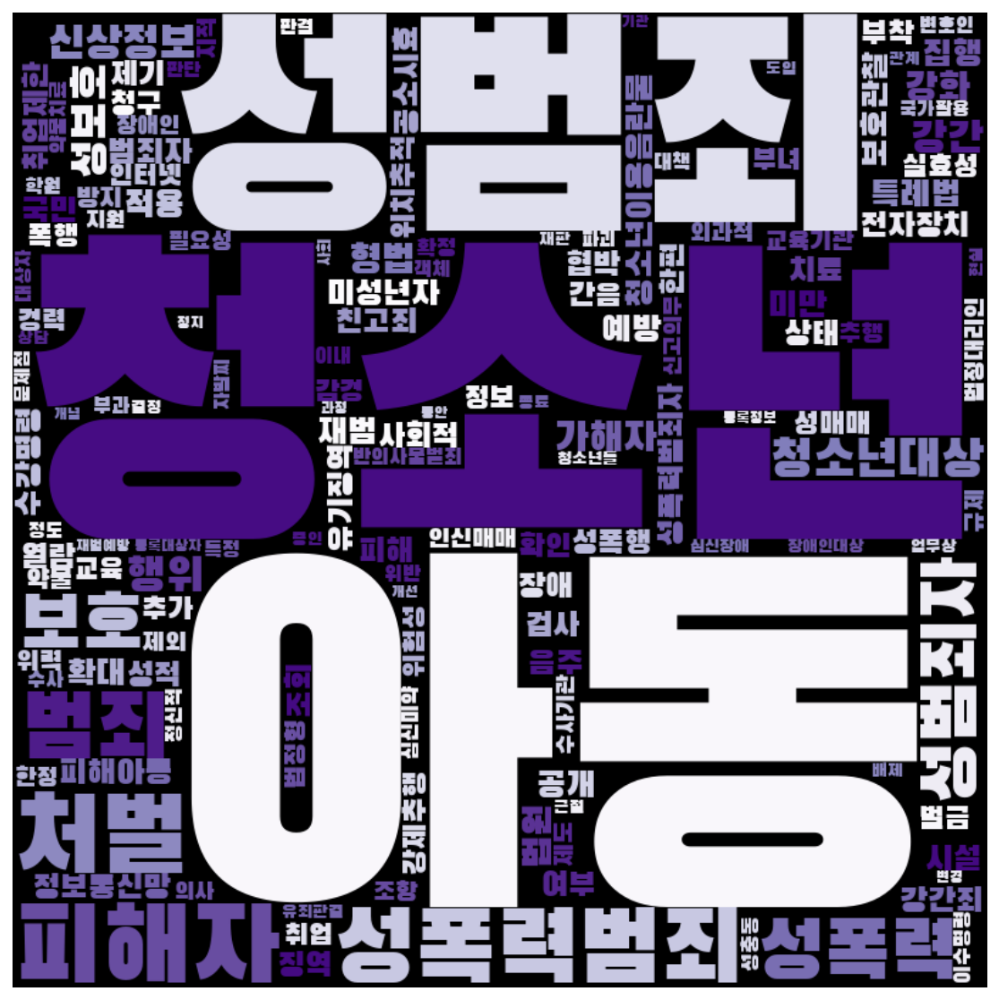

In [131]:
frewords_vis(women_g2_tokens)
wordcloud_vis(women_g2_tokens,'Accent')

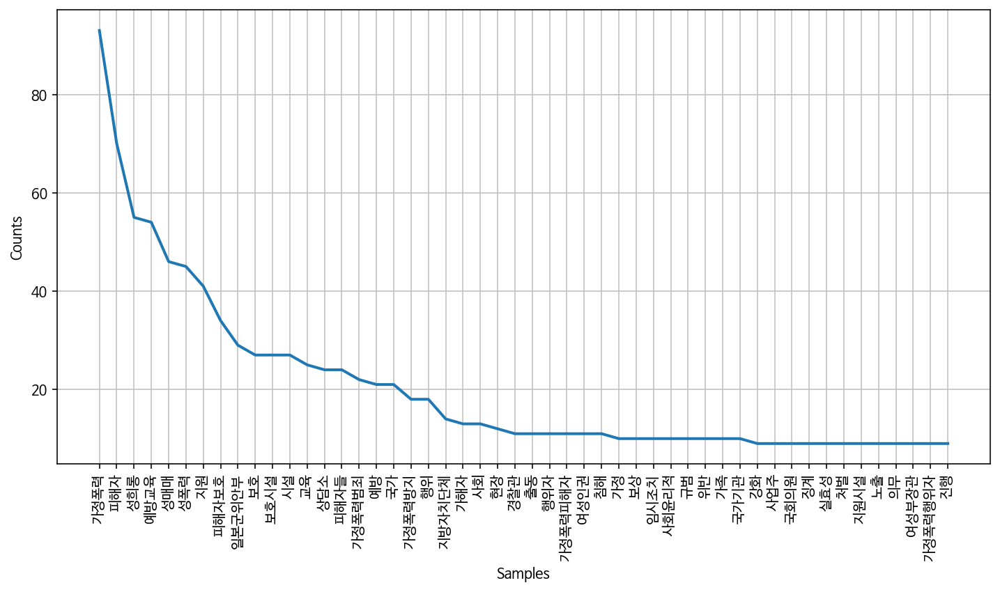

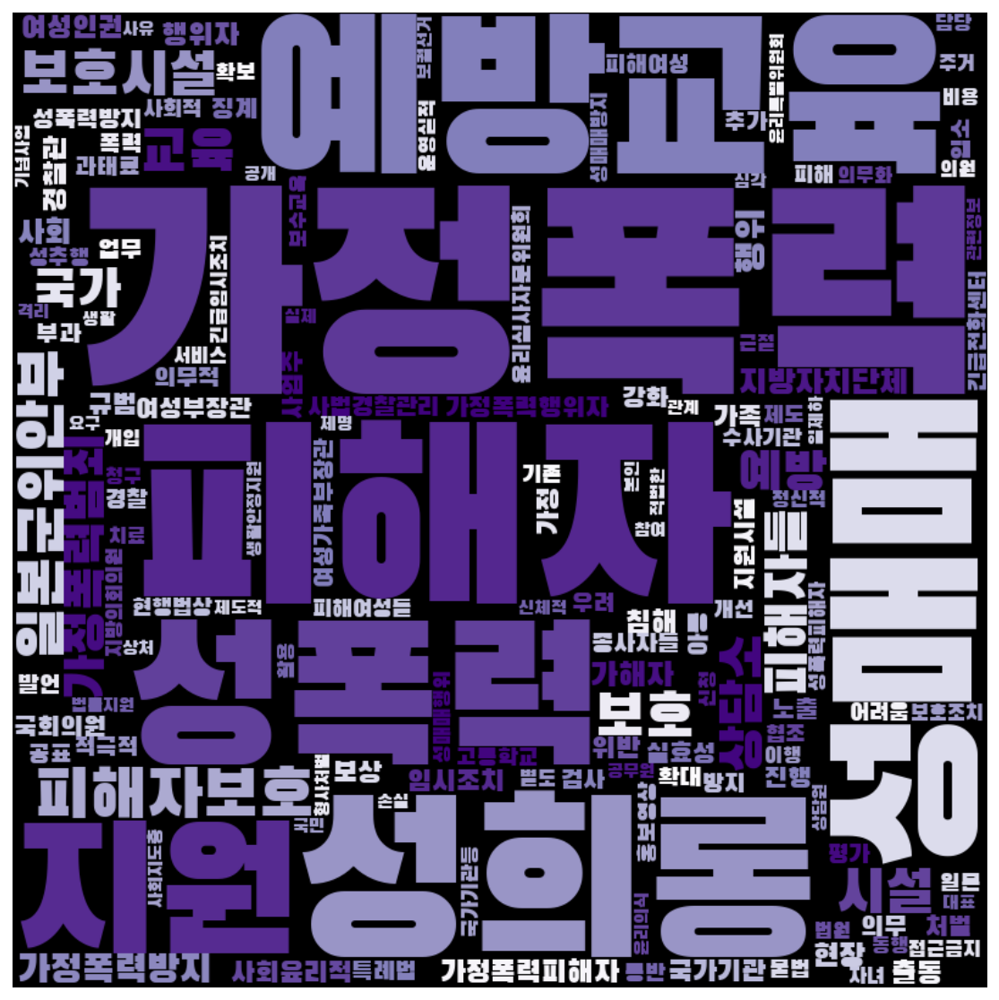

In [132]:
frewords_vis(women_g3_tokens)
wordcloud_vis(women_g3_tokens,'Accent')

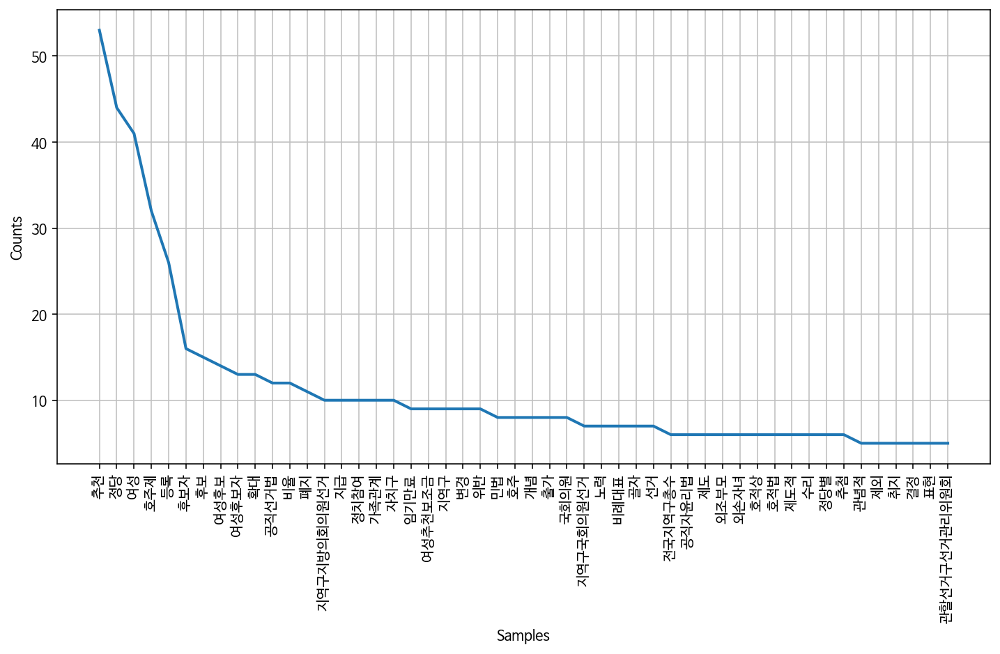

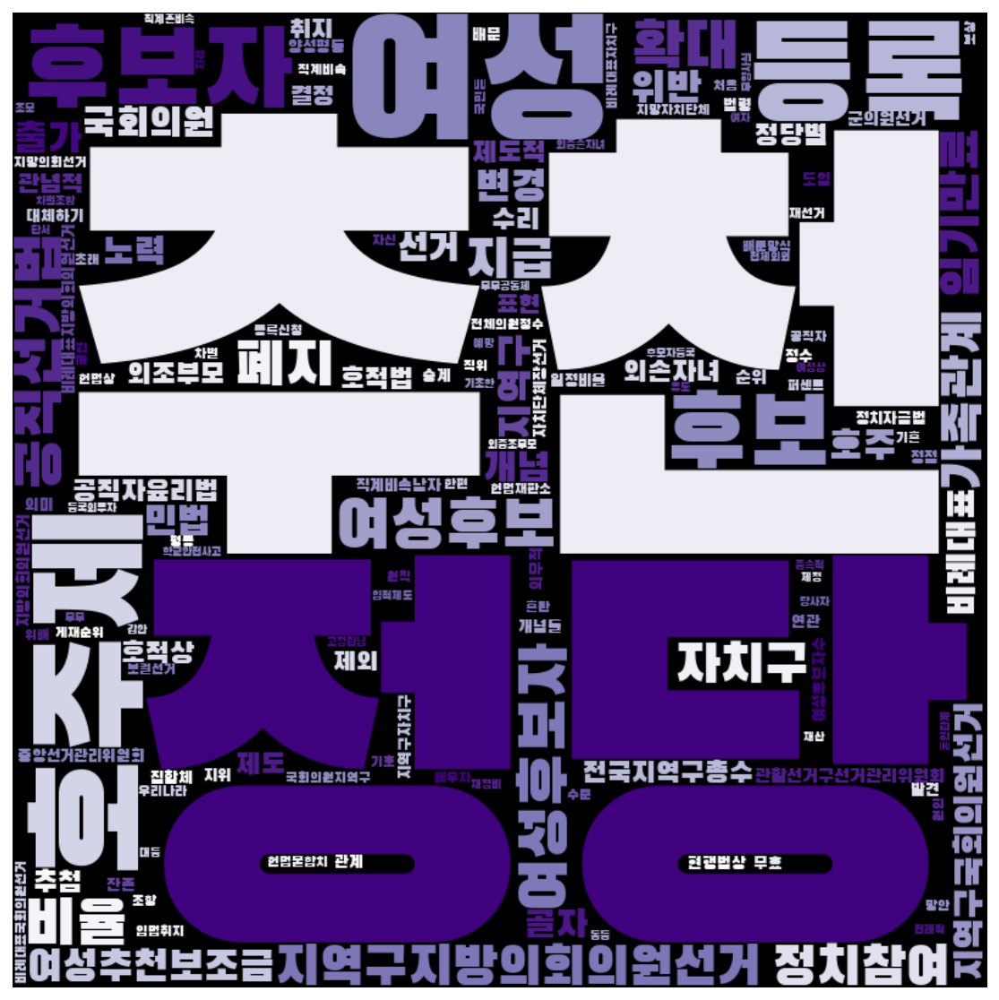

In [133]:
frewords_vis(women_g4_tokens)
wordcloud_vis(women_g4_tokens,'Accent')

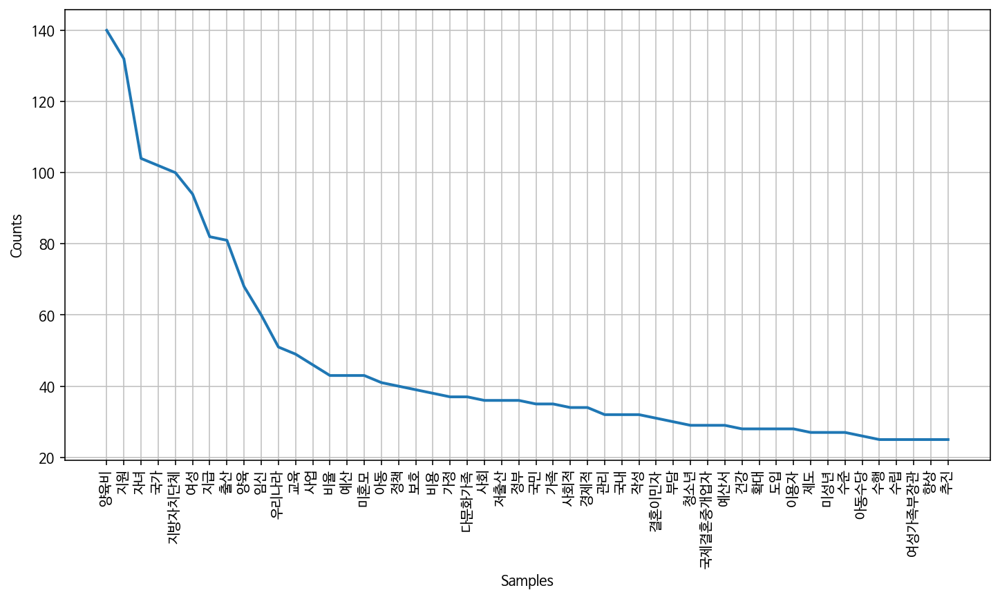

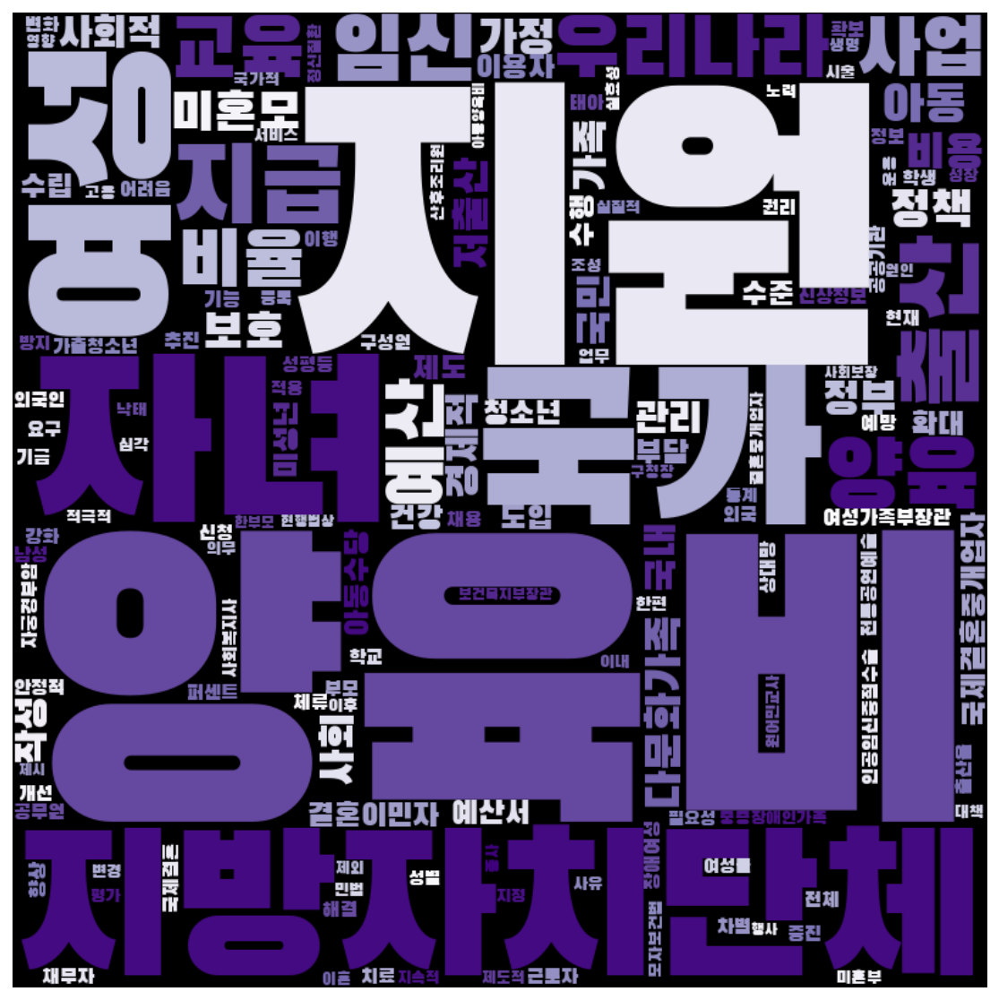

In [134]:
frewords_vis(women_g5_tokens)
wordcloud_vis(women_g5_tokens,'Accent')

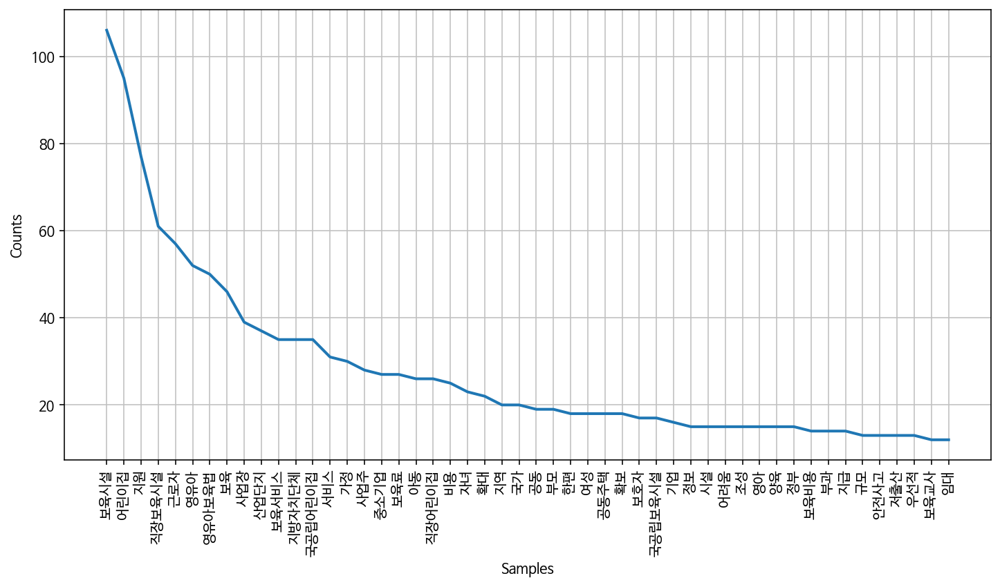

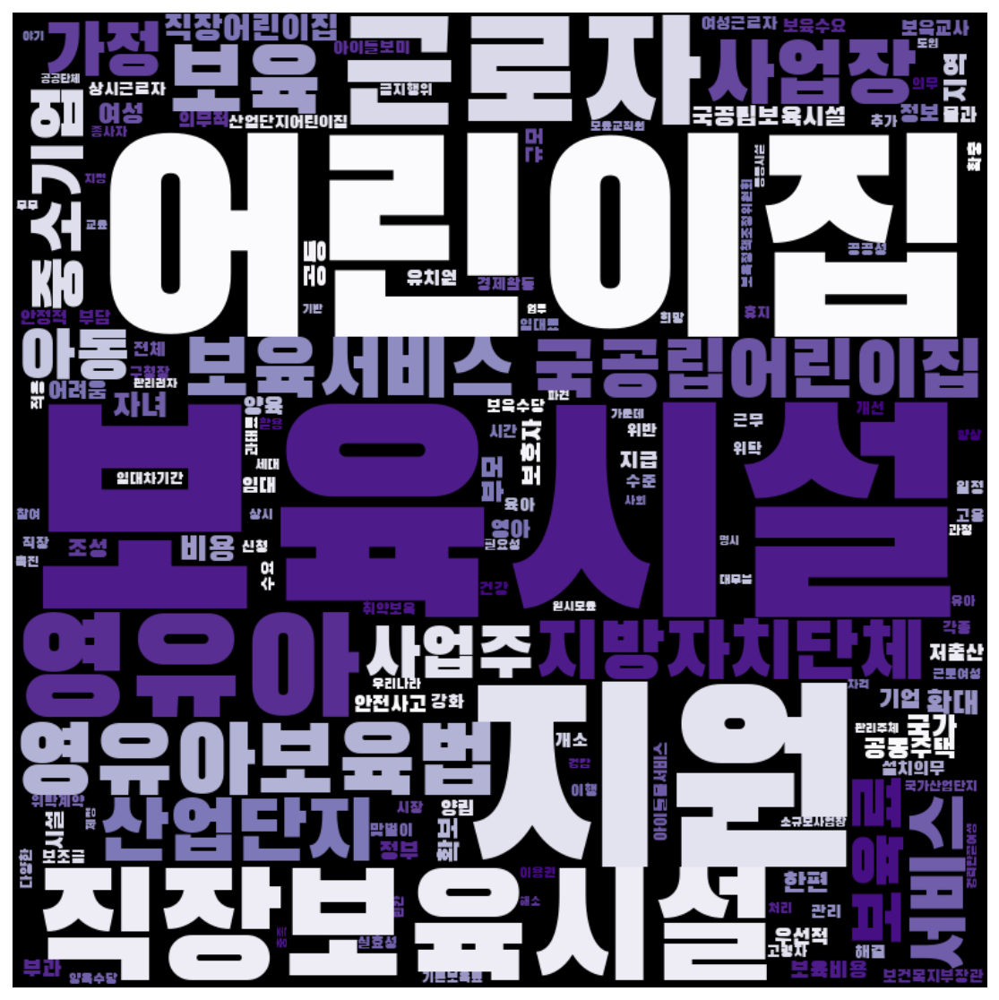

In [135]:
frewords_vis(women_g6_tokens)
wordcloud_vis(women_g6_tokens,'Accent')

엘보우: 100%|██████████| 14/14 [00:01<00:00, 10.72it/s]


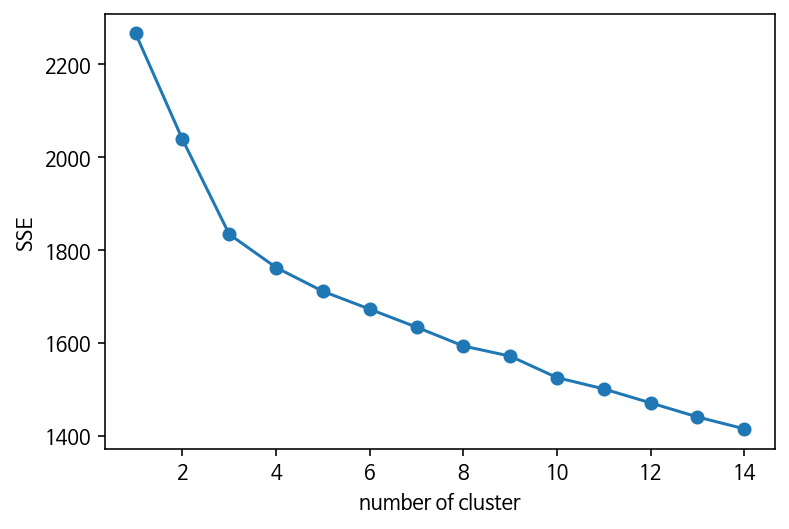

In [136]:
word_vectors_men = men['문장벡터'].to_list() # 함수에 넣을 X값 지정
elbow(word_vectors_men)

In [137]:
# K means 수행 
word_vectors_men = men['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_men)
men['category'] = idx

<ipython-input-137-ea17c2f5c726>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['category'] = idx


In [138]:
men['category'].value_counts()

0    210
1    169
2     84
3     55
5     44
4     28
Name: category, dtype: int64

In [139]:
men_g1 = men[men['category'] == 0]
men_g2 = men[men['category'] == 1]
men_g3 = men[men['category'] == 2]
men_g4 = men[men['category'] == 3]
men_g5 = men[men['category'] == 4]
men_g6 = men[men['category'] == 5]

In [140]:
men_g1_tokens = total_tokens(men_g1['tokens'])
men_g2_tokens = total_tokens(men_g2['tokens'])
men_g3_tokens = total_tokens(men_g3['tokens'])
men_g4_tokens = total_tokens(men_g4['tokens'])
men_g5_tokens = total_tokens(men_g5['tokens'])
men_g6_tokens = total_tokens(men_g6['tokens'])

In [141]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
men_g1_tokens = [each_word for each_word in men_g1_tokens if each_word not in stopwords]
men_g2_tokens = [each_word for each_word in men_g2_tokens if each_word not in stopwords]
men_g3_tokens = [each_word for each_word in men_g3_tokens if each_word not in stopwords]
men_g4_tokens = [each_word for each_word in men_g4_tokens if each_word not in stopwords]
men_g5_tokens = [each_word for each_word in men_g5_tokens if each_word not in stopwords]
men_g6_tokens = [each_word for each_word in men_g6_tokens if each_word not in stopwords]

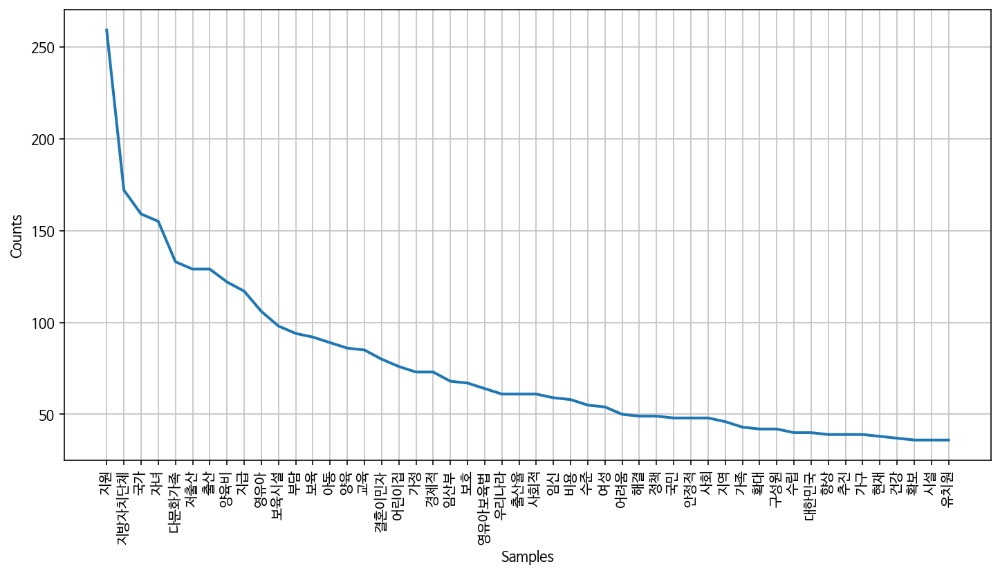

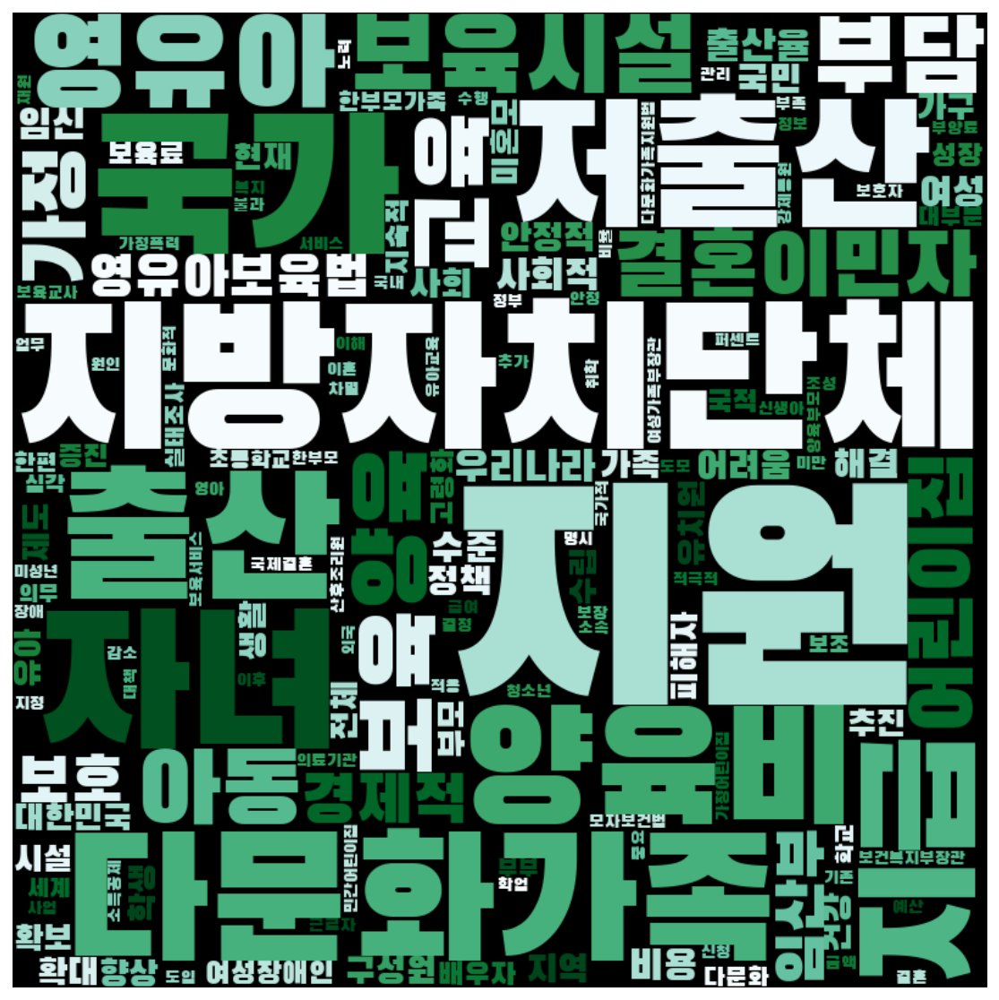

In [143]:
frewords_vis(men_g1_tokens)
wordcloud_vis(men_g1_tokens,'coolwarm')

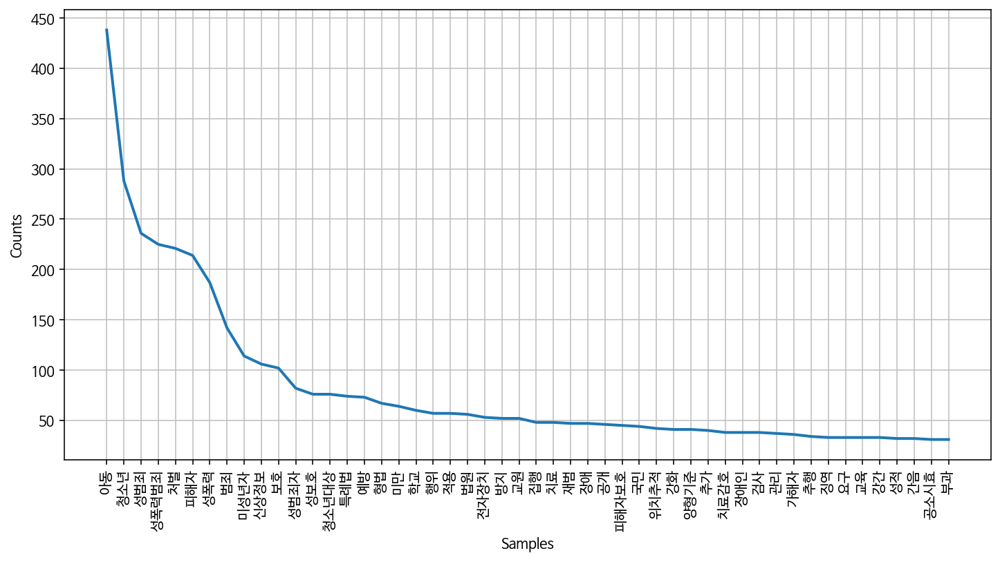

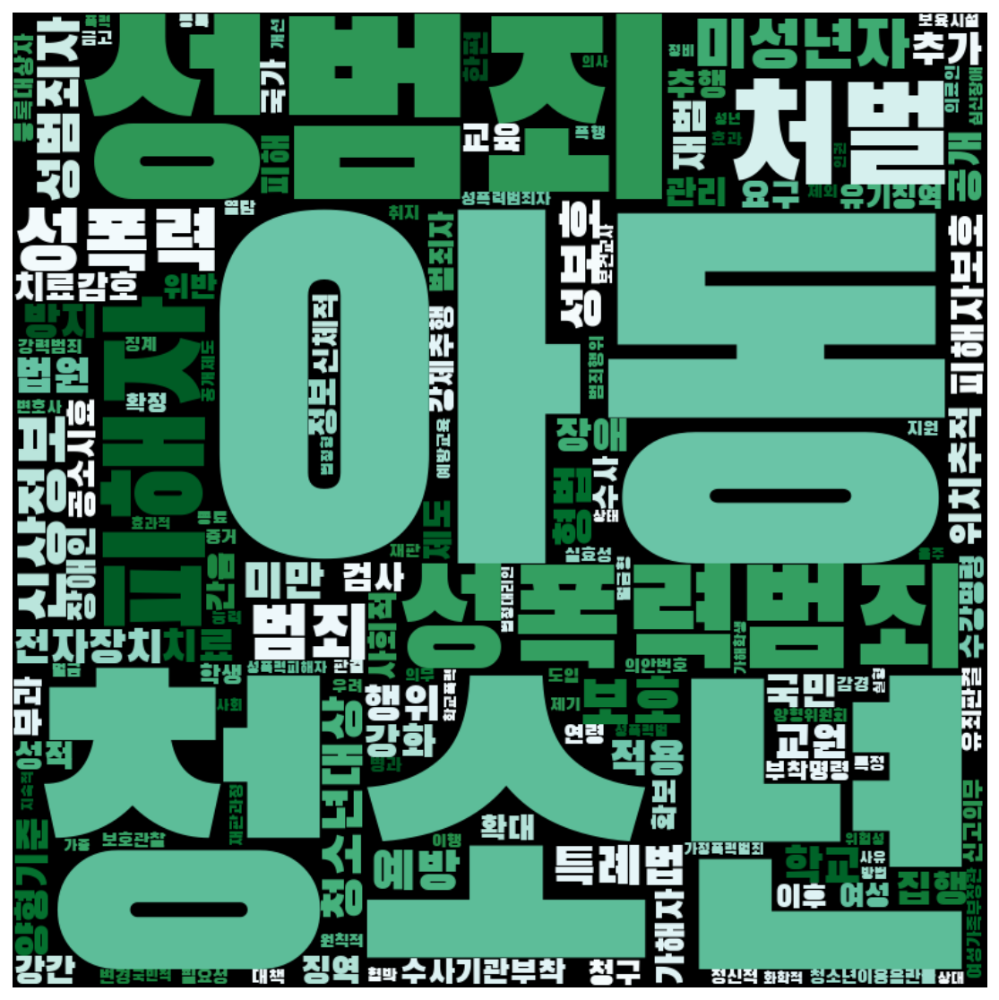

In [144]:
frewords_vis(men_g2_tokens)
wordcloud_vis(men_g2_tokens,'coolwarm')

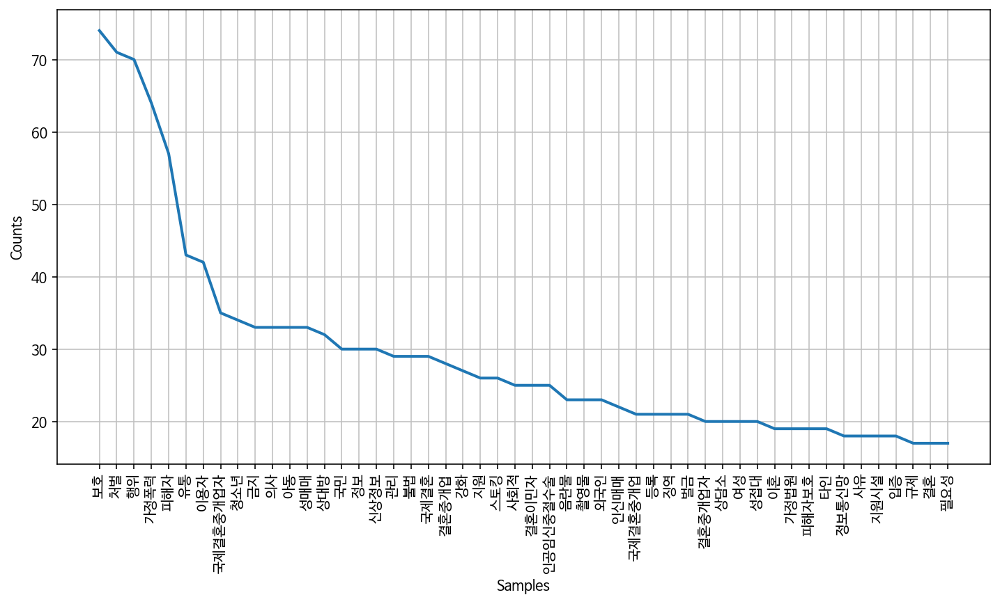

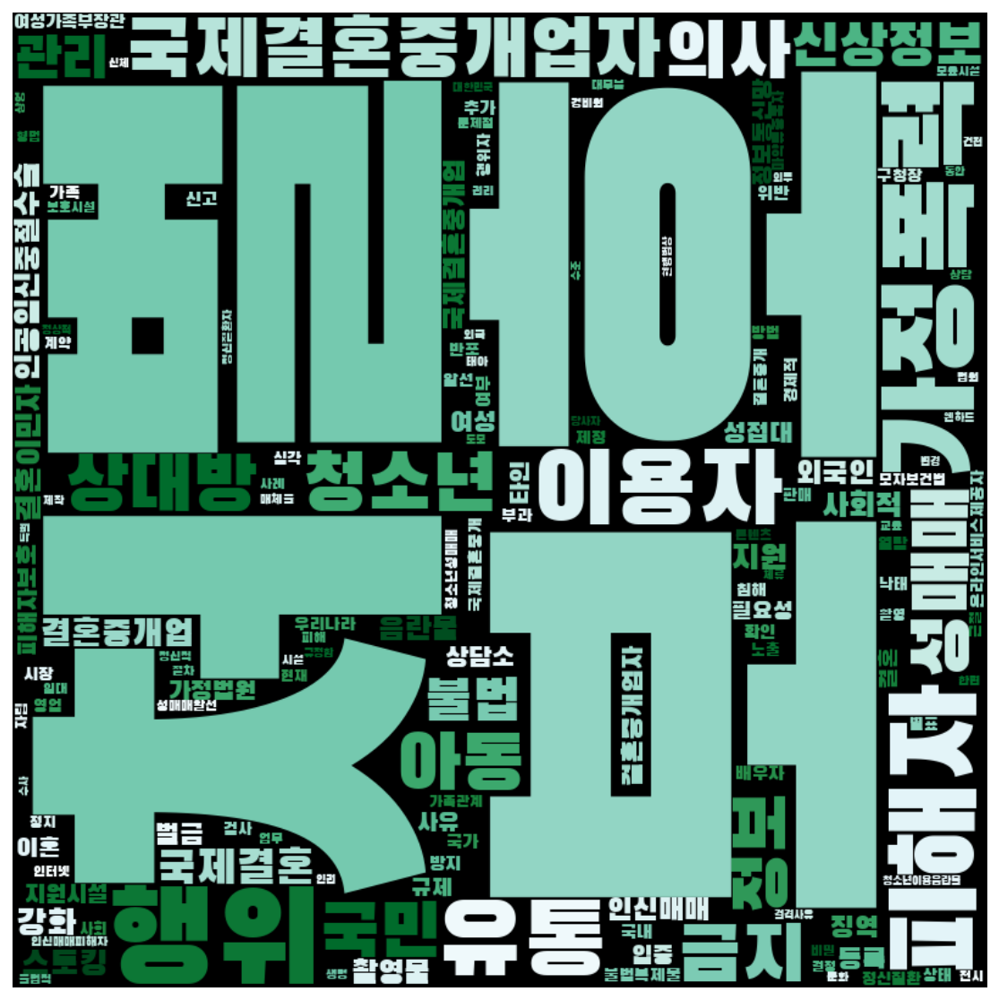

In [145]:
frewords_vis(men_g3_tokens)
wordcloud_vis(men_g3_tokens,'coolwarm')

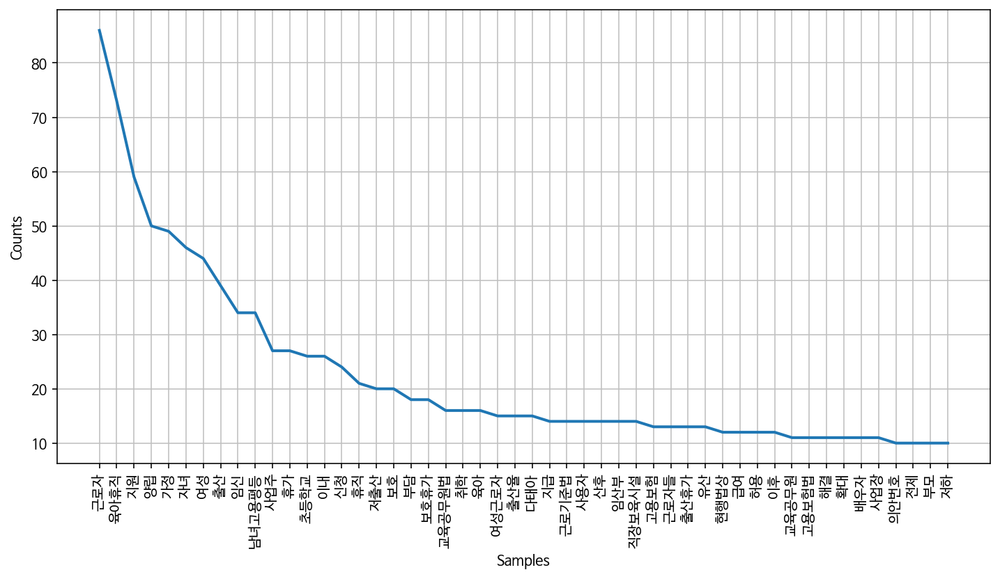

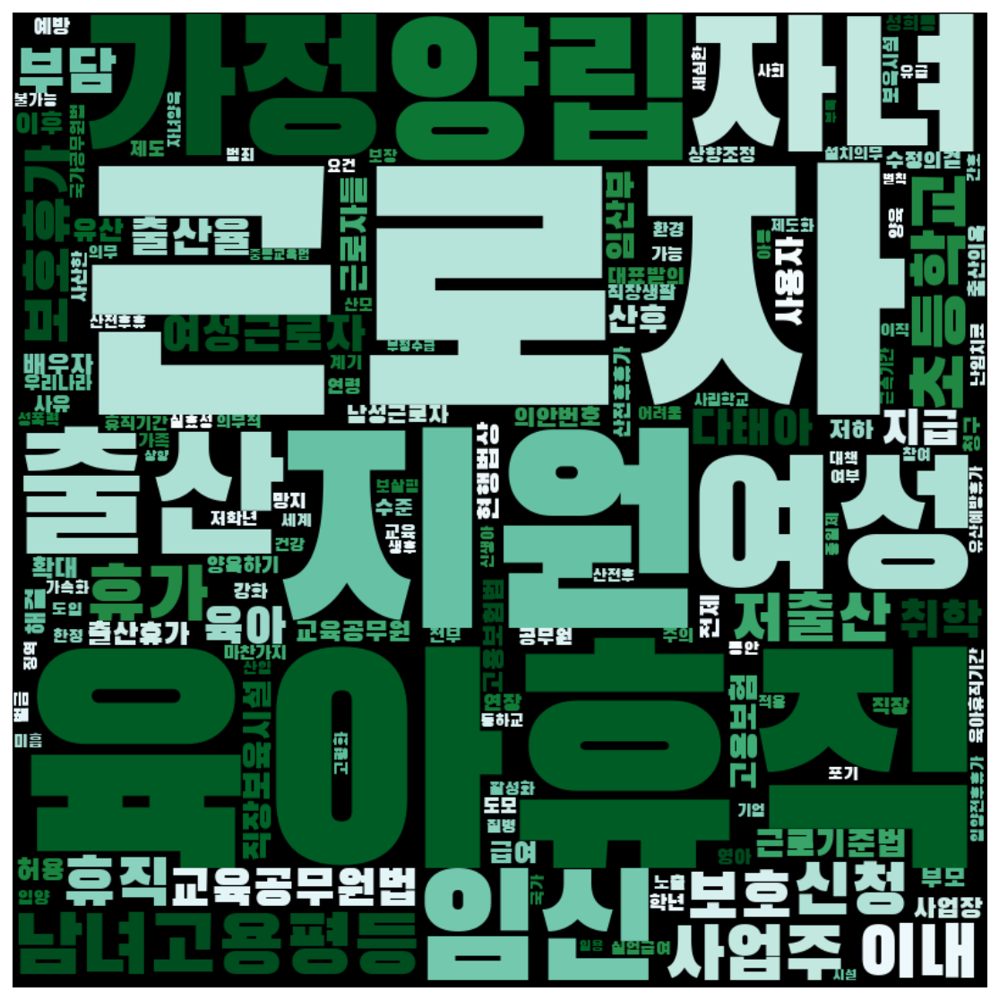

In [146]:
frewords_vis(men_g4_tokens)
wordcloud_vis(men_g4_tokens,'coolwarm')

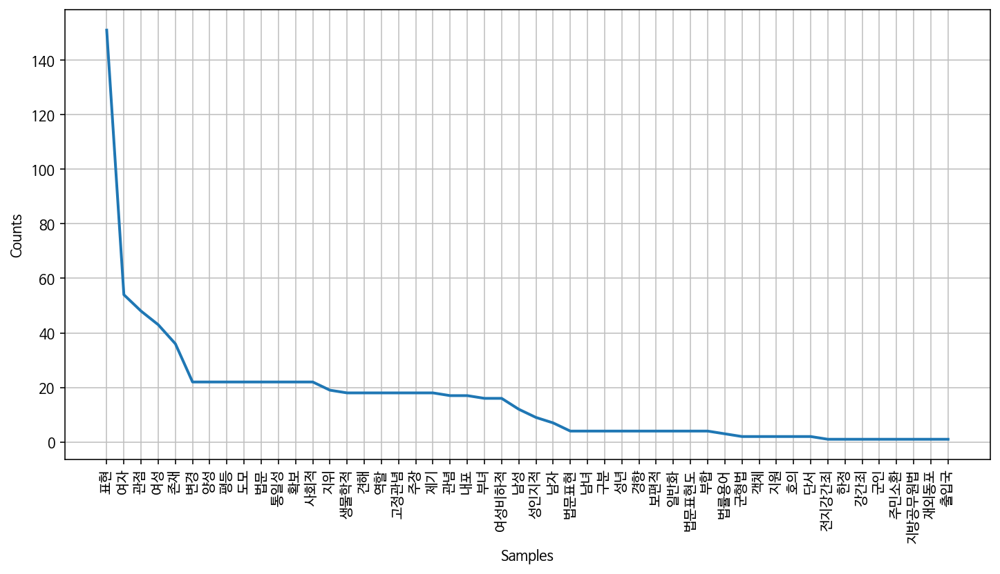

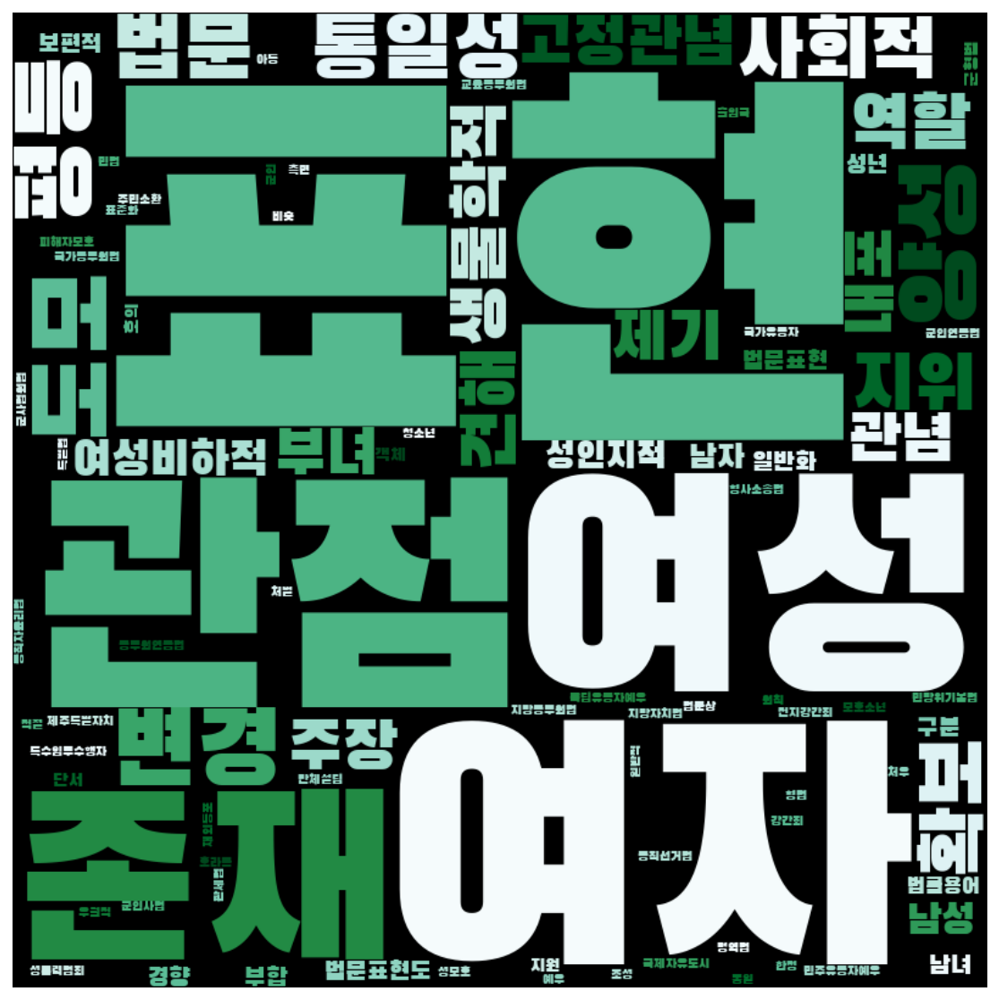

In [147]:
frewords_vis(men_g5_tokens)
wordcloud_vis(men_g5_tokens,'coolwarm')

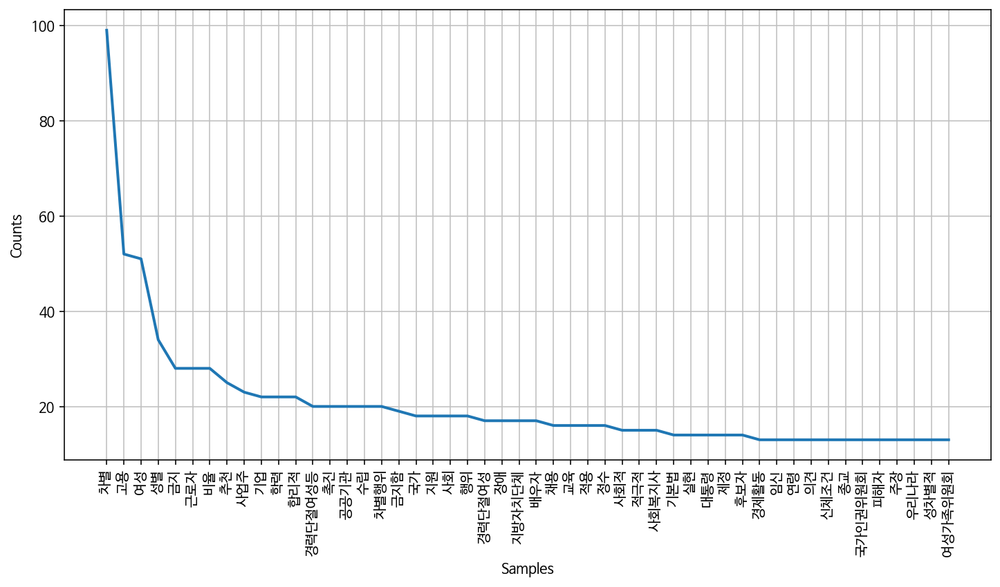

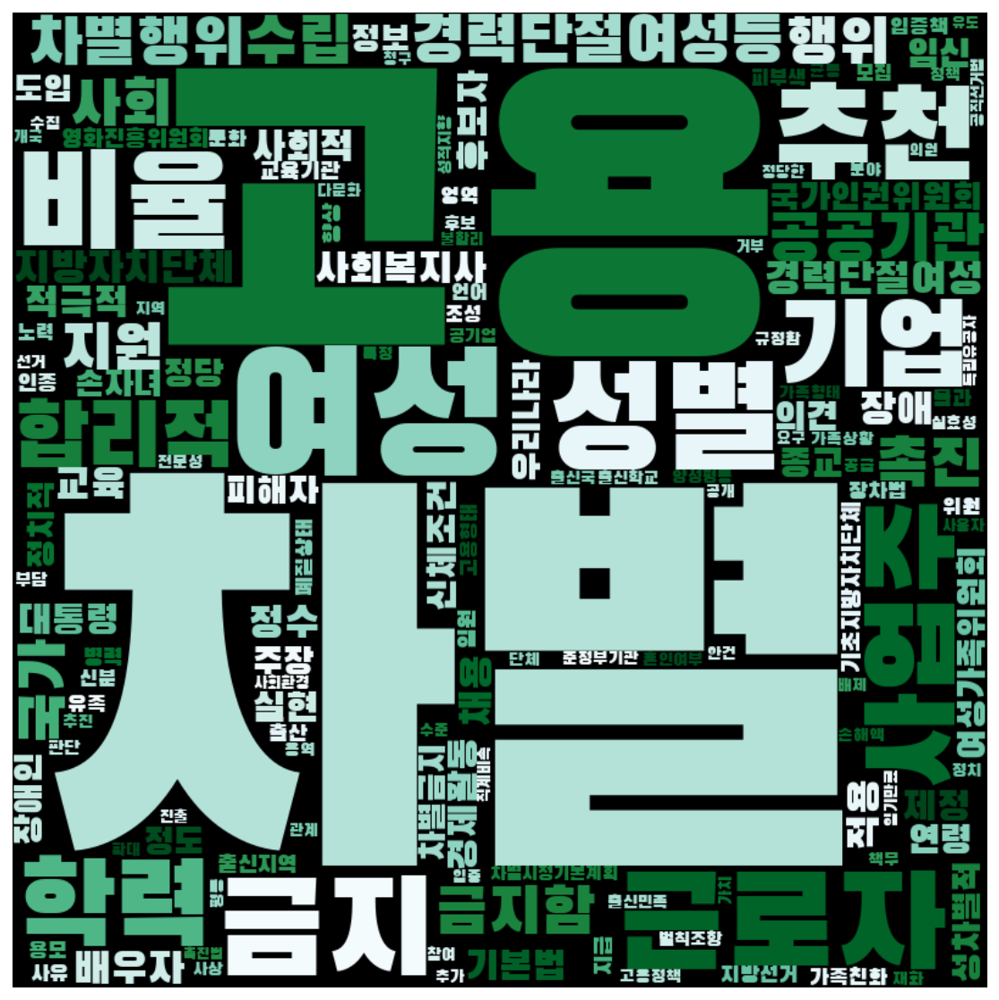

In [148]:
frewords_vis(men_g6_tokens)
wordcloud_vis(men_g6_tokens,'coolwarm')

## 박근혜 정권
- 2013.02.25 ~ 2017.03.13

In [149]:
parkkeunhye = gender[(gender['제안일자'] > datetime.date(2013,2,25)) & 
                        (gender['제안일자'] < datetime.date(2017,5,10))]
parkkeunhye.shape

(1121, 19)

In [150]:
parkkeunhye['성별'].value_counts()

남성    566
여성    456
Name: 성별, dtype: int64

In [151]:
pd.DataFrame(parkkeunhye.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  170
     여성  168
진보   남성  391
     여성  284

In [152]:
women = parkkeunhye[parkkeunhye['성별'] == '여성']
men = parkkeunhye[parkkeunhye['성별'] == '남성']

In [153]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:52:12,014 : INFO : collecting all words and their counts
2020-10-20 14:52:12,015 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:52:12,027 : INFO : collected 5974 word types from a corpus of 35491 raw words and 456 sentences
2020-10-20 14:52:12,028 : INFO : Loading a fresh vocabulary
2020-10-20 14:52:12,034 : INFO : effective_min_count=10 retains 731 unique words (12% of original 5974, drops 5243)
2020-10-20 14:52:12,035 : INFO : effective_min_count=10 leaves 23353 word corpus (65% of original 35491, drops 12138)
2020-10-20 14:52:12,038 : INFO : deleting the raw counts dictionary of 5974 items
2020-10-20 14:52:12,040 : INFO : sample=0.001 downsamples 72 most-common words
2020-10-20 14:52:12,041 : INFO : downsampling leaves estimated 19573 word corpus (83.8% of prior 23353)
2020-10-20 14:52:12,044 : INFO : estimated required memory for 731 words and 100 dimensions: 950300 bytes
2020-10-20 14:52:12,045 : INFO : resetting layer weight

2020-10-20 14:52:13,421 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:13,427 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:13,431 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:13,432 : INFO : EPOCH - 15 : training on 35491 raw words (19510 effective words) took 0.1s, 269603 effective words/s
2020-10-20 14:52:13,487 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:13,494 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:13,504 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:13,508 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:13,509 : INFO : EPOCH - 16 : training on 35491 raw words (19612 effective words) took 0.1s, 274794 effective words/s
2020-10-20 14:52:13,562 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:52:14,697 : INFO : EPOCH - 31 : training on 35491 raw words (19550 effective words) took 0.1s, 340544 effective words/s
2020-10-20 14:52:14,744 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:14,763 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:14,767 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:14,768 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:14,770 : INFO : EPOCH - 32 : training on 35491 raw words (19621 effective words) took 0.1s, 294365 effective words/s
2020-10-20 14:52:14,825 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:14,841 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:14,842 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:14,846 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:52:15,946 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:15,954 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:15,958 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:15,959 : INFO : EPOCH - 48 : training on 35491 raw words (19636 effective words) took 0.1s, 287349 effective words/s
2020-10-20 14:52:16,009 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:16,023 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:16,030 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:16,035 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:16,035 : INFO : EPOCH - 49 : training on 35491 raw words (19563 effective words) took 0.1s, 271497 effective words/s
2020-10-20 14:52:16,086 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:52:17,124 : INFO : EPOCH - 64 : training on 35491 raw words (19620 effective words) took 0.1s, 367734 effective words/s
2020-10-20 14:52:17,168 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:17,180 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:17,189 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:17,191 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:17,193 : INFO : EPOCH - 65 : training on 35491 raw words (19548 effective words) took 0.1s, 313657 effective words/s
2020-10-20 14:52:17,242 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:17,252 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:17,261 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:17,262 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:52:18,349 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:18,360 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:18,361 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:18,362 : INFO : EPOCH - 81 : training on 35491 raw words (19591 effective words) took 0.1s, 275339 effective words/s
2020-10-20 14:52:18,416 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:18,417 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:18,430 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:18,434 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:18,435 : INFO : EPOCH - 82 : training on 35491 raw words (19570 effective words) took 0.1s, 284313 effective words/s
2020-10-20 14:52:18,485 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:52:19,529 : INFO : EPOCH - 97 : training on 35491 raw words (19575 effective words) took 0.1s, 319380 effective words/s
2020-10-20 14:52:19,578 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:19,592 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:19,597 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:19,599 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:19,599 : INFO : EPOCH - 98 : training on 35491 raw words (19621 effective words) took 0.1s, 303974 effective words/s
2020-10-20 14:52:19,646 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:19,662 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:19,671 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:19,673 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:52:20,968 : INFO : EPOCH - 11 : training on 37980 raw words (21524 effective words) took 0.1s, 264396 effective words/s
2020-10-20 14:52:21,033 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:21,040 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:21,045 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:21,051 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:21,051 : INFO : EPOCH - 12 : training on 37980 raw words (21476 effective words) took 0.1s, 275950 effective words/s
2020-10-20 14:52:21,119 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:21,124 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:21,127 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:21,135 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:52:22,371 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:22,376 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:22,379 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:22,380 : INFO : EPOCH - 28 : training on 37980 raw words (21459 effective words) took 0.1s, 293834 effective words/s
2020-10-20 14:52:22,439 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:22,453 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:22,455 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:22,462 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:22,463 : INFO : EPOCH - 29 : training on 37980 raw words (21477 effective words) took 0.1s, 277442 effective words/s
2020-10-20 14:52:22,523 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:52:23,639 : INFO : EPOCH - 44 : training on 37980 raw words (21603 effective words) took 0.1s, 299794 effective words/s
2020-10-20 14:52:23,696 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:23,706 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:23,708 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:23,713 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:23,715 : INFO : EPOCH - 45 : training on 37980 raw words (21518 effective words) took 0.1s, 294088 effective words/s
2020-10-20 14:52:23,785 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:23,794 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:23,805 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:23,806 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:52:25,043 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:25,044 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:25,045 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:25,046 : INFO : EPOCH - 61 : training on 37980 raw words (21518 effective words) took 0.1s, 267075 effective words/s
2020-10-20 14:52:25,107 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:25,118 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:25,122 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:25,127 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:25,128 : INFO : EPOCH - 62 : training on 37980 raw words (21497 effective words) took 0.1s, 280192 effective words/s
2020-10-20 14:52:25,188 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:52:26,285 : INFO : EPOCH - 77 : training on 37980 raw words (21507 effective words) took 0.1s, 293839 effective words/s
2020-10-20 14:52:26,356 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:26,359 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:26,362 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:26,365 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:26,367 : INFO : EPOCH - 78 : training on 37980 raw words (21508 effective words) took 0.1s, 278944 effective words/s
2020-10-20 14:52:26,427 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:26,435 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:26,437 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:26,446 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:52:27,620 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:27,626 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:27,636 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:27,638 : INFO : EPOCH - 94 : training on 37980 raw words (21551 effective words) took 0.1s, 295469 effective words/s
2020-10-20 14:52:27,704 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:52:27,706 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:52:27,708 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:52:27,711 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:52:27,712 : INFO : EPOCH - 95 : training on 37980 raw words (21545 effective words) took 0.1s, 310961 effective words/s
2020-10-20 14:52:27,773 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [154]:
print(model_women.wv.most_similar('여성'))

2020-10-20 14:52:28,112 : INFO : precomputing L2-norms of word weight vectors


[('정치참여', 0.5555772185325623), ('실현', 0.512667179107666), ('경제활동', 0.48192498087882996), ('지역구', 0.4796178936958313), ('촉진', 0.47735005617141724), ('정치', 0.47644364833831787), ('경력단절여성등', 0.4758952856063843), ('지역구지방의회의원선거', 0.47333624958992004), ('남성', 0.4725733995437622), ('자치구', 0.4599530100822449)]


In [155]:
print(model_men.wv.most_similar('여성'))

2020-10-20 14:52:28,122 : INFO : precomputing L2-norms of word weight vectors


[('경력단절', 0.48907849192619324), ('기혼여성', 0.4675139784812927), ('경제활동', 0.4663518965244293), ('재고용', 0.4377736449241638), ('사회적', 0.40400832891464233), ('현상', 0.3948157727718353), ('문제해결', 0.3916071951389313), ('남성', 0.38851654529571533), ('통상임금', 0.38534778356552124), ('고용률', 0.3829236626625061)]


In [156]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [157]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

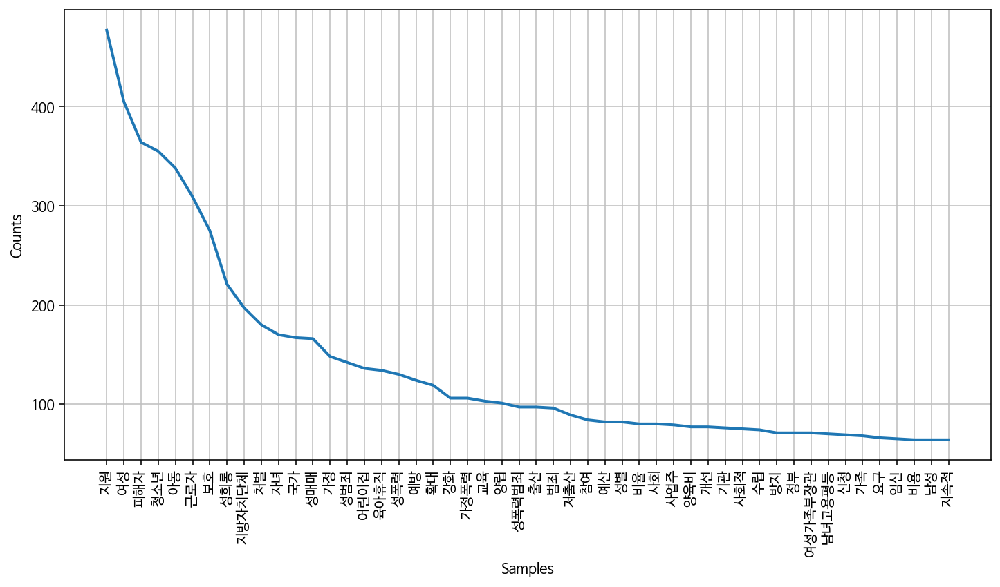

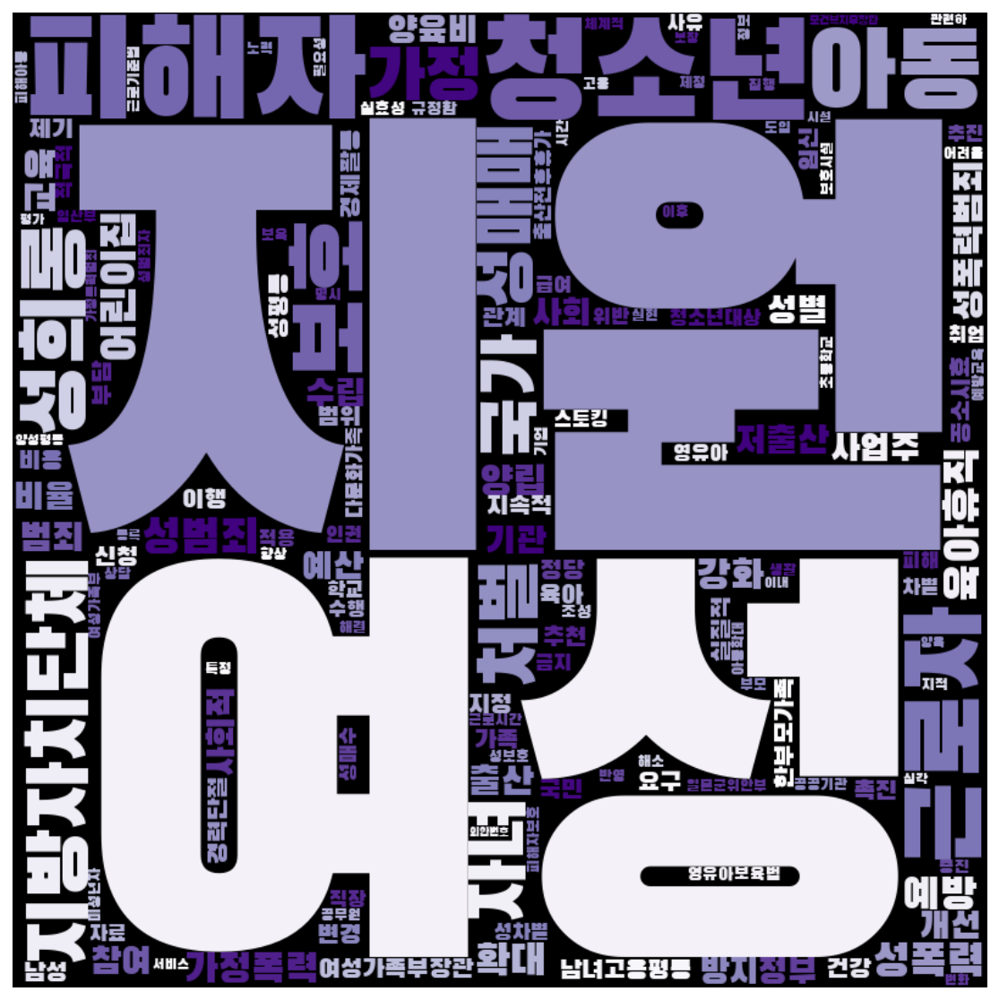

In [158]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

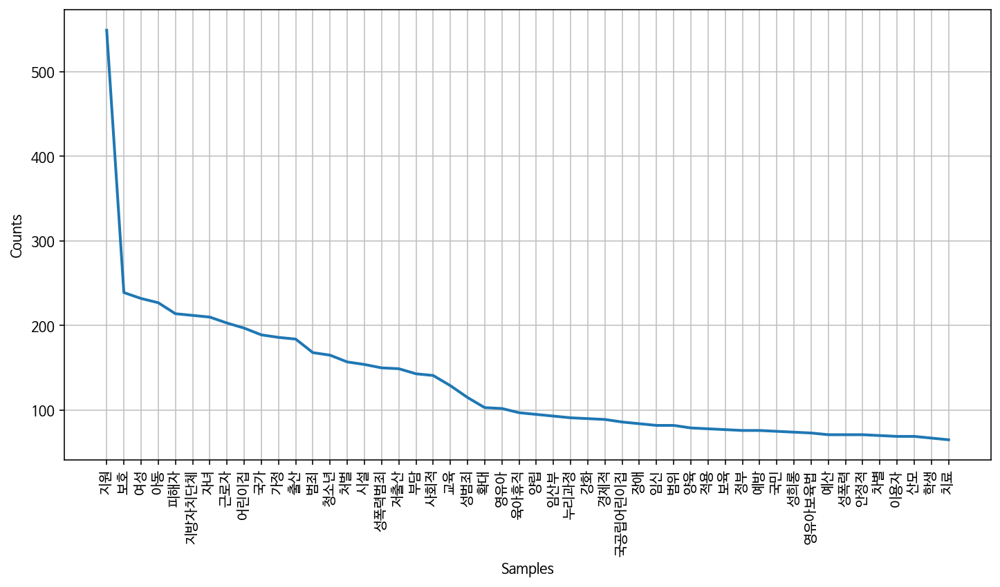

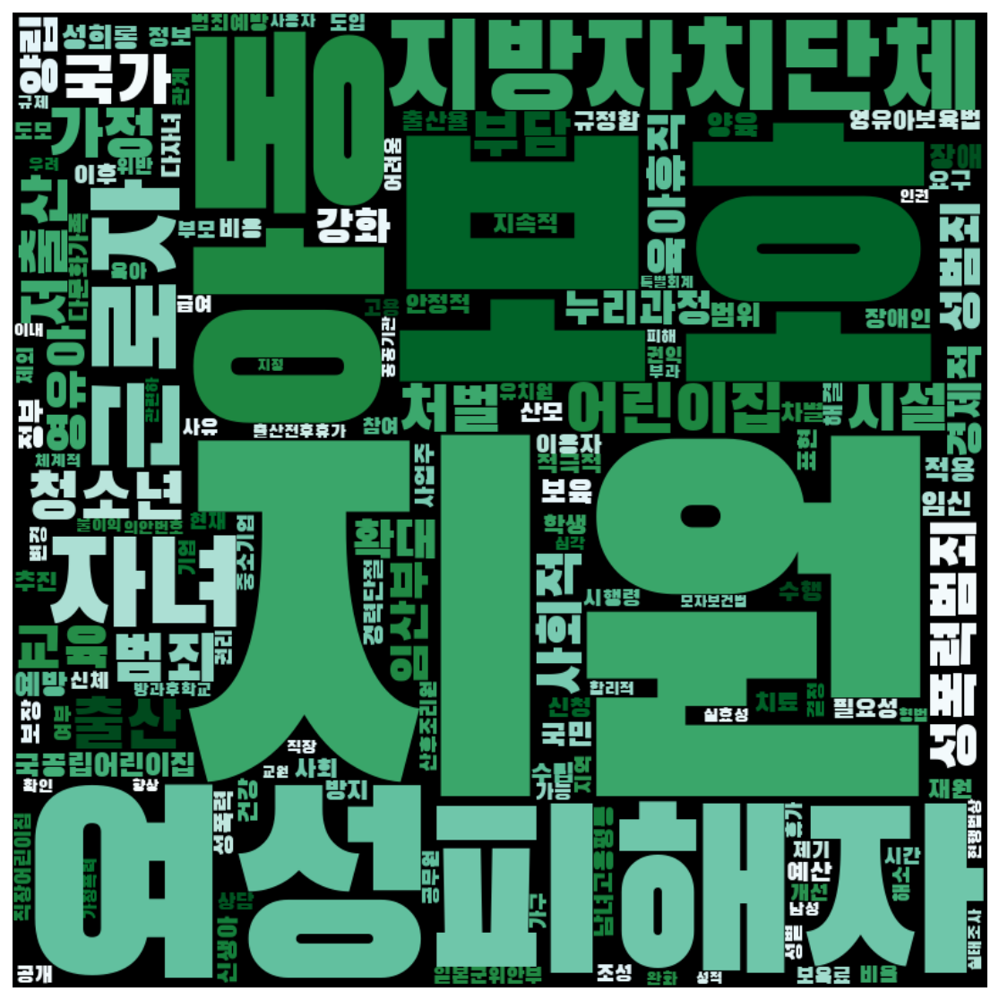

In [161]:
frewords_vis(men_word)
wordcloud_vis(men_word, 'coolwarm')

In [162]:
women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))

<ipython-input-162-87b19f55aed6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
<ipython-input-162-87b19f55aed6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))


In [163]:
# K means 수행 
word_vectors_women = women['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_women)
women['category'] = idx

<ipython-input-163-758a1e279dd2>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['category'] = idx


In [164]:
women['category'].value_counts()

2    125
3    100
5     86
4     67
0     62
1     16
Name: category, dtype: int64

In [165]:
women_g1 = women[women['category'] == 0]
women_g2 = women[women['category'] == 1]
women_g3 = women[women['category'] == 2]
women_g4 = women[women['category'] == 3]
women_g5 = women[women['category'] == 4]
women_g6 = women[women['category'] == 5]

In [166]:
women_g1_tokens = total_tokens(women_g1['tokens'])
women_g2_tokens = total_tokens(women_g2['tokens'])
women_g3_tokens = total_tokens(women_g3['tokens'])
women_g4_tokens = total_tokens(women_g4['tokens'])
women_g5_tokens = total_tokens(women_g5['tokens'])
women_g6_tokens = total_tokens(women_g6['tokens'])

In [167]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
women_g1_tokens = [each_word for each_word in women_g1_tokens if each_word not in stopwords]
women_g2_tokens = [each_word for each_word in women_g2_tokens if each_word not in stopwords]
women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

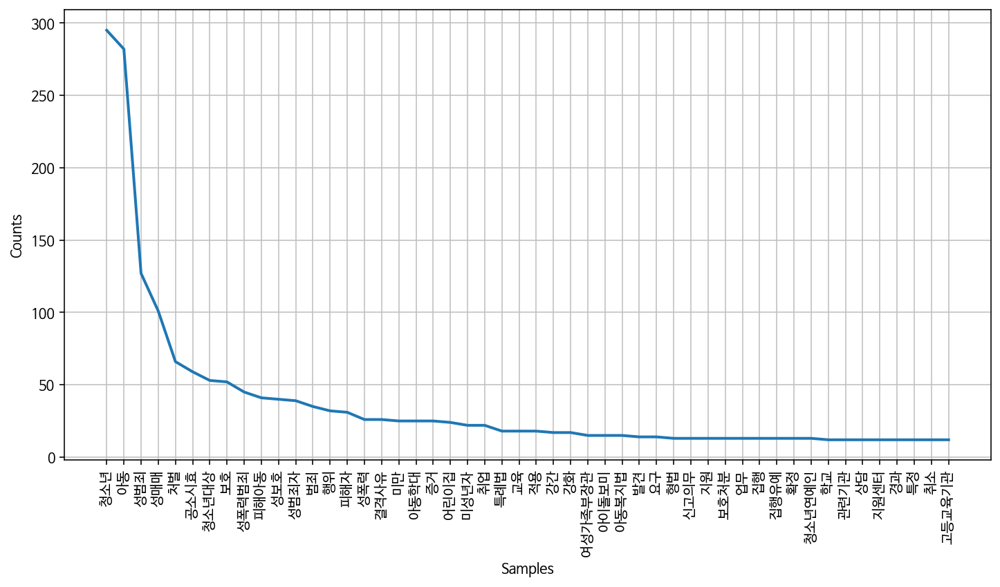

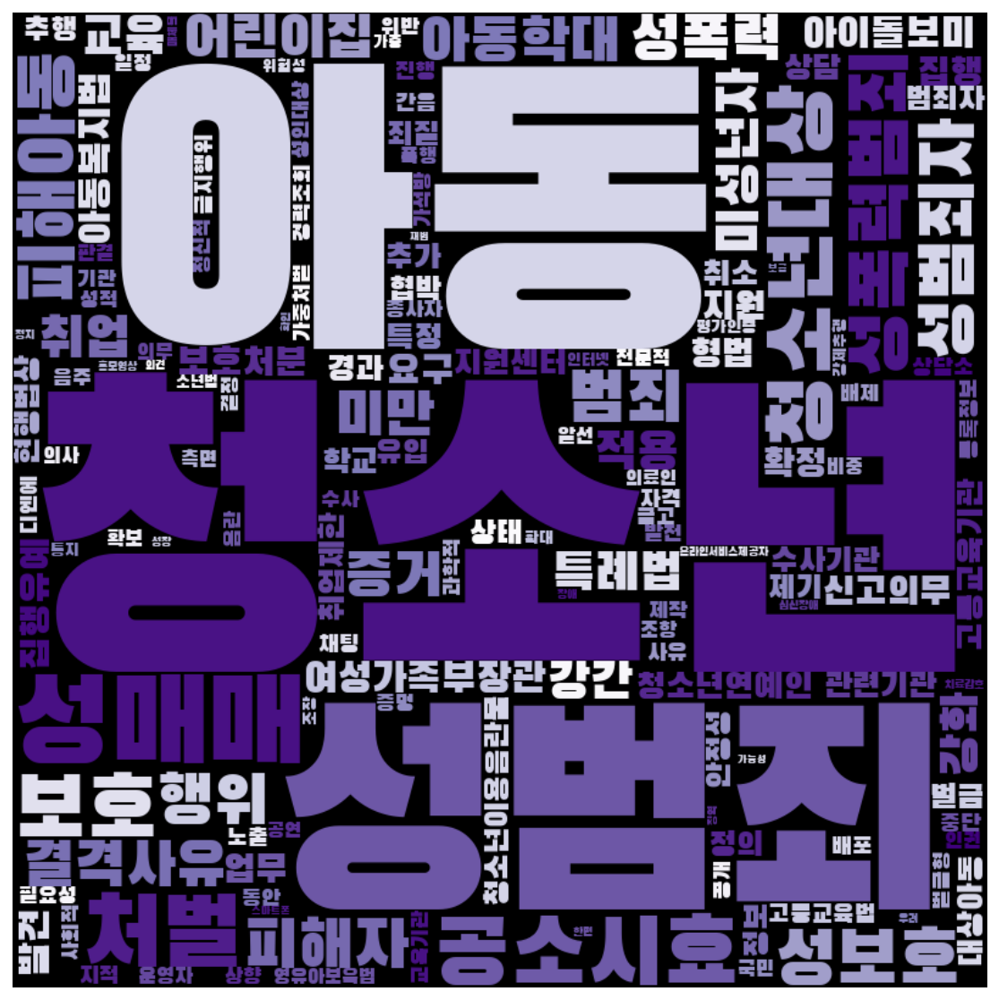

In [168]:
frewords_vis(women_g1_tokens)
wordcloud_vis(women_g1_tokens, 'Accent')

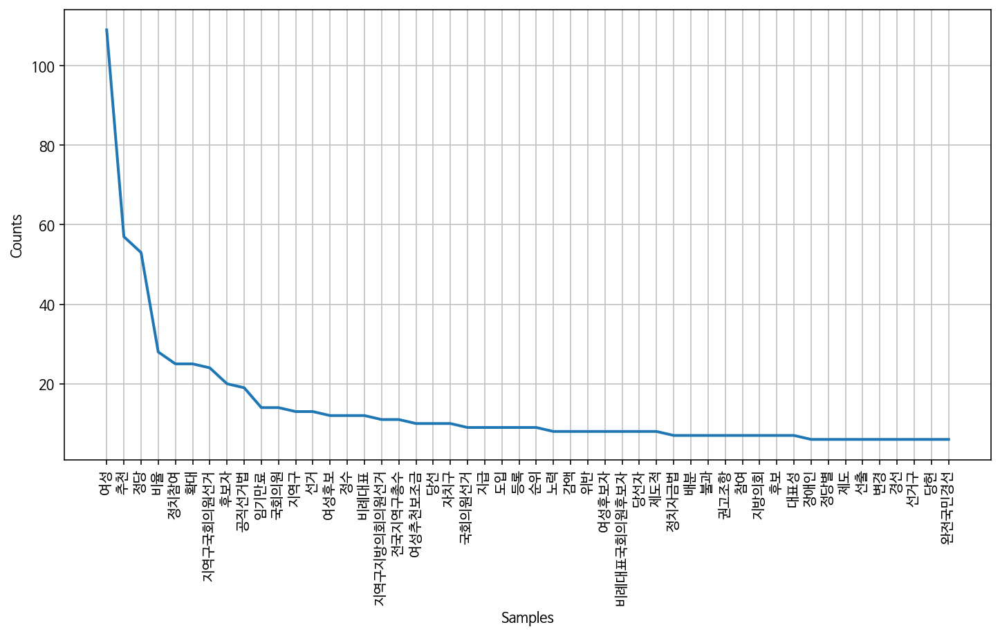

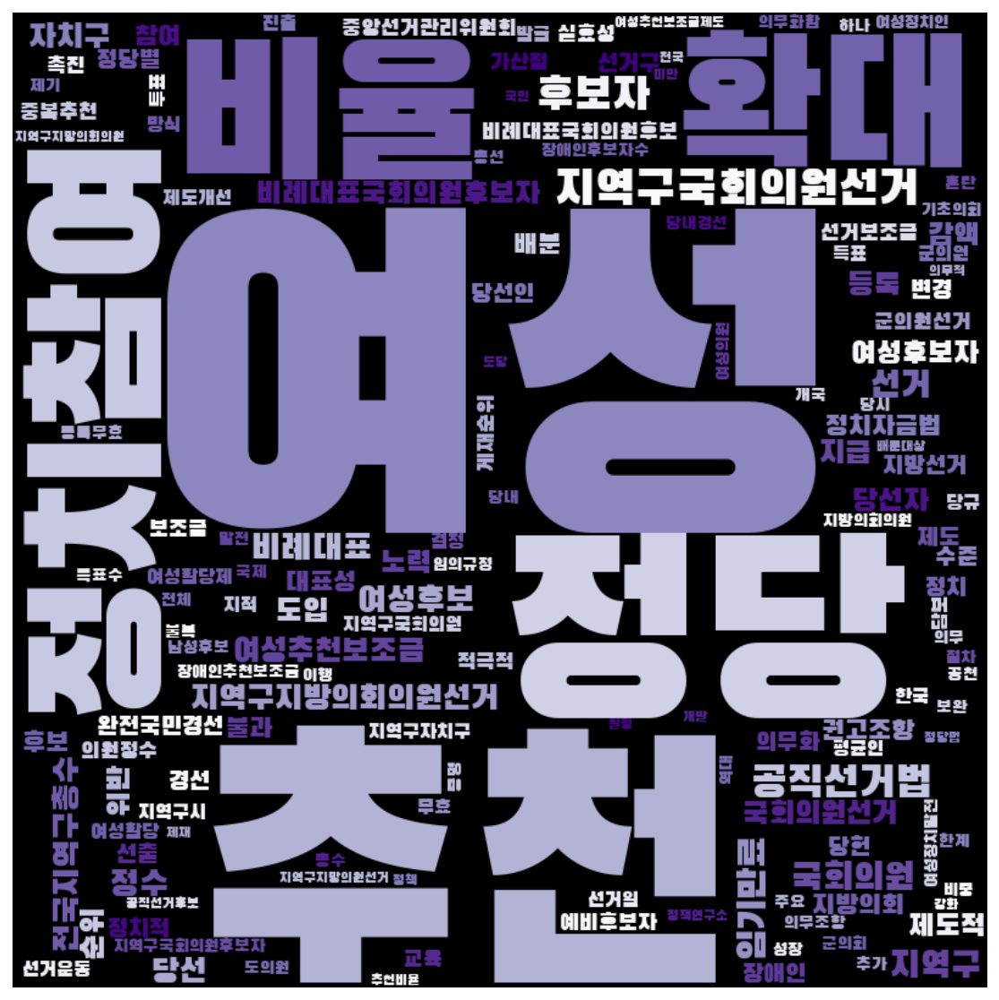

In [169]:
frewords_vis(women_g2_tokens)
wordcloud_vis(women_g2_tokens, 'Accent')

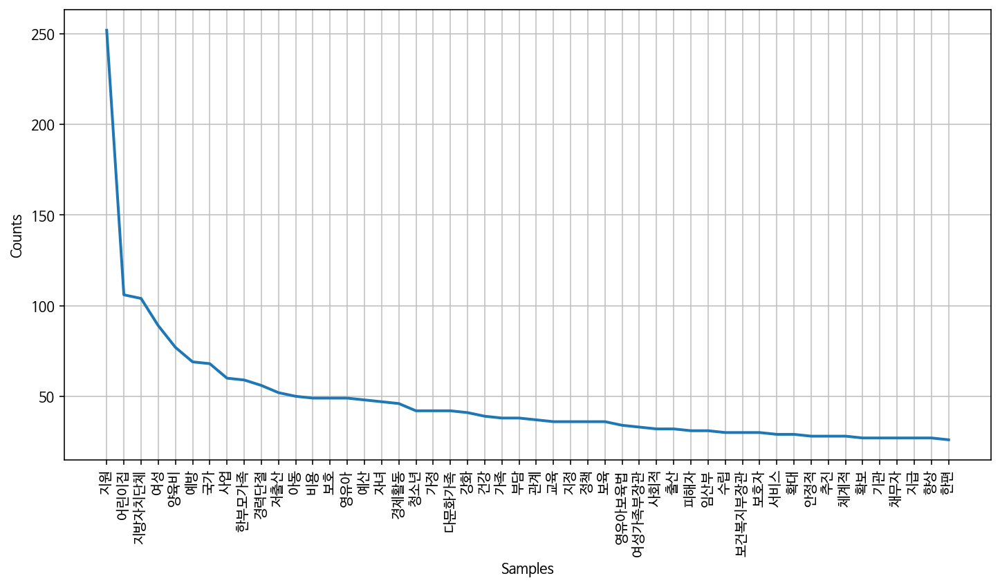

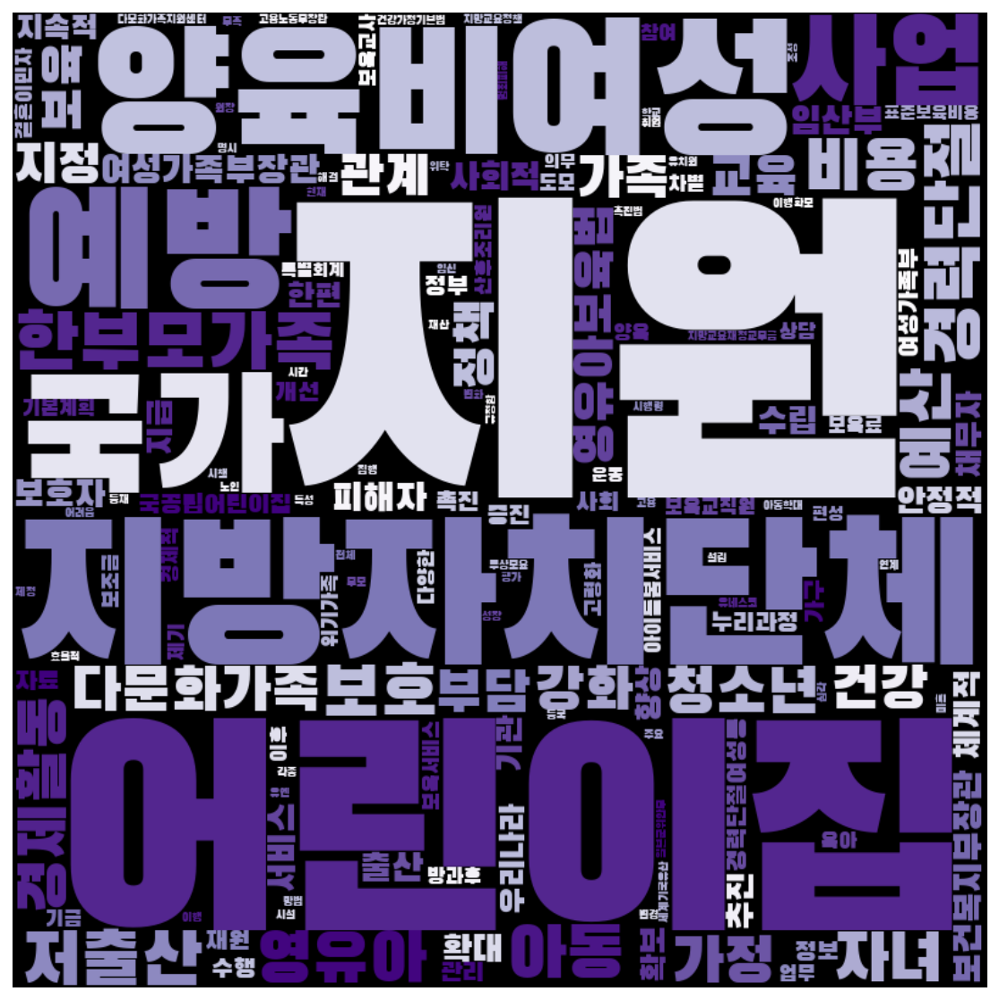

In [170]:
frewords_vis(women_g3_tokens)
wordcloud_vis(women_g3_tokens,'Accent')

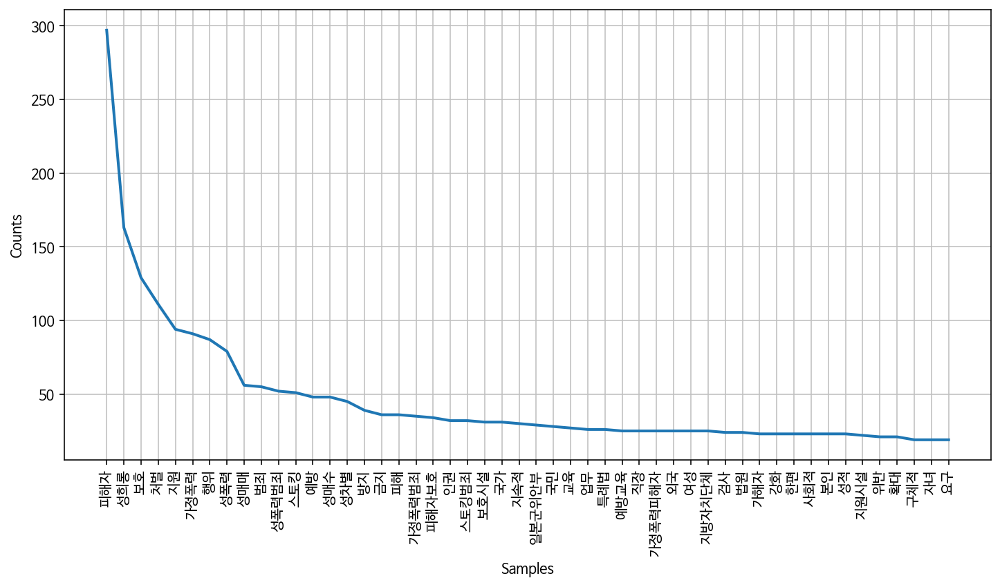

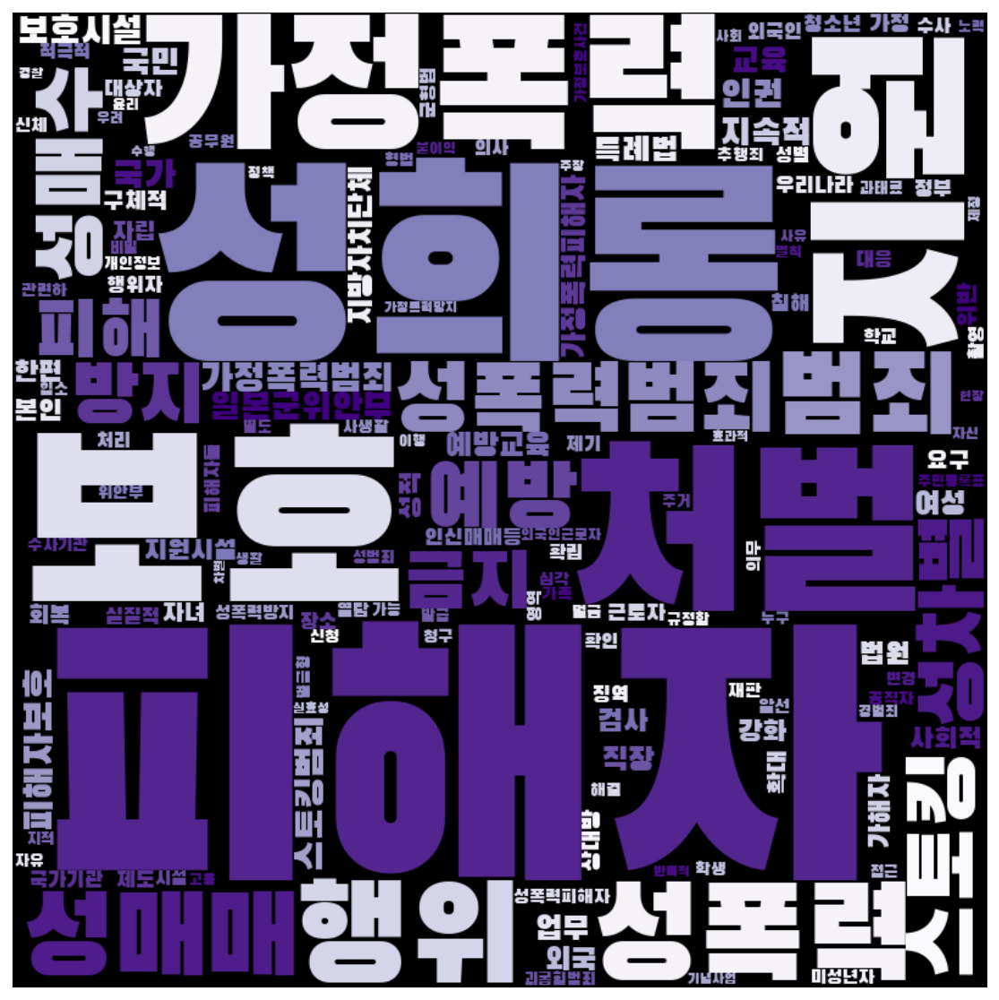

In [171]:
frewords_vis(women_g4_tokens)
wordcloud_vis(women_g4_tokens,'Accent')

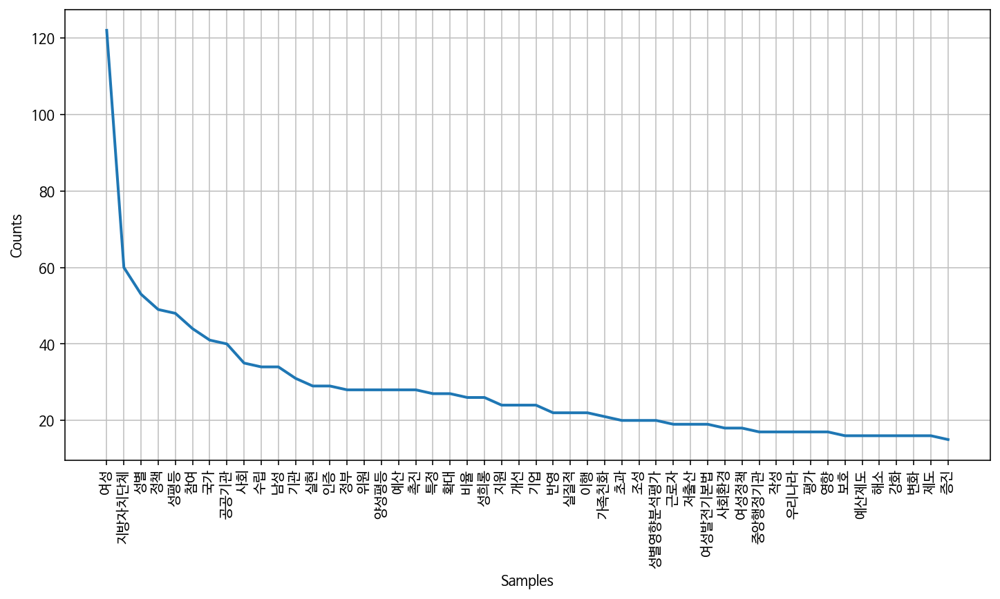

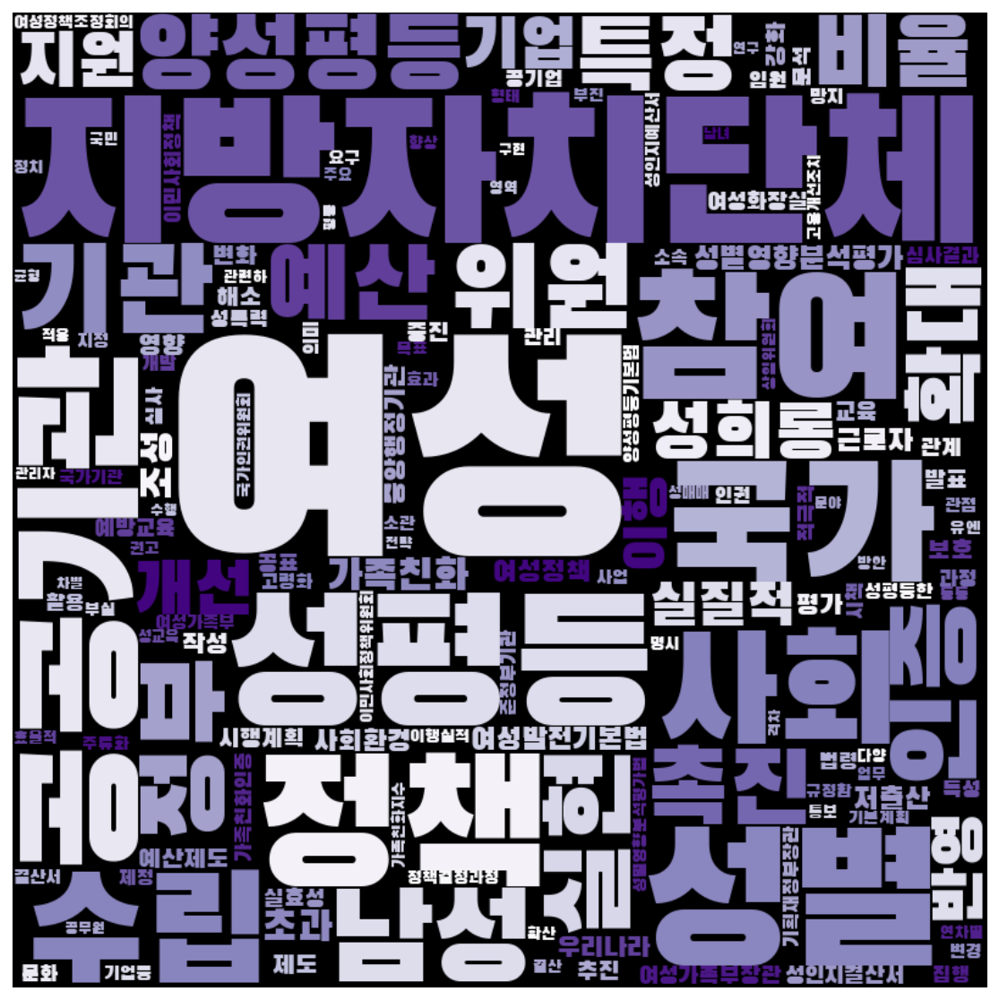

In [172]:
frewords_vis(women_g5_tokens)
wordcloud_vis(women_g5_tokens,'Accent')

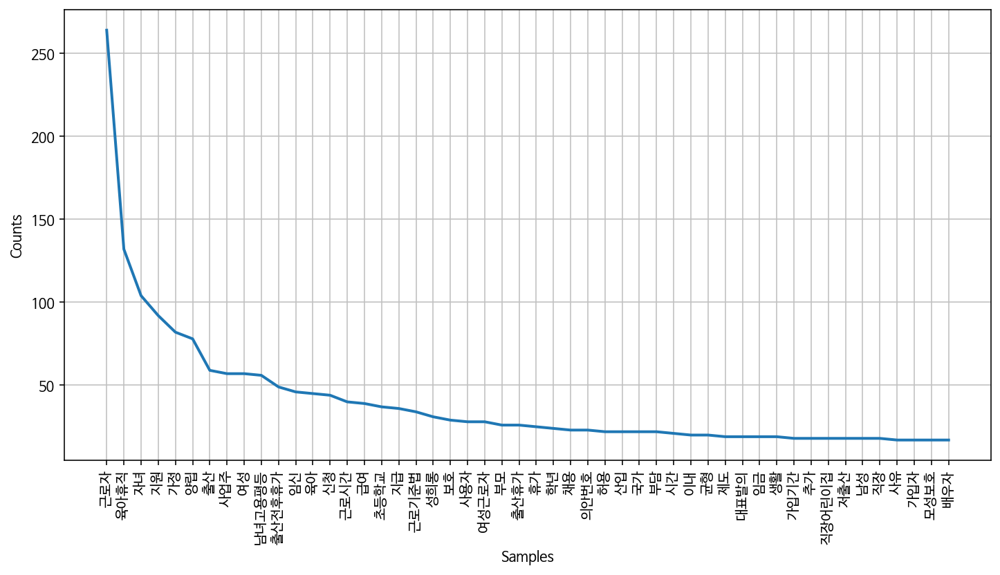

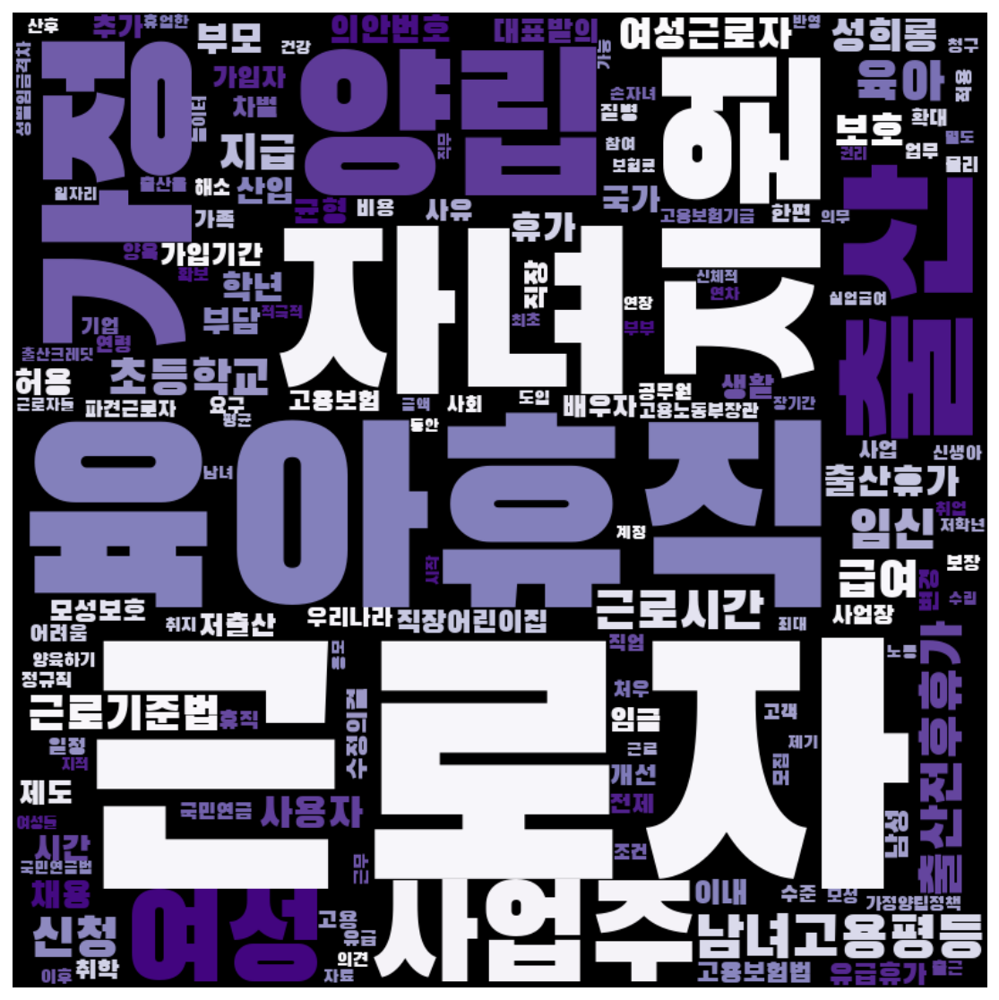

In [173]:
frewords_vis(women_g6_tokens)
wordcloud_vis(women_g6_tokens,'Accent')

In [174]:
# K means 수행 
word_vectors_men = men['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_men)
men['category'] = idx

<ipython-input-174-ea17c2f5c726>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['category'] = idx


In [175]:
men['category'].value_counts()

4    191
3    142
5    119
2     54
1     52
0      8
Name: category, dtype: int64

In [176]:
men_g1 = men[men['category'] == 0]
men_g2 = men[men['category'] == 1]
men_g3 = men[men['category'] == 2]
men_g4 = men[men['category'] == 3]
men_g5 = men[men['category'] == 4]
men_g6 = men[men['category'] == 5]

In [177]:
men_g1_tokens = total_tokens(men_g1['tokens'])
men_g2_tokens = total_tokens(men_g2['tokens'])
men_g3_tokens = total_tokens(men_g3['tokens'])
men_g4_tokens = total_tokens(men_g4['tokens'])
men_g5_tokens = total_tokens(men_g5['tokens'])
men_g6_tokens = total_tokens(men_g6['tokens'])

In [178]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
men_g1_tokens = [each_word for each_word in men_g1_tokens if each_word not in stopwords]
men_g2_tokens = [each_word for each_word in men_g2_tokens if each_word not in stopwords]
men_g3_tokens = [each_word for each_word in men_g3_tokens if each_word not in stopwords]
men_g4_tokens = [each_word for each_word in men_g4_tokens if each_word not in stopwords]
men_g5_tokens = [each_word for each_word in men_g5_tokens if each_word not in stopwords]
men_g6_tokens = [each_word for each_word in men_g6_tokens if each_word not in stopwords]

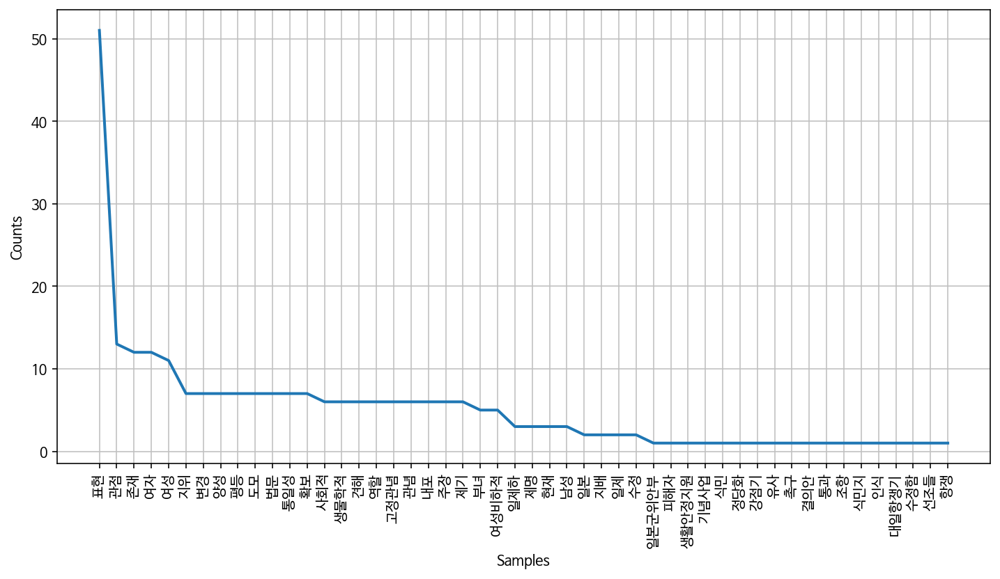

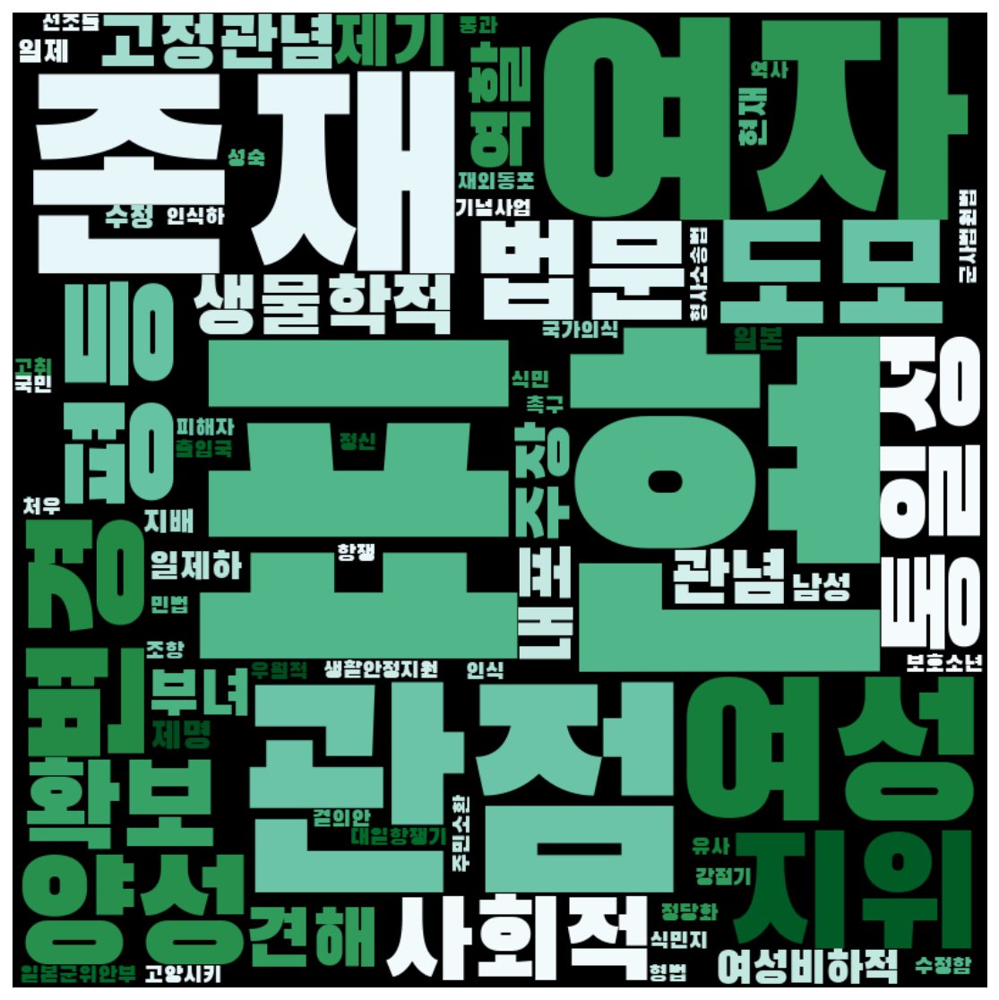

In [179]:
frewords_vis(men_g1_tokens)
wordcloud_vis(men_g1_tokens,'coolwarm')

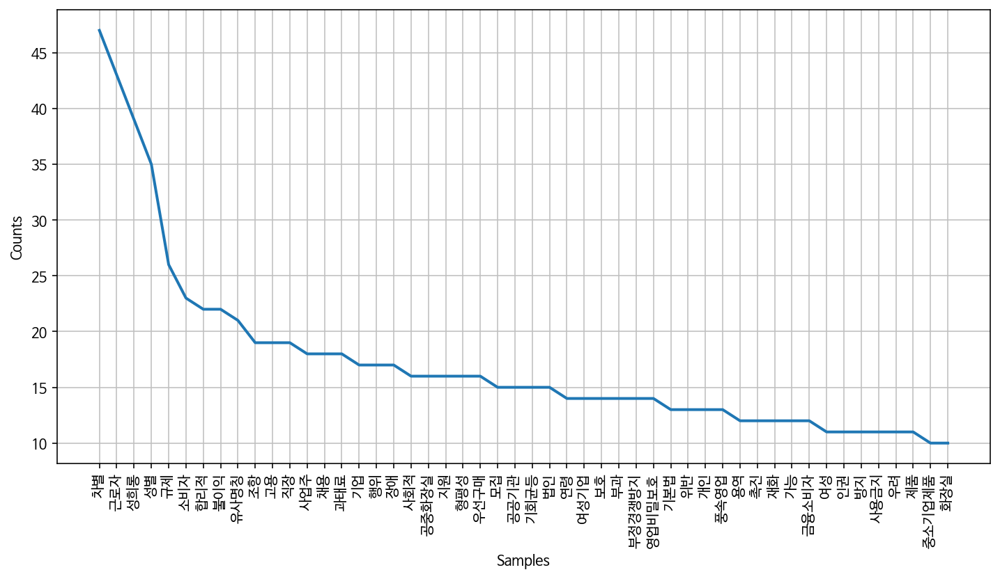

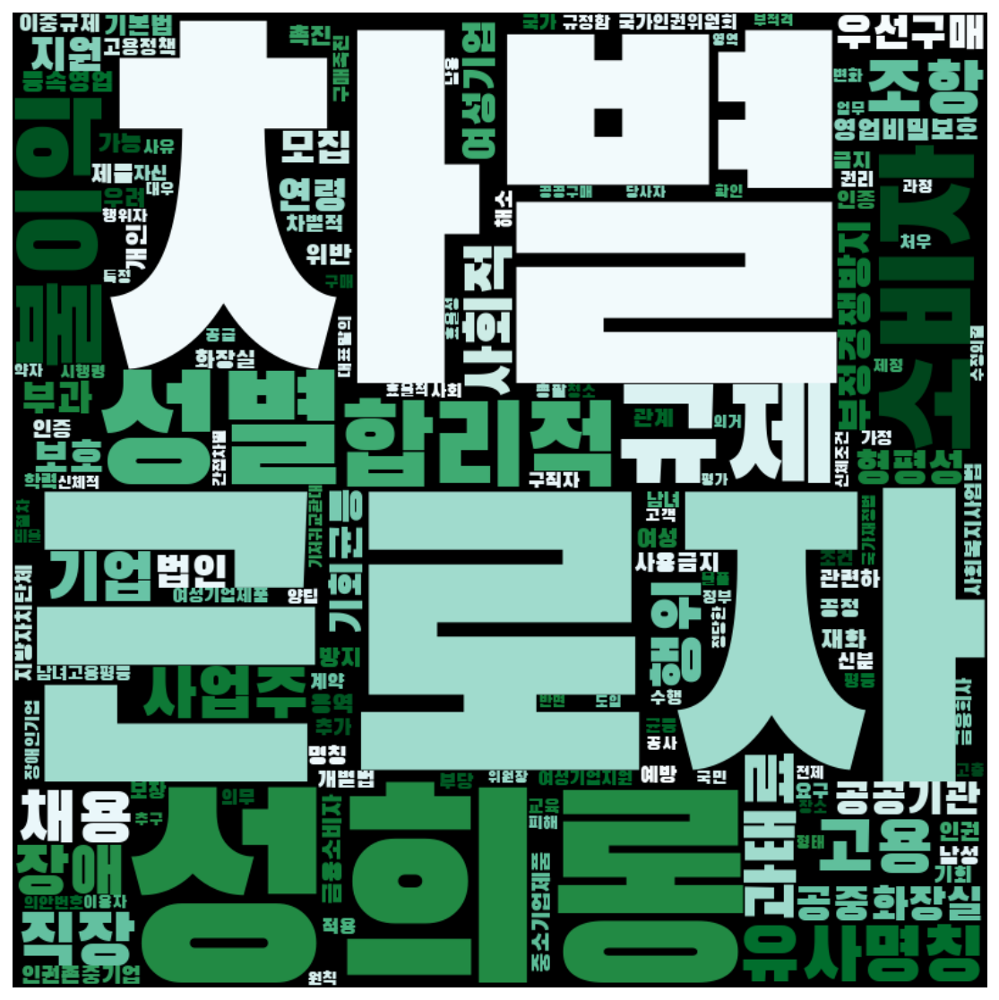

In [180]:
frewords_vis(men_g2_tokens)
wordcloud_vis(men_g2_tokens,'coolwarm')

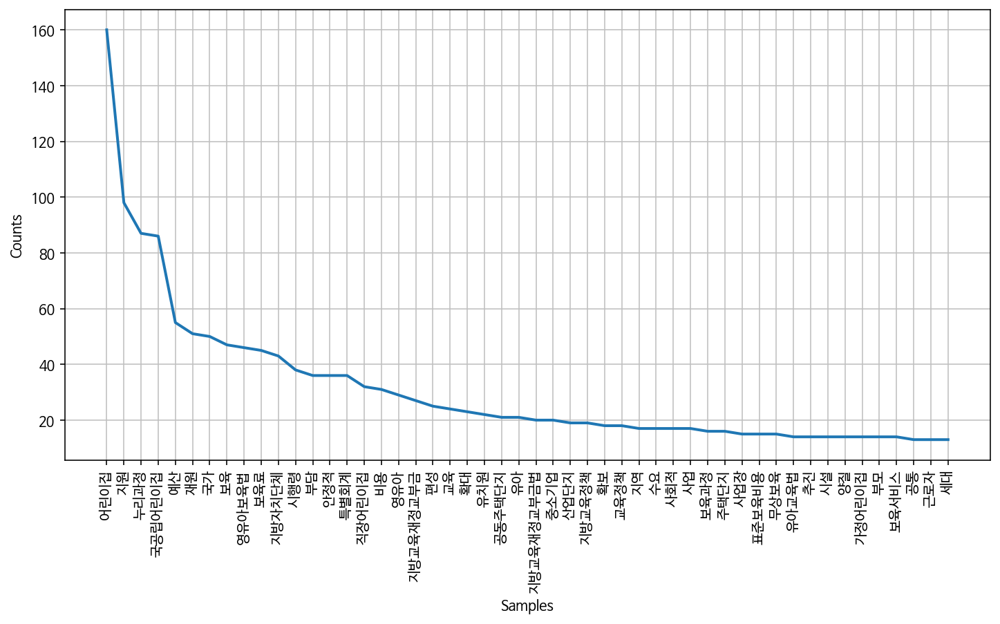

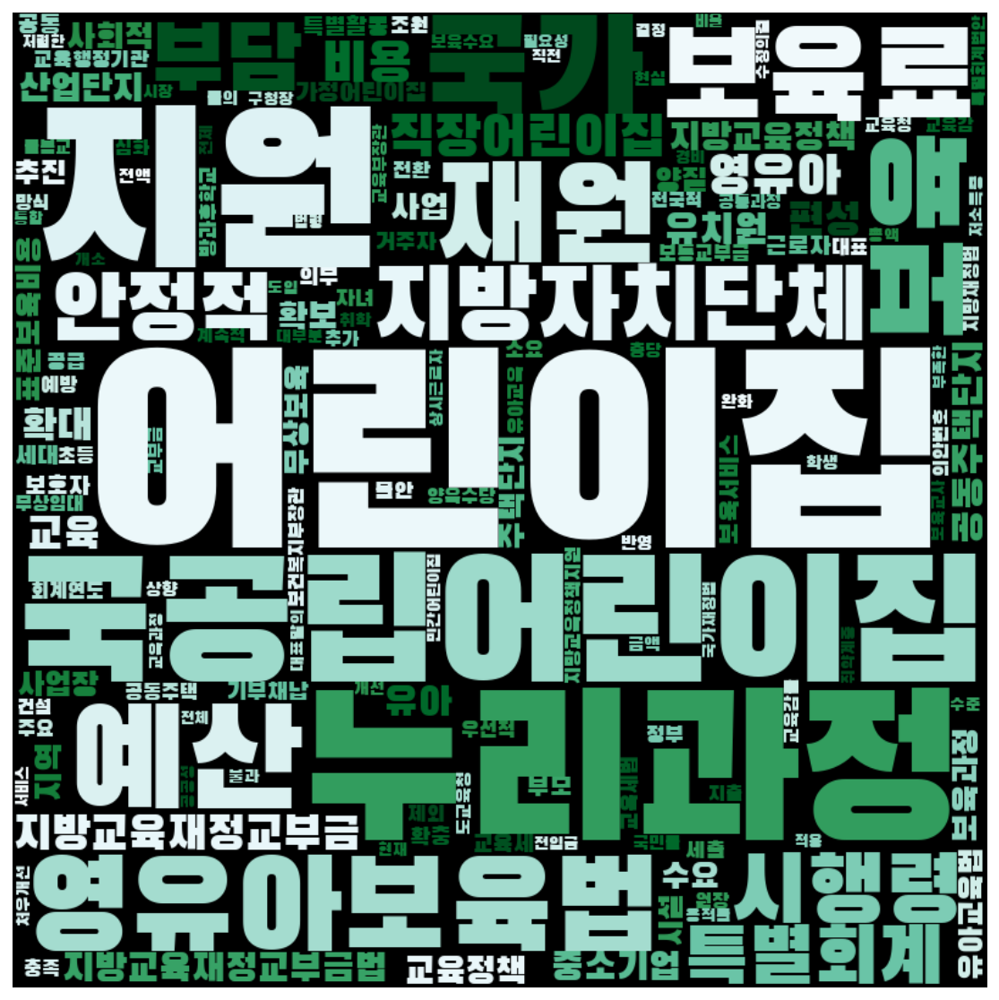

In [181]:
frewords_vis(men_g3_tokens)
wordcloud_vis(men_g3_tokens,'coolwarm')

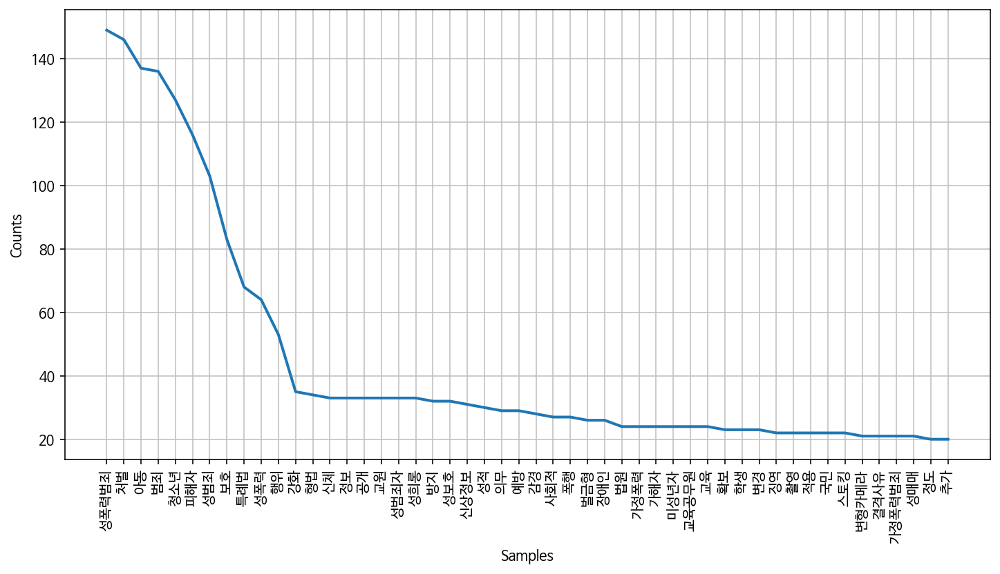

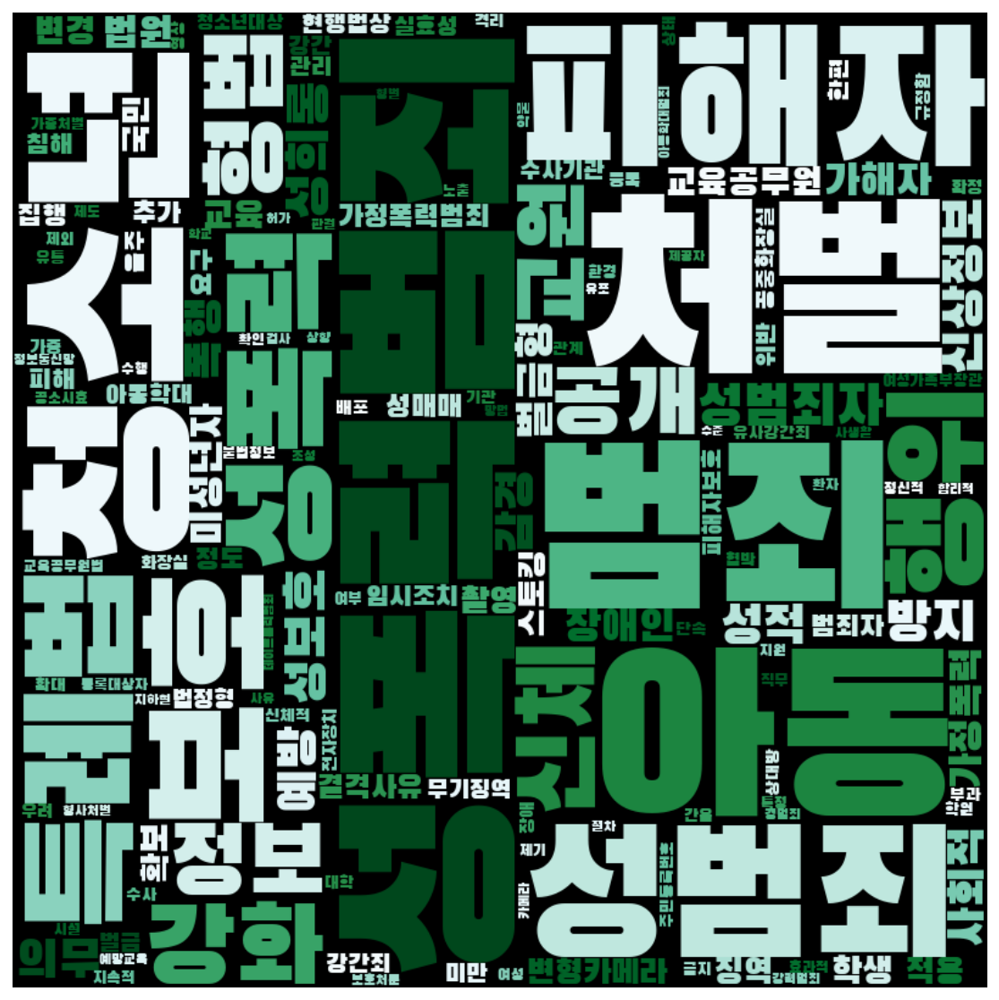

In [182]:
frewords_vis(men_g4_tokens)
wordcloud_vis(men_g4_tokens,'coolwarm')

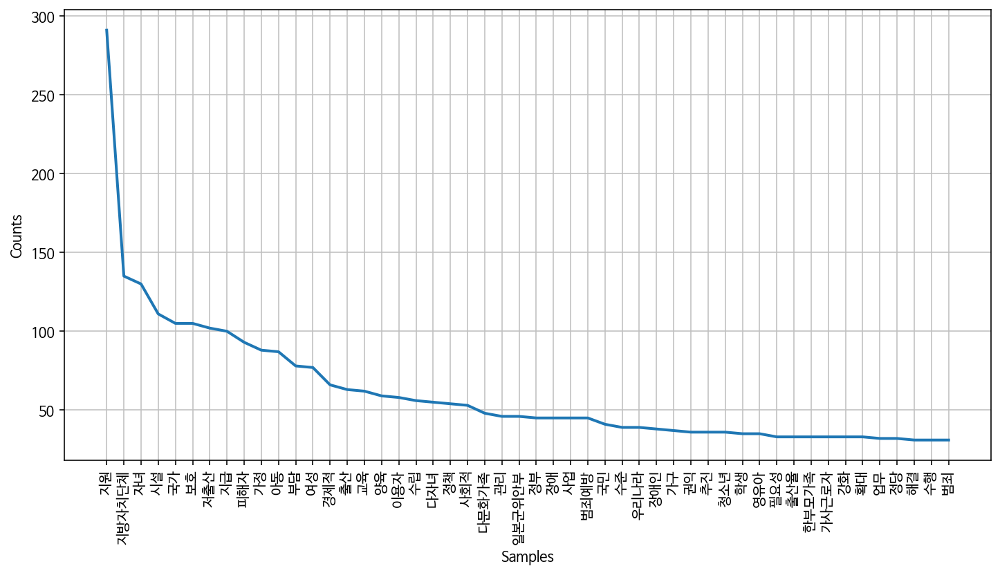

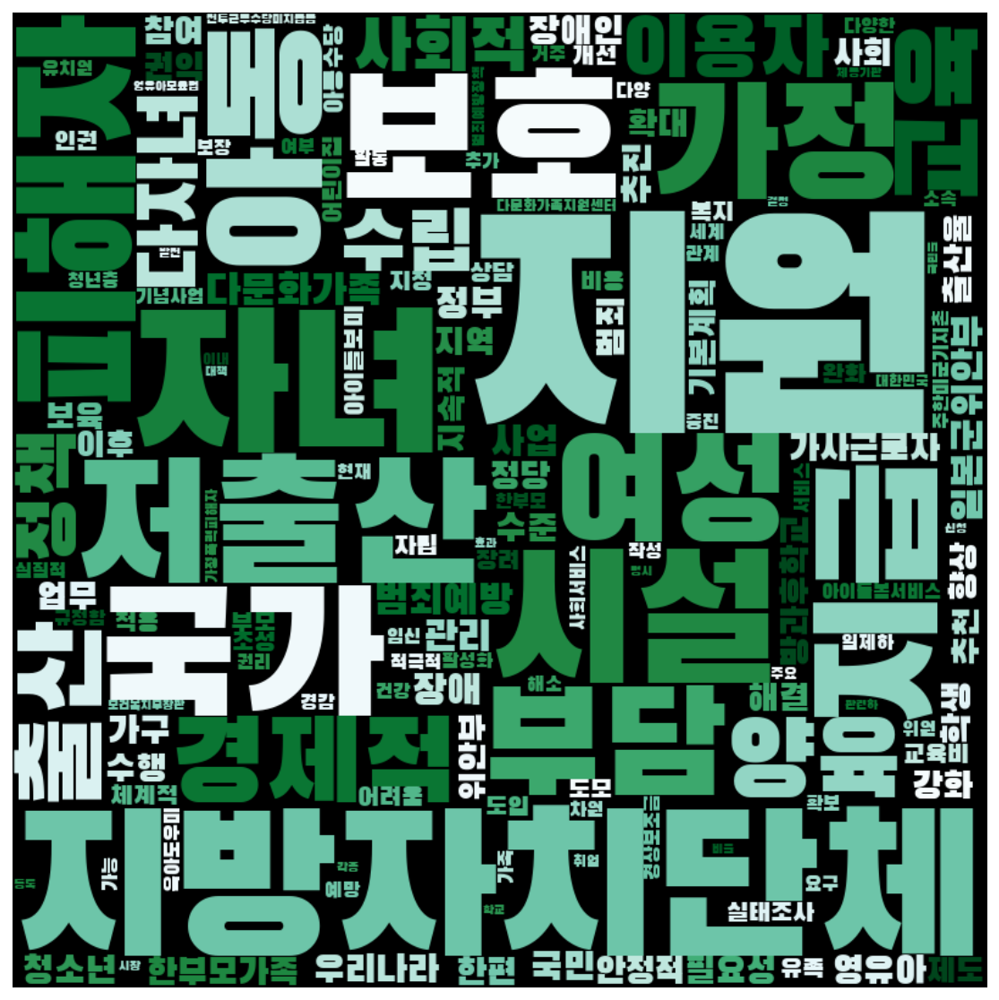

In [183]:
frewords_vis(men_g5_tokens)
wordcloud_vis(men_g5_tokens,'coolwarm')

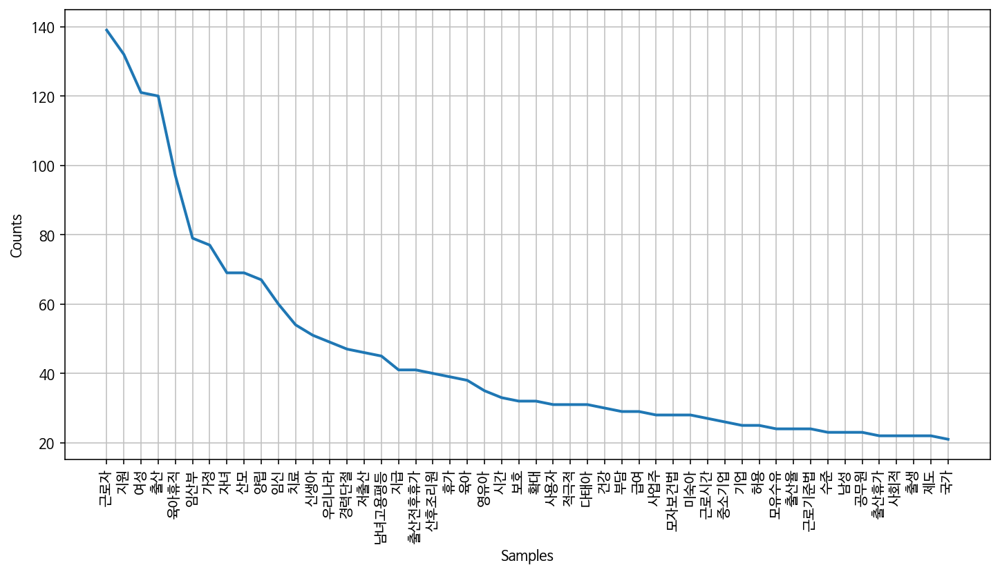

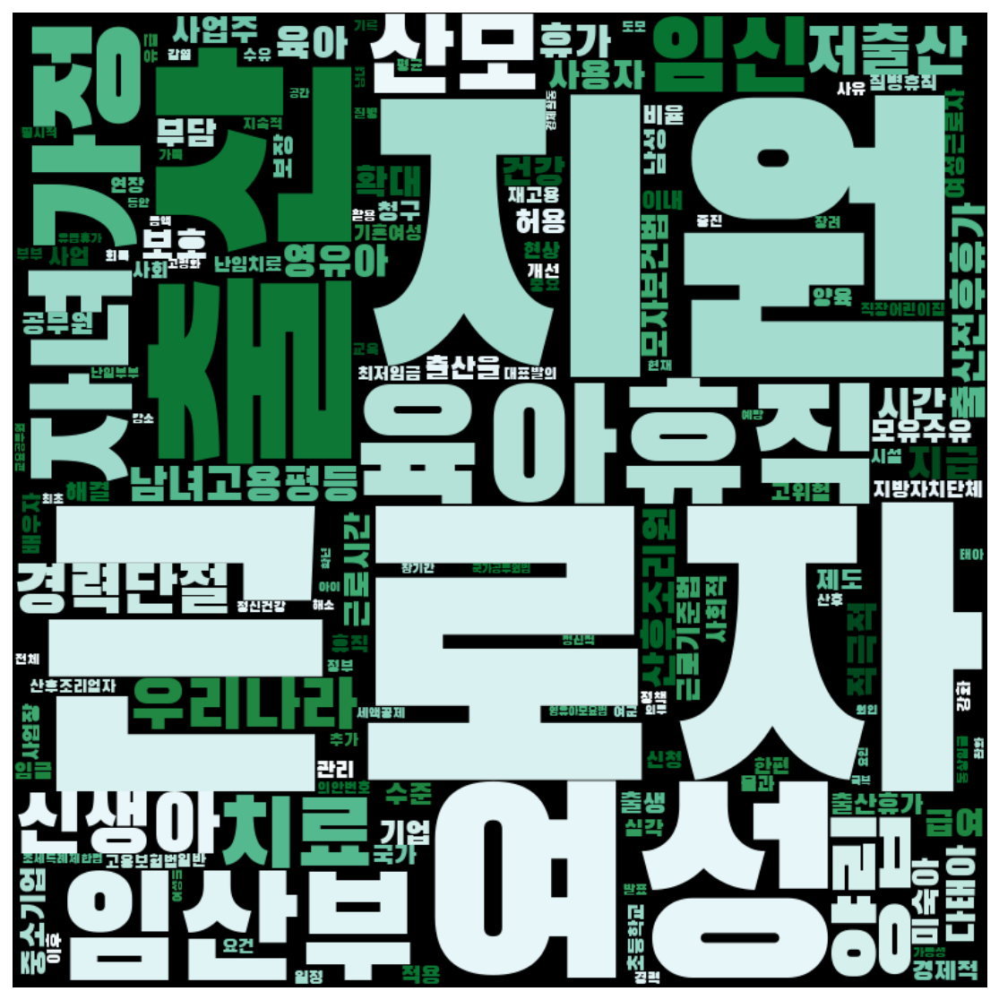

In [184]:
frewords_vis(men_g6_tokens)
wordcloud_vis(men_g6_tokens,'coolwarm')

## 문재인 정권 
- 2017.05.10 ~

In [185]:
moonjaein = gender[(gender['제안일자'] > datetime.date(2017,5,10))]
moonjaein.shape

(1410, 19)

In [186]:
moonjaein['성별'].value_counts()

남성    760
여성    526
Name: 성별, dtype: int64

In [187]:
pd.DataFrame(moonjaein.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  234
     여성  176
진보   남성  510
     여성  349

In [188]:
women = moonjaein[moonjaein['성별'] == '여성']
men = moonjaein[moonjaein['성별'] == '남성']

In [189]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:54:24,557 : INFO : collecting all words and their counts
2020-10-20 14:54:24,564 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:54:24,585 : INFO : collected 5871 word types from a corpus of 34980 raw words and 526 sentences
2020-10-20 14:54:24,586 : INFO : Loading a fresh vocabulary
2020-10-20 14:54:24,591 : INFO : effective_min_count=10 retains 705 unique words (12% of original 5871, drops 5166)
2020-10-20 14:54:24,592 : INFO : effective_min_count=10 leaves 22965 word corpus (65% of original 34980, drops 12015)
2020-10-20 14:54:24,596 : INFO : deleting the raw counts dictionary of 5871 items
2020-10-20 14:54:24,597 : INFO : sample=0.001 downsamples 71 most-common words
2020-10-20 14:54:24,598 : INFO : downsampling leaves estimated 19176 word corpus (83.5% of prior 22965)
2020-10-20 14:54:24,601 : INFO : estimated required memory for 705 words and 100 dimensions: 916500 bytes
2020-10-20 14:54:24,602 : INFO : resetting layer weight

2020-10-20 14:54:25,966 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:25,977 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:25,987 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:25,988 : INFO : EPOCH - 15 : training on 34980 raw words (19282 effective words) took 0.1s, 254484 effective words/s
2020-10-20 14:54:26,041 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:26,059 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:26,065 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:26,071 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:26,072 : INFO : EPOCH - 16 : training on 34980 raw words (19185 effective words) took 0.1s, 246853 effective words/s
2020-10-20 14:54:26,116 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:27,304 : INFO : EPOCH - 31 : training on 34980 raw words (19217 effective words) took 0.1s, 234649 effective words/s
2020-10-20 14:54:27,352 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:27,366 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:27,376 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:27,382 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:27,384 : INFO : EPOCH - 32 : training on 34980 raw words (19228 effective words) took 0.1s, 249859 effective words/s
2020-10-20 14:54:27,441 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:27,448 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:27,461 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:27,469 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:28,662 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:28,667 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:28,668 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:28,669 : INFO : EPOCH - 48 : training on 34980 raw words (19122 effective words) took 0.1s, 277840 effective words/s
2020-10-20 14:54:28,720 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:28,737 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:28,743 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:28,746 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:28,751 : INFO : EPOCH - 49 : training on 34980 raw words (19135 effective words) took 0.1s, 244418 effective words/s
2020-10-20 14:54:28,794 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:29,940 : INFO : EPOCH - 64 : training on 34980 raw words (19193 effective words) took 0.1s, 266688 effective words/s
2020-10-20 14:54:29,990 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:30,004 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:30,016 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:30,019 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:30,021 : INFO : EPOCH - 65 : training on 34980 raw words (19156 effective words) took 0.1s, 252342 effective words/s
2020-10-20 14:54:30,071 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:30,081 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:30,091 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:30,099 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:31,290 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:31,299 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:31,304 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:31,305 : INFO : EPOCH - 81 : training on 34980 raw words (19216 effective words) took 0.1s, 267688 effective words/s
2020-10-20 14:54:31,353 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:31,376 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:31,379 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:31,381 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:31,382 : INFO : EPOCH - 82 : training on 34980 raw words (19202 effective words) took 0.1s, 285345 effective words/s
2020-10-20 14:54:31,423 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:32,557 : INFO : EPOCH - 97 : training on 34980 raw words (19225 effective words) took 0.1s, 253269 effective words/s
2020-10-20 14:54:32,614 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:32,622 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:32,630 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:32,642 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:32,643 : INFO : EPOCH - 98 : training on 34980 raw words (19199 effective words) took 0.1s, 234565 effective words/s
2020-10-20 14:54:32,687 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:32,708 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:32,717 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:32,718 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:34,468 : INFO : EPOCH - 11 : training on 48537 raw words (30100 effective words) took 0.1s, 247568 effective words/s
2020-10-20 14:54:34,546 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:34,551 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:34,553 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:34,580 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:34,581 : INFO : EPOCH - 12 : training on 48537 raw words (30072 effective words) took 0.1s, 281342 effective words/s
2020-10-20 14:54:34,661 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:34,662 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:34,666 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:34,697 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:36,547 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:36,552 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:36,595 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:36,596 : INFO : EPOCH - 28 : training on 48537 raw words (30001 effective words) took 0.1s, 239721 effective words/s
2020-10-20 14:54:36,681 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:36,685 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:36,687 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:36,729 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:36,730 : INFO : EPOCH - 29 : training on 48537 raw words (30028 effective words) took 0.1s, 240249 effective words/s
2020-10-20 14:54:36,807 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:38,652 : INFO : EPOCH - 44 : training on 48537 raw words (30056 effective words) took 0.1s, 238875 effective words/s
2020-10-20 14:54:38,733 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:38,738 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:38,738 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:38,783 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:38,785 : INFO : EPOCH - 45 : training on 48537 raw words (30058 effective words) took 0.1s, 232947 effective words/s
2020-10-20 14:54:38,874 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:38,876 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:38,877 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:38,912 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:40,734 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:40,737 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:40,768 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:40,769 : INFO : EPOCH - 61 : training on 48537 raw words (30129 effective words) took 0.1s, 276925 effective words/s
2020-10-20 14:54:40,857 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:40,860 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:40,861 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:40,912 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:40,914 : INFO : EPOCH - 62 : training on 48537 raw words (30016 effective words) took 0.1s, 227489 effective words/s
2020-10-20 14:54:40,993 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:42,805 : INFO : EPOCH - 77 : training on 48537 raw words (30061 effective words) took 0.1s, 259183 effective words/s
2020-10-20 14:54:42,886 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:42,889 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:42,891 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:42,927 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:42,928 : INFO : EPOCH - 78 : training on 48537 raw words (30045 effective words) took 0.1s, 268088 effective words/s
2020-10-20 14:54:43,007 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:43,010 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:43,015 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:43,043 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:44,843 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:44,851 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:44,889 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:44,892 : INFO : EPOCH - 94 : training on 48537 raw words (30014 effective words) took 0.1s, 243356 effective words/s
2020-10-20 14:54:44,960 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:44,969 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:44,976 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:45,001 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:45,002 : INFO : EPOCH - 95 : training on 48537 raw words (30067 effective words) took 0.1s, 282315 effective words/s
2020-10-20 14:54:45,078 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [190]:
print(model_women.wv.most_similar('여성'))

2020-10-20 14:54:45,663 : INFO : precomputing L2-norms of word weight vectors


[('남성', 0.5992206335067749), ('비율', 0.5042550563812256), ('임원', 0.43938660621643066), ('세계', 0.42925703525543213), ('임기만료', 0.41442710161209106), ('선출공직', 0.3824389576911926), ('남녀동수', 0.37456271052360535), ('확대', 0.3669586479663849), ('결혼', 0.36455968022346497), ('우리나라', 0.35906362533569336)]


In [191]:
print(model_men.wv.most_similar('여성'))

2020-10-20 14:54:45,672 : INFO : precomputing L2-norms of word weight vectors


[('중소기업', 0.5057257413864136), ('기업', 0.47995859384536743), ('여자', 0.4784560799598694), ('재고용', 0.4765865206718445), ('남성', 0.4705030620098114), ('세액공제', 0.4450126886367798), ('인력난', 0.4353387653827667), ('중견기업', 0.42229682207107544), ('경력단절', 0.420254647731781), ('우리나라', 0.41759809851646423)]


In [192]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [193]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

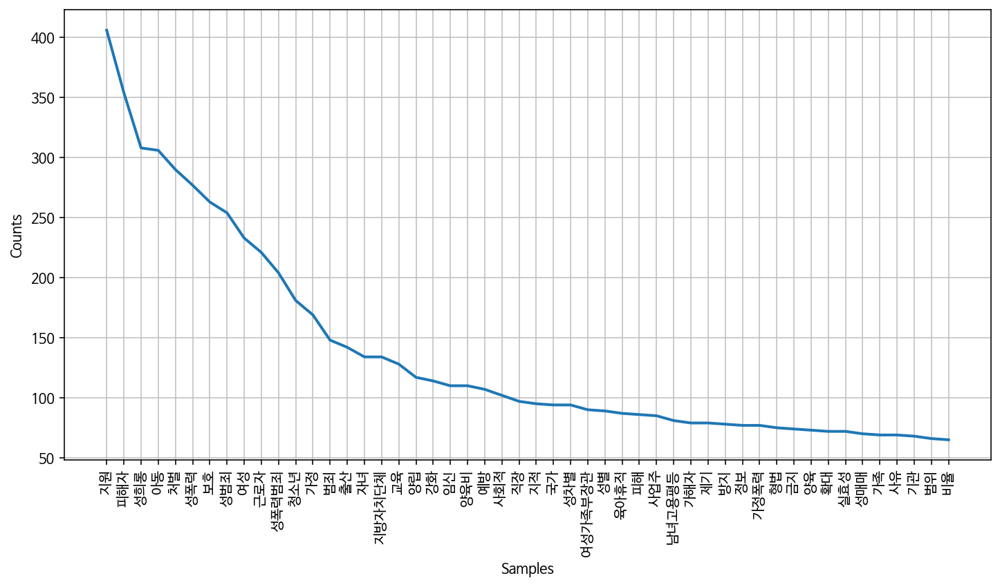

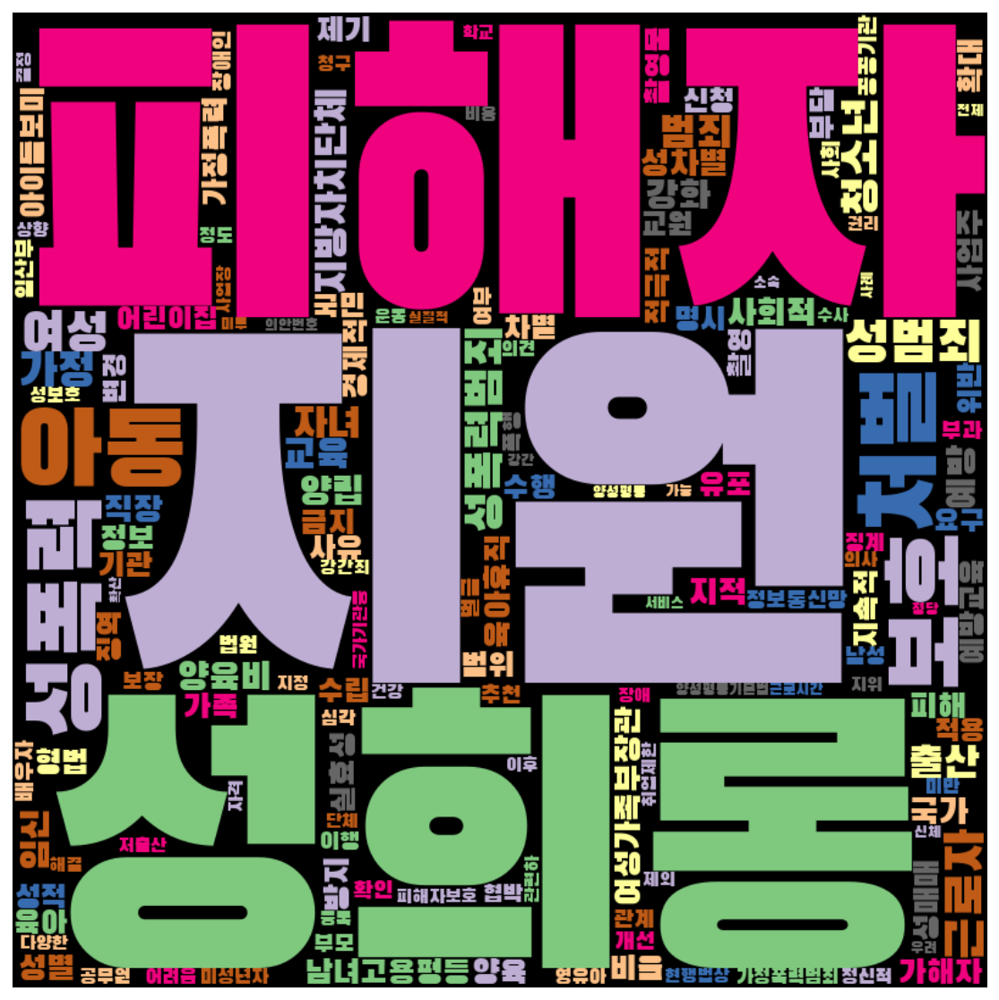

In [222]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

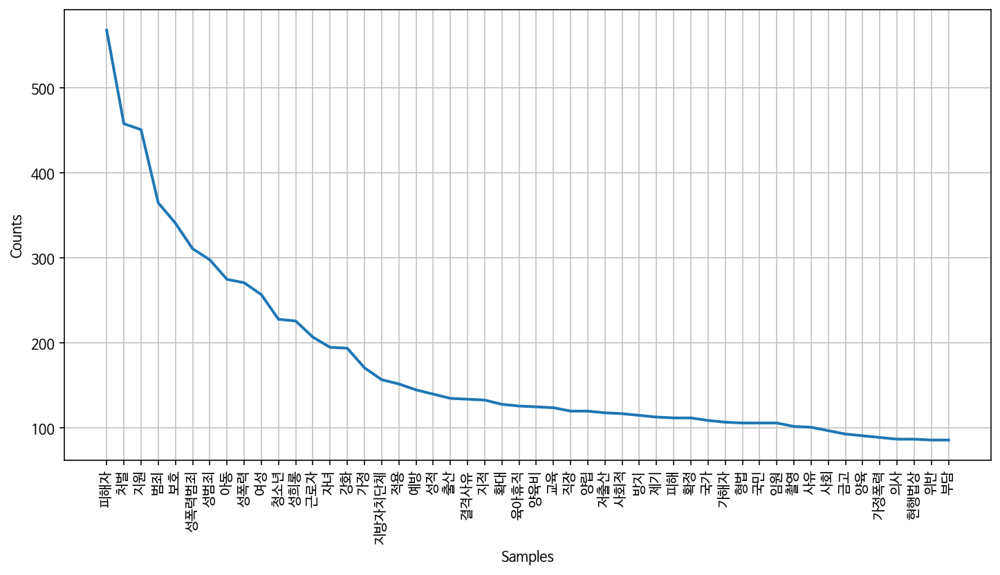

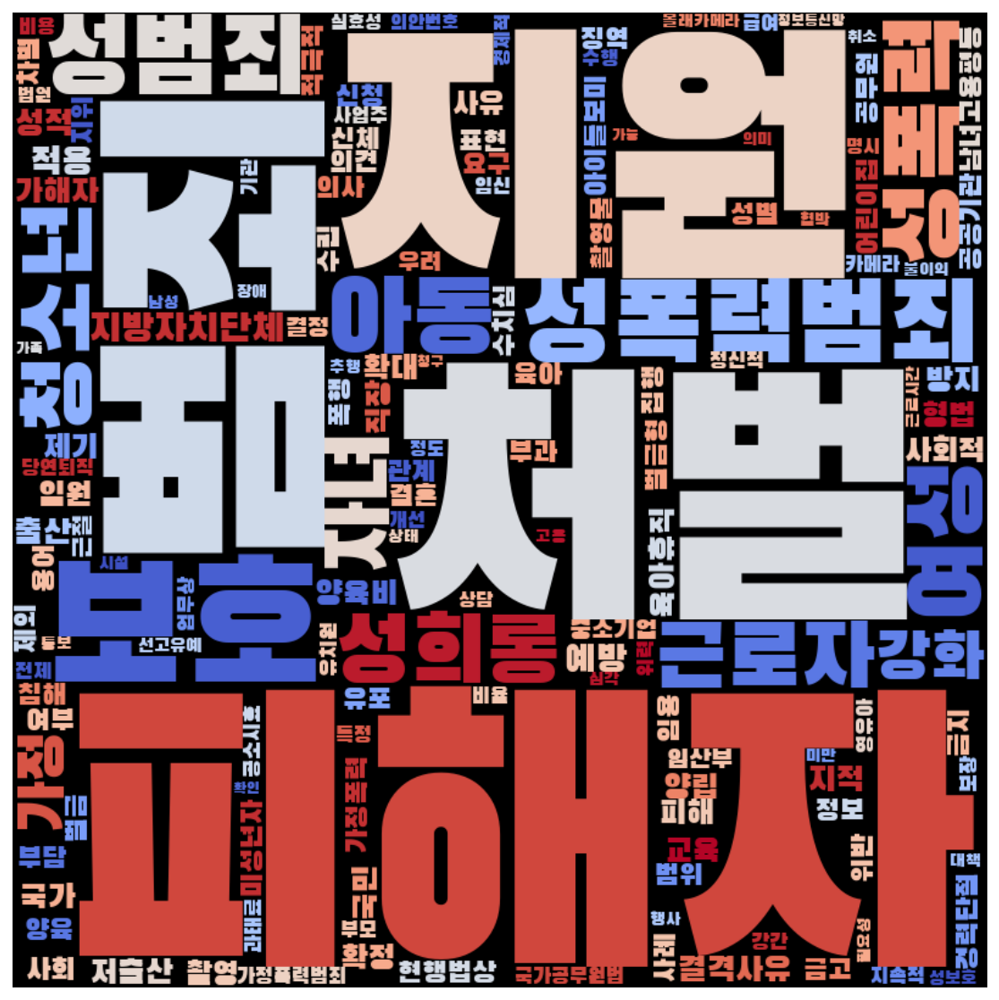

In [224]:
frewords_vis(men_word)
wordcloud_vis(men_word,'coolwarm')

In [225]:
women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))

/usr/local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
<ipython-input-225-87b19f55aed6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
<ipython-input-225-87b19f55aed6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))


In [228]:
women = women[women['명사수'] > 1]

# K means 수행 
word_vectors_women = women['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_women)
women['category'] = idx

<ipython-input-228-4d757fdbfe45>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['category'] = idx


In [229]:
women['category'].value_counts()

0    138
4    118
5    116
3     77
1     45
2     31
Name: category, dtype: int64

In [230]:
women_g1 = women[women['category'] == 0]
women_g2 = women[women['category'] == 1]
women_g3 = women[women['category'] == 2]
women_g4 = women[women['category'] == 3]
women_g5 = women[women['category'] == 4]
women_g6 = women[women['category'] == 5]

In [231]:
women_g1_tokens = total_tokens(women_g1['tokens'])
women_g2_tokens = total_tokens(women_g2['tokens'])
women_g3_tokens = total_tokens(women_g3['tokens'])
women_g4_tokens = total_tokens(women_g4['tokens'])
women_g5_tokens = total_tokens(women_g5['tokens'])
women_g6_tokens = total_tokens(women_g6['tokens'])

In [232]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
women_g1_tokens = [each_word for each_word in women_g1_tokens if each_word not in stopwords]
women_g2_tokens = [each_word for each_word in women_g2_tokens if each_word not in stopwords]
women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

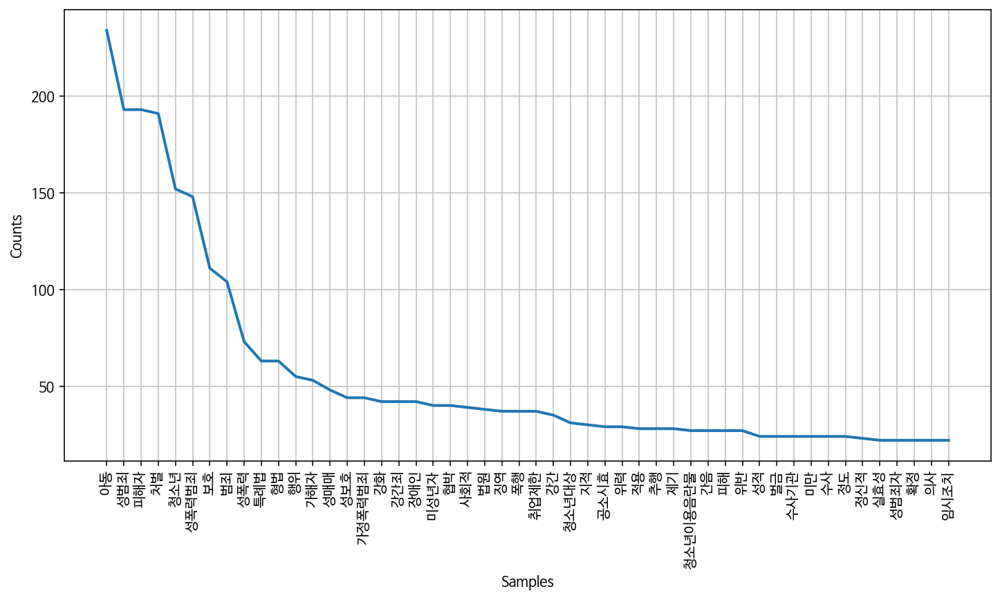

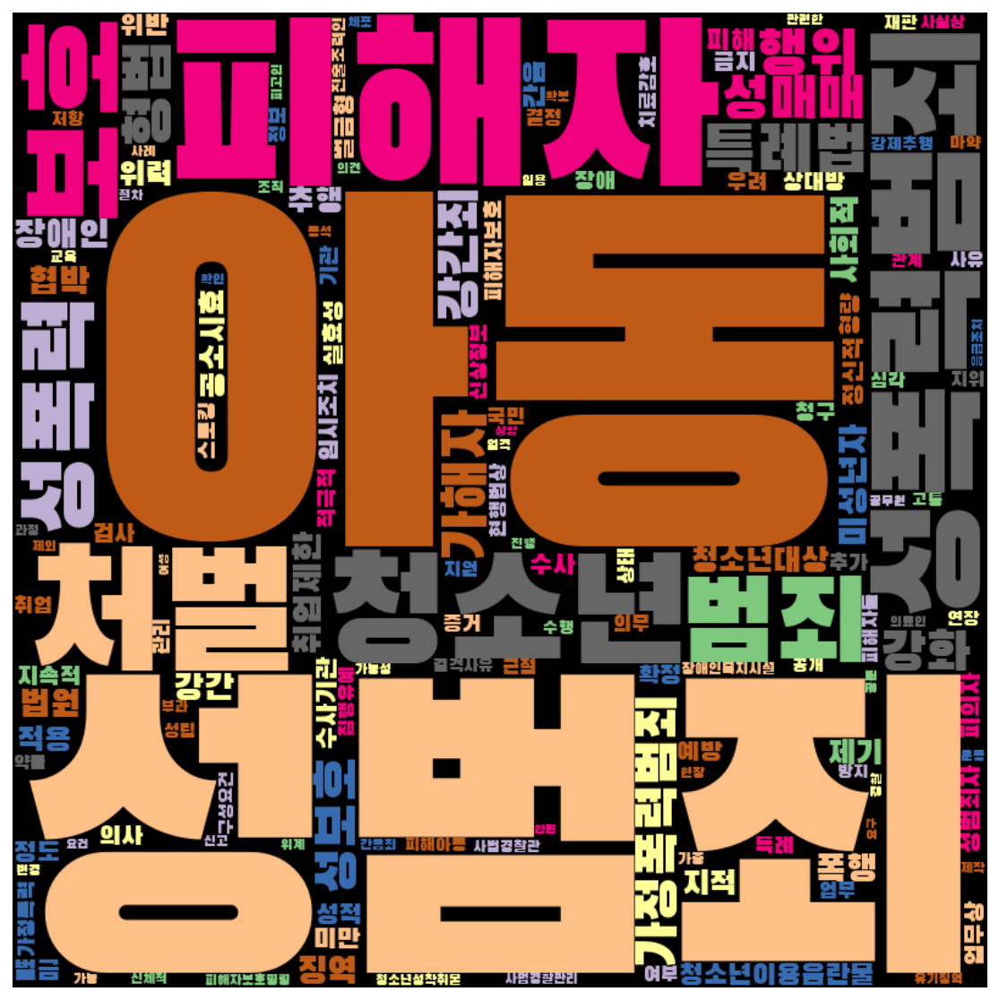

In [233]:
frewords_vis(women_g1_tokens)
wordcloud_vis(women_g1_tokens, 'Accent')

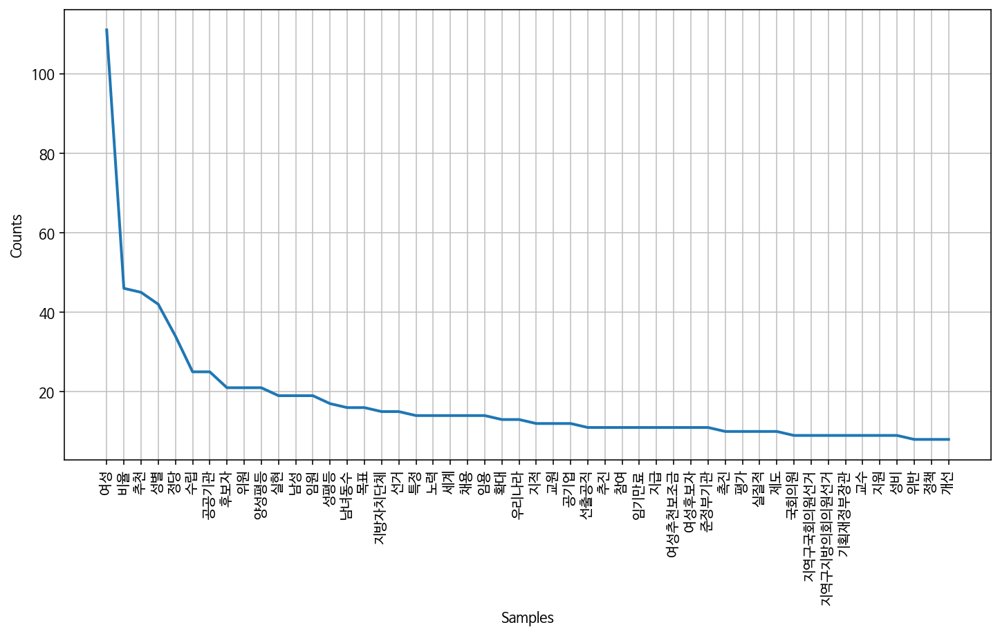

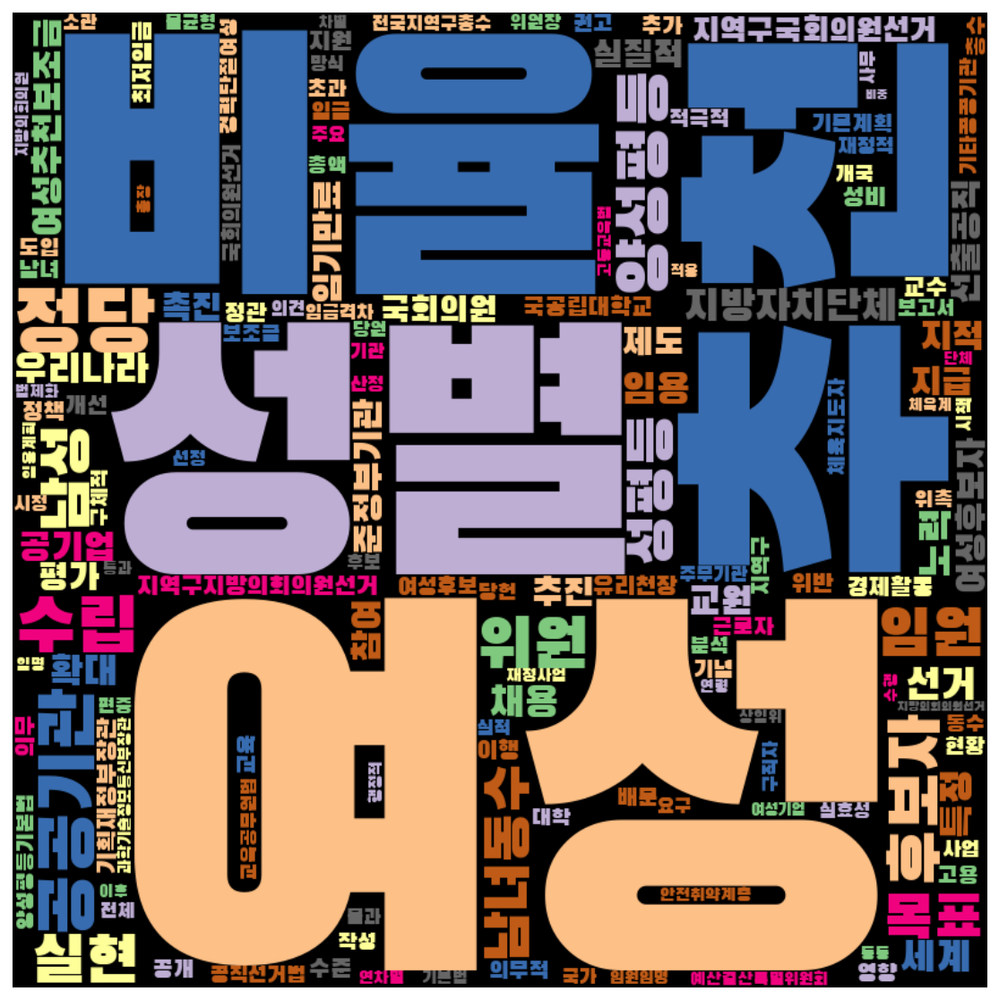

In [234]:
frewords_vis(women_g2_tokens)
wordcloud_vis(women_g2_tokens,'Accent')

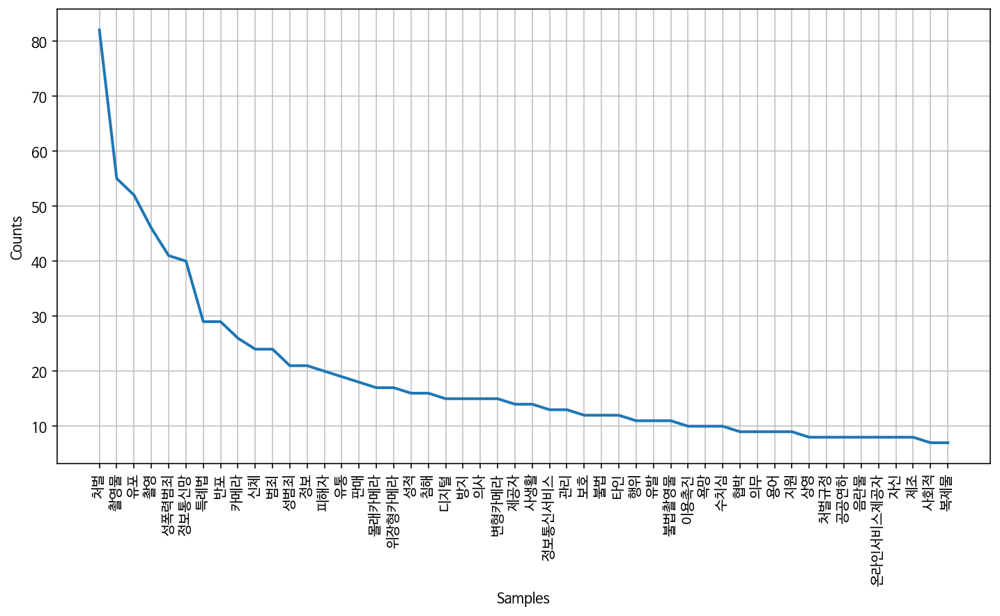

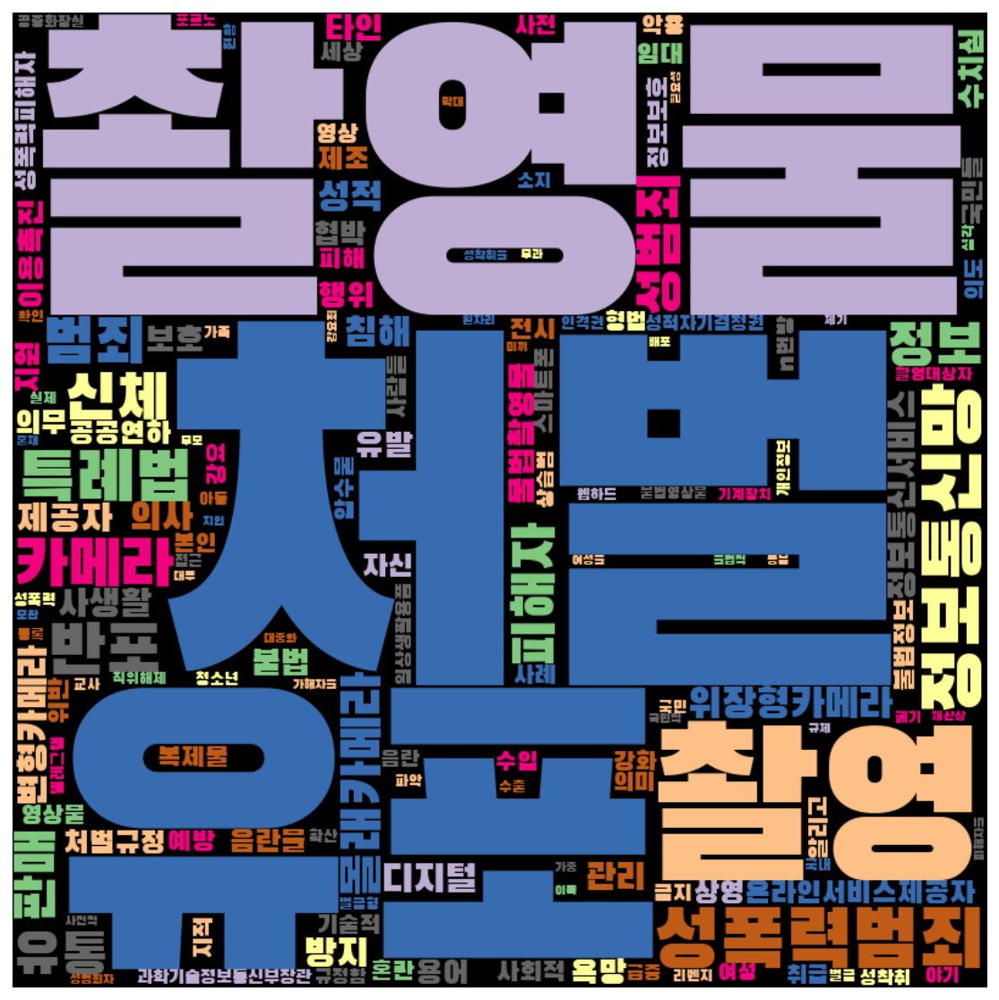

In [235]:
frewords_vis(women_g3_tokens)
wordcloud_vis(women_g3_tokens,'Accent')

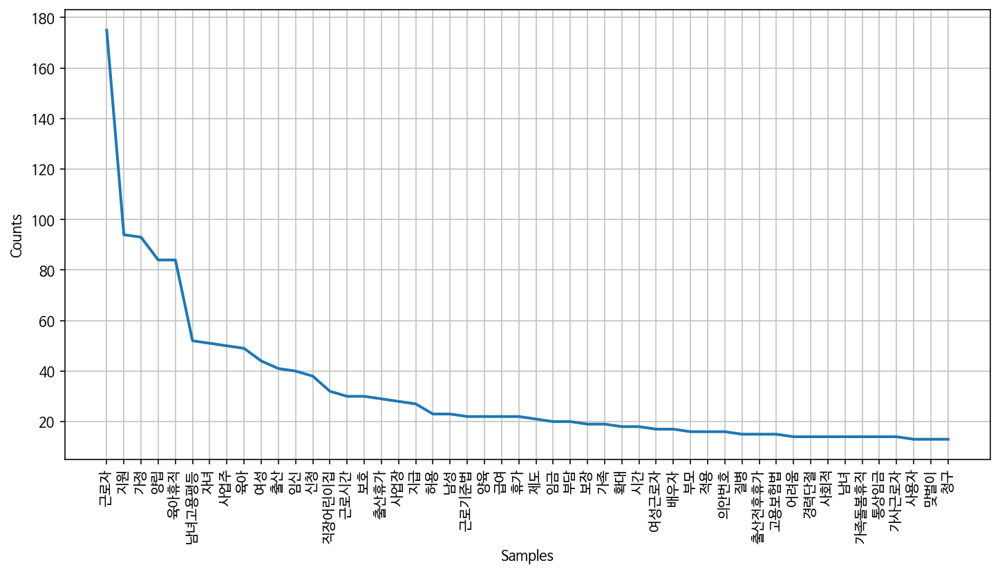

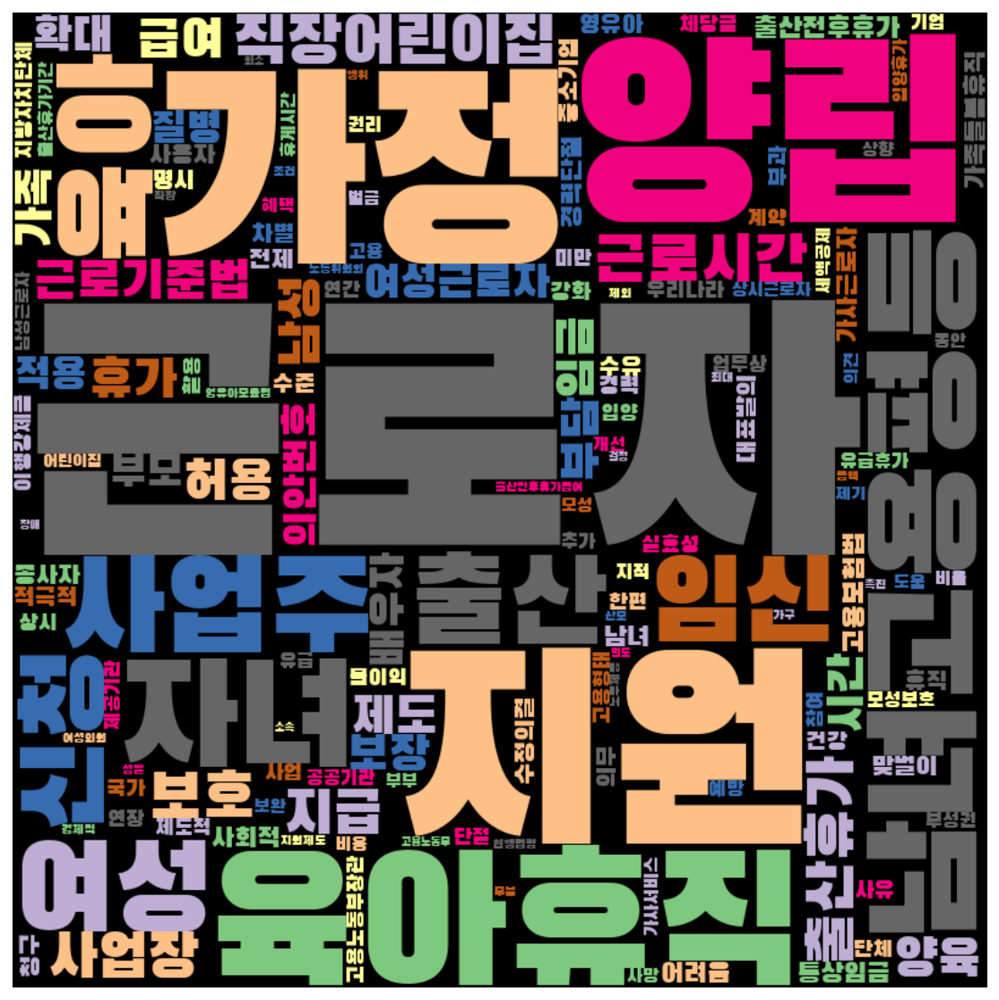

In [236]:
frewords_vis(women_g4_tokens)
wordcloud_vis(women_g4_tokens,'Accent')

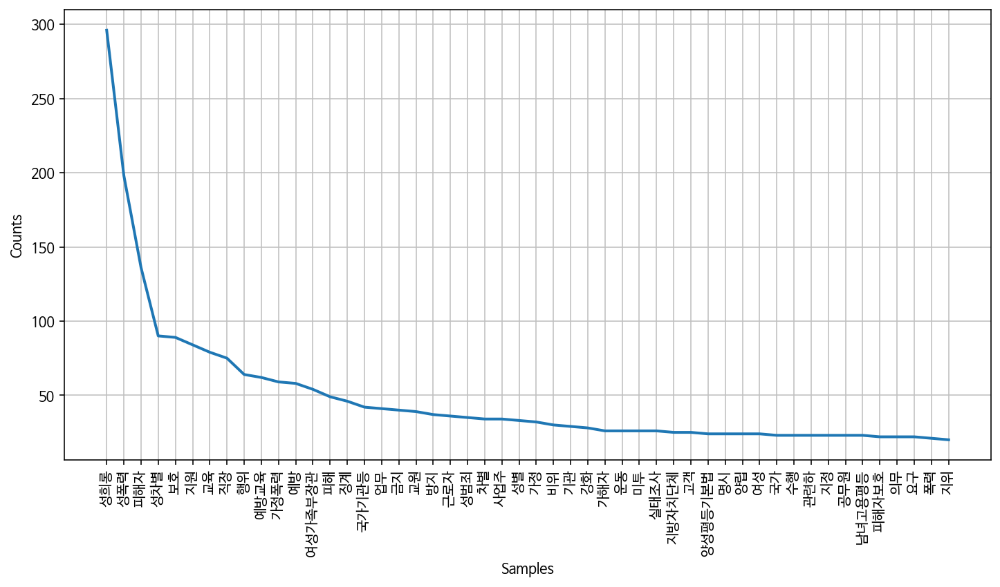

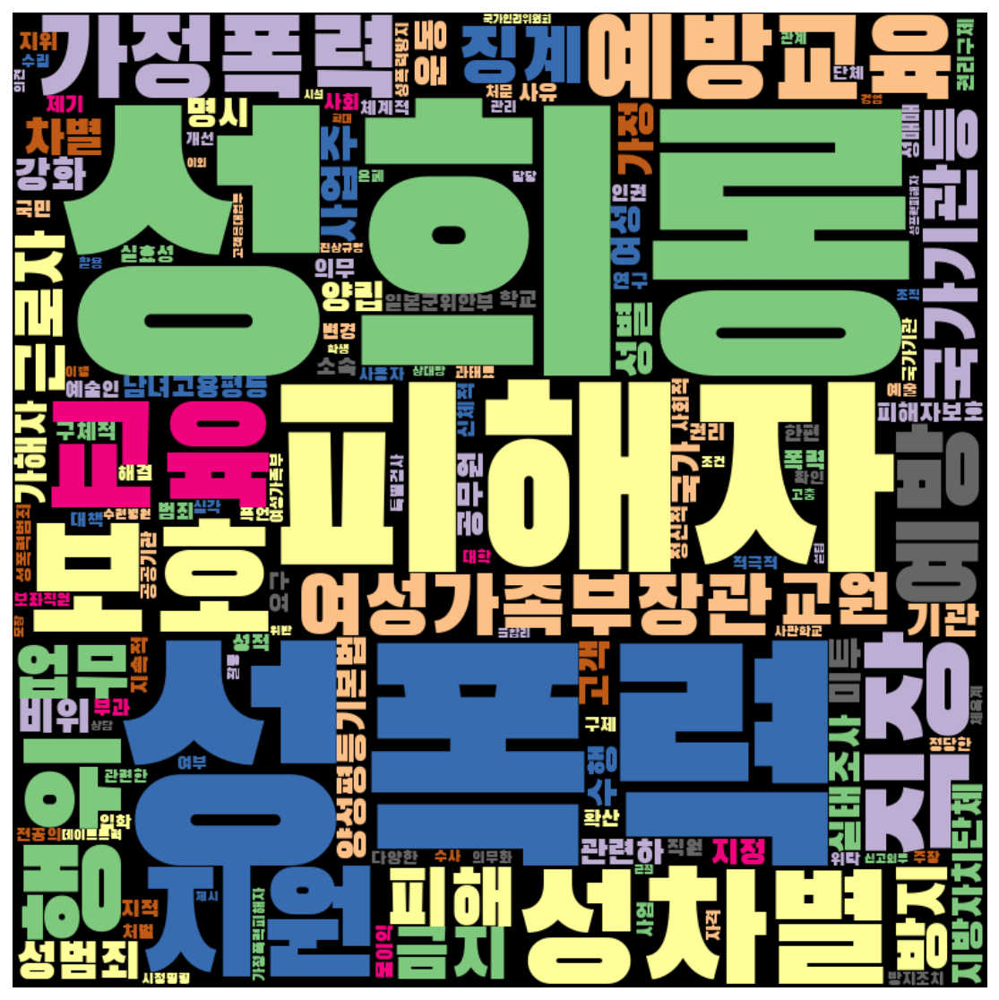

In [237]:
frewords_vis(women_g5_tokens)
wordcloud_vis(women_g5_tokens,'Accent')

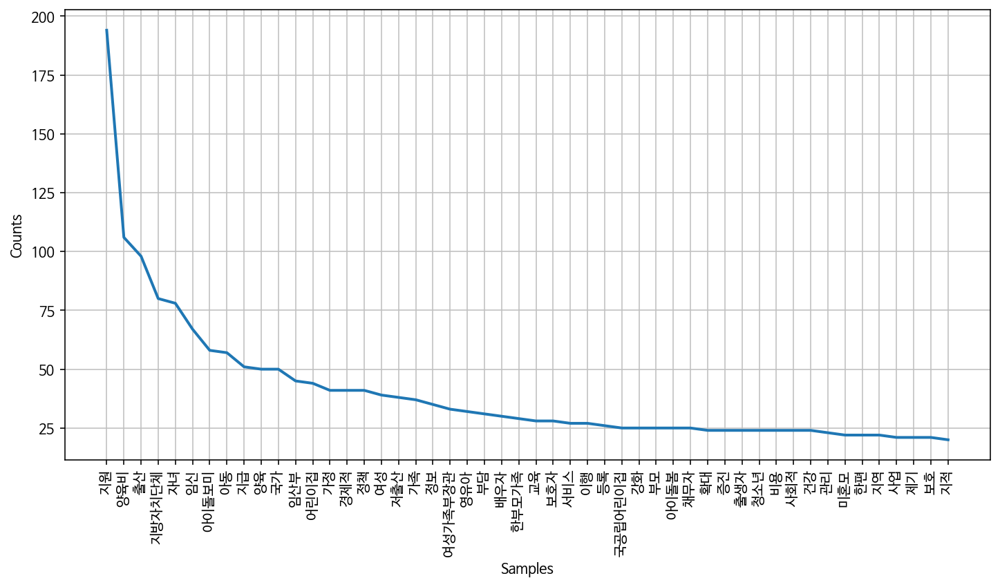

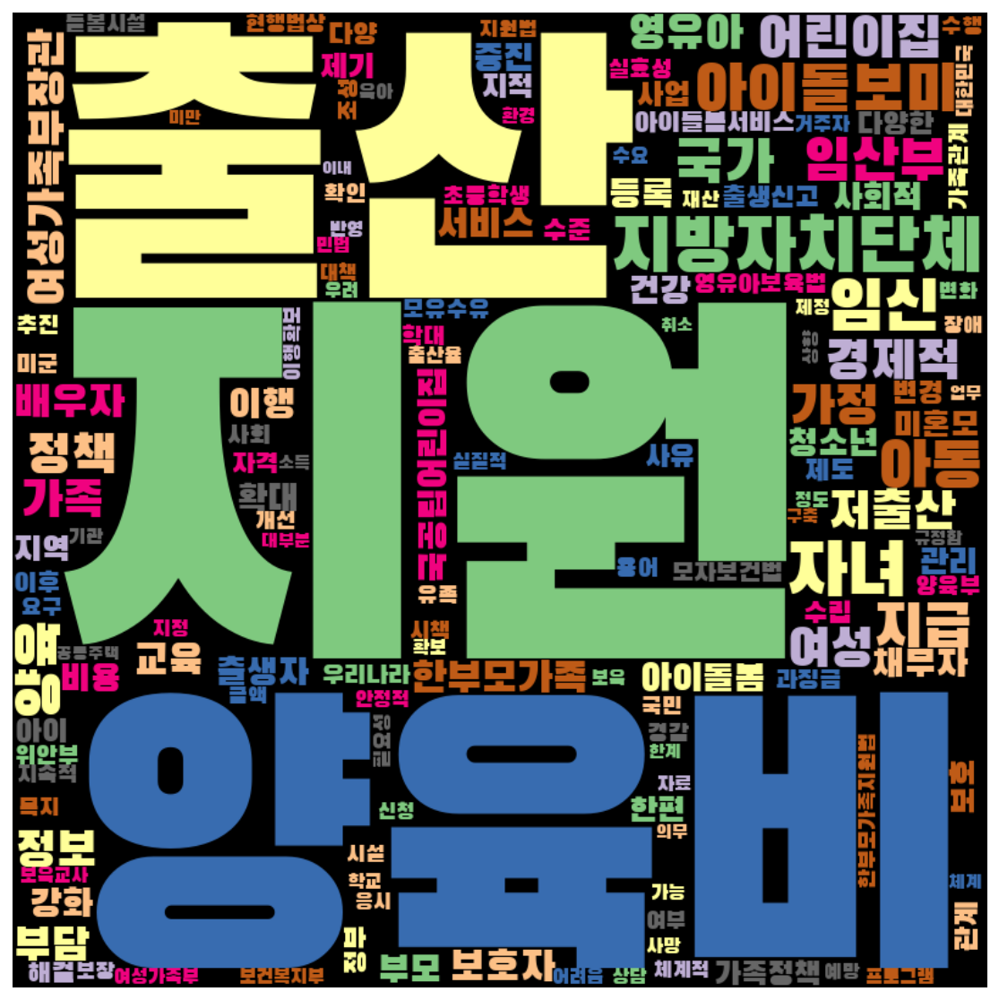

In [238]:
frewords_vis(women_g6_tokens)
wordcloud_vis(women_g6_tokens,'Accent')

In [239]:
# K means 수행 
word_vectors_men = men['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_men)
men['category'] = idx

<ipython-input-239-ea17c2f5c726>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['category'] = idx


In [240]:
men['category'].value_counts()

2    246
5    163
0    150
1     79
3     77
4     45
Name: category, dtype: int64

In [241]:
men_g1 = men[men['category'] == 0]
men_g2 = men[men['category'] == 1]
men_g3 = men[men['category'] == 2]
men_g4 = men[men['category'] == 3]
men_g5 = men[men['category'] == 4]
men_g6 = men[men['category'] == 5]

In [242]:
men_g1_tokens = total_tokens(men_g1['tokens'])
men_g2_tokens = total_tokens(men_g2['tokens'])
men_g3_tokens = total_tokens(men_g3['tokens'])
men_g4_tokens = total_tokens(men_g4['tokens'])
men_g5_tokens = total_tokens(men_g5['tokens'])
men_g6_tokens = total_tokens(men_g6['tokens'])

In [243]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
men_g1_tokens = [each_word for each_word in men_g1_tokens if each_word not in stopwords]
men_g2_tokens = [each_word for each_word in men_g2_tokens if each_word not in stopwords]
men_g3_tokens = [each_word for each_word in men_g3_tokens if each_word not in stopwords]
men_g4_tokens = [each_word for each_word in men_g4_tokens if each_word not in stopwords]
men_g5_tokens = [each_word for each_word in men_g5_tokens if each_word not in stopwords]
men_g6_tokens = [each_word for each_word in men_g6_tokens if each_word not in stopwords]

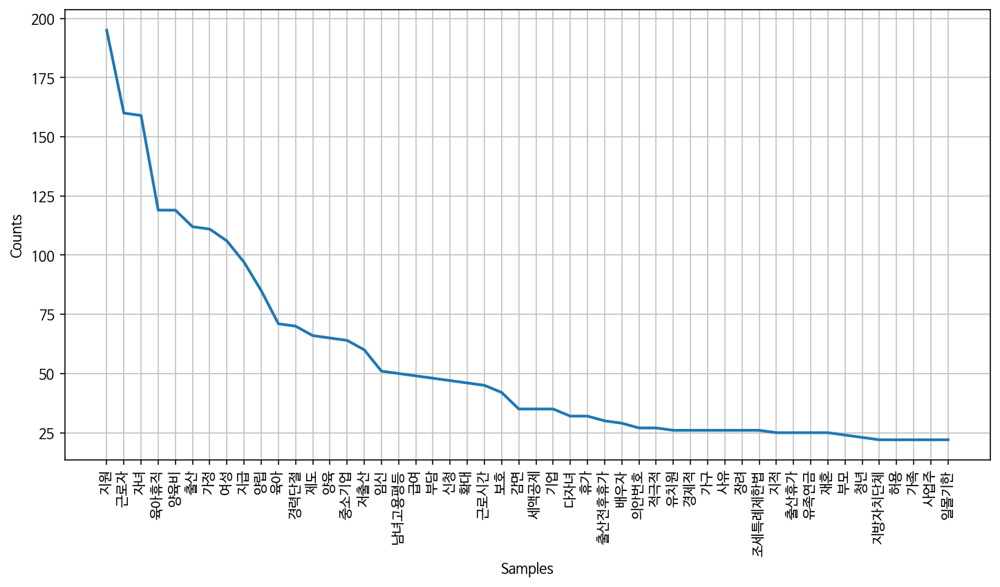

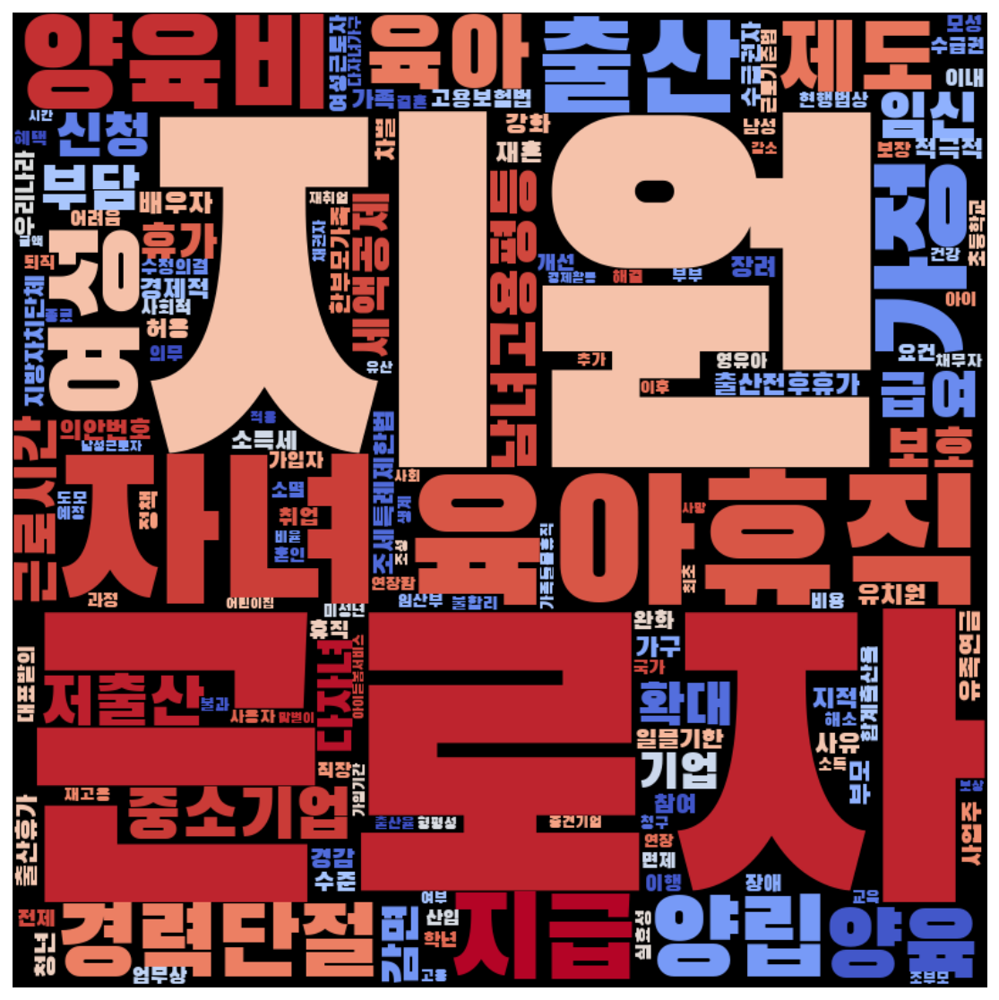

In [244]:
frewords_vis(men_g1_tokens)
wordcloud_vis(men_g1_tokens,'coolwarm')

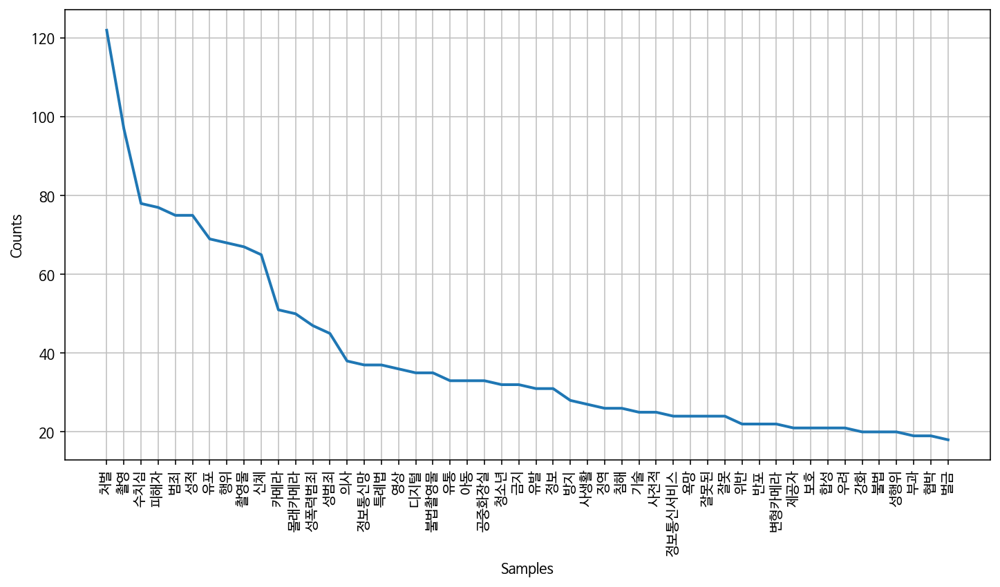

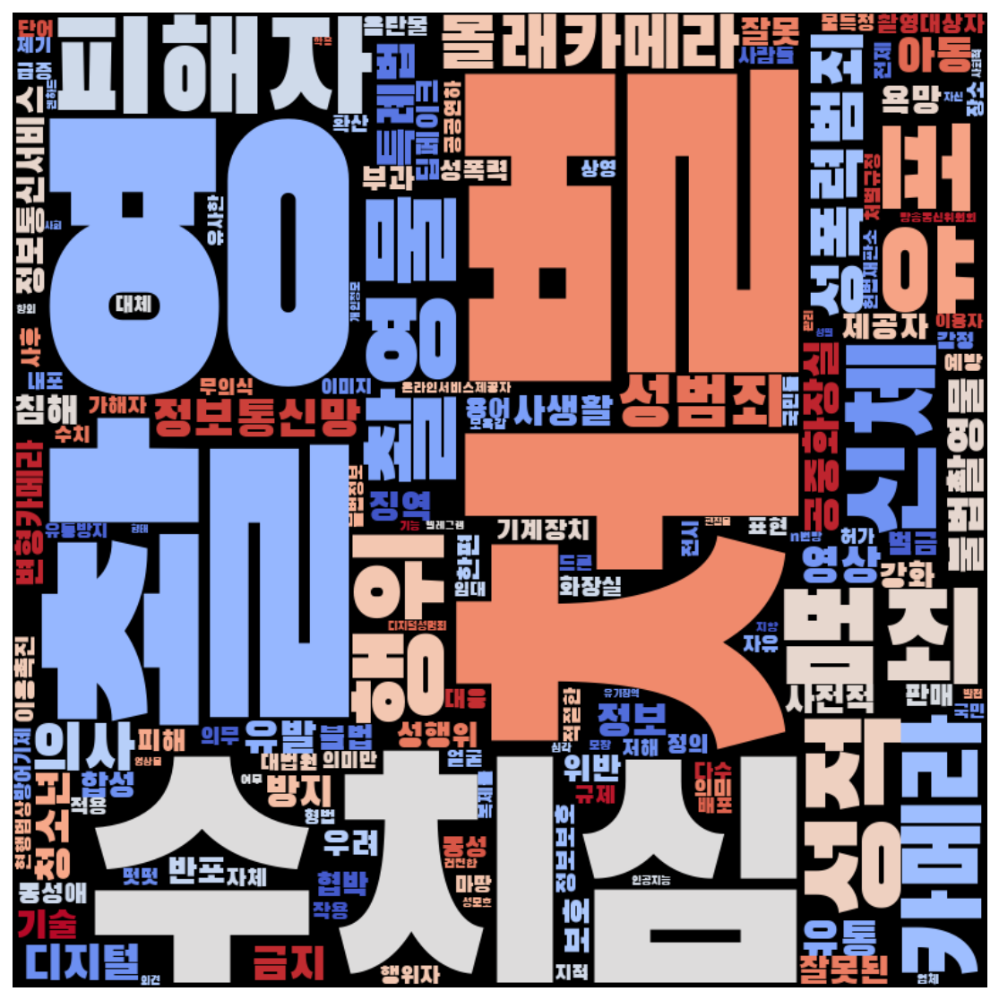

In [245]:
frewords_vis(men_g2_tokens)
wordcloud_vis(men_g2_tokens,'coolwarm')

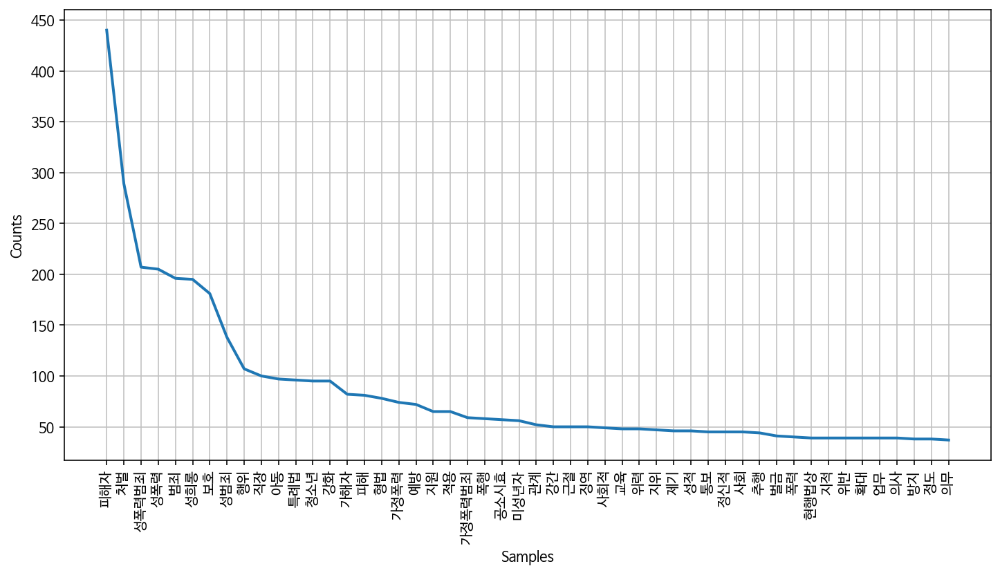

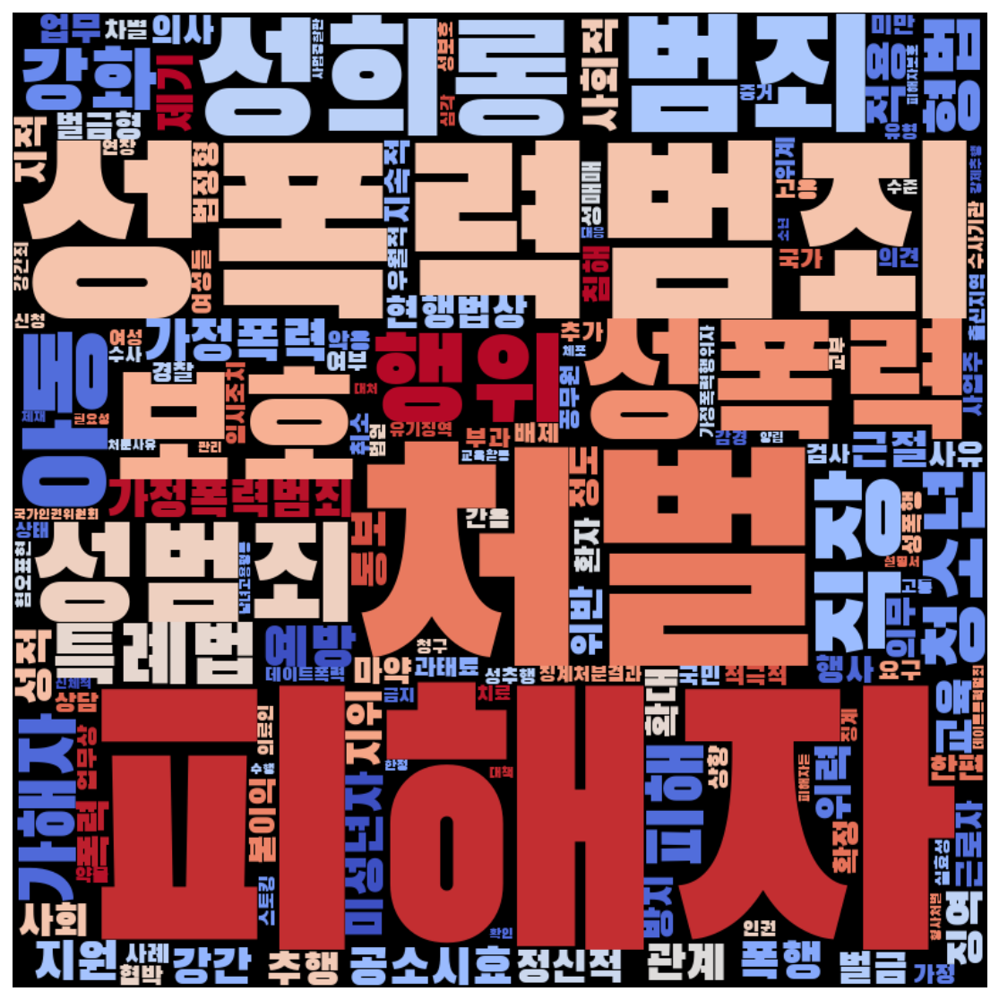

In [246]:
frewords_vis(men_g3_tokens)
wordcloud_vis(men_g3_tokens,'coolwarm')

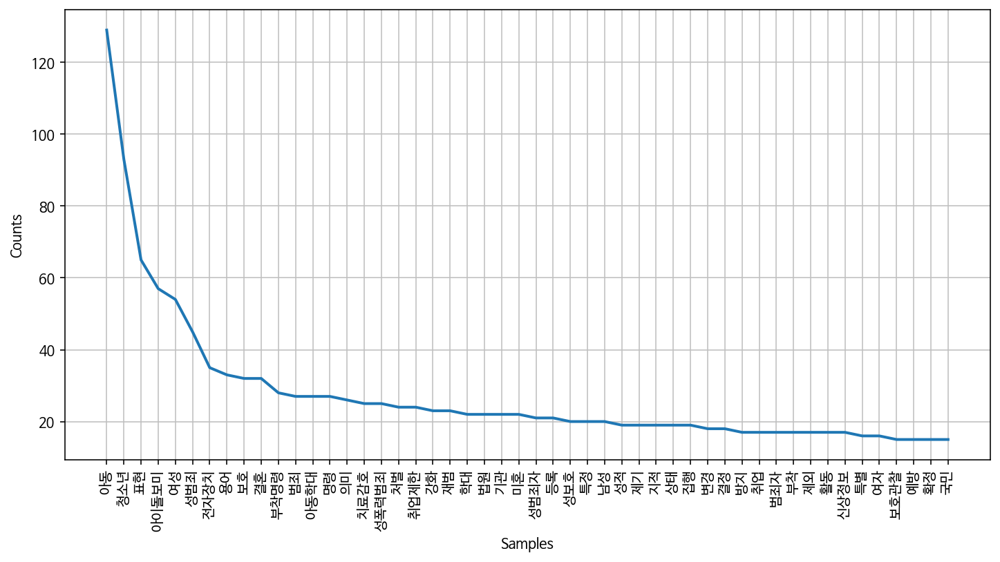

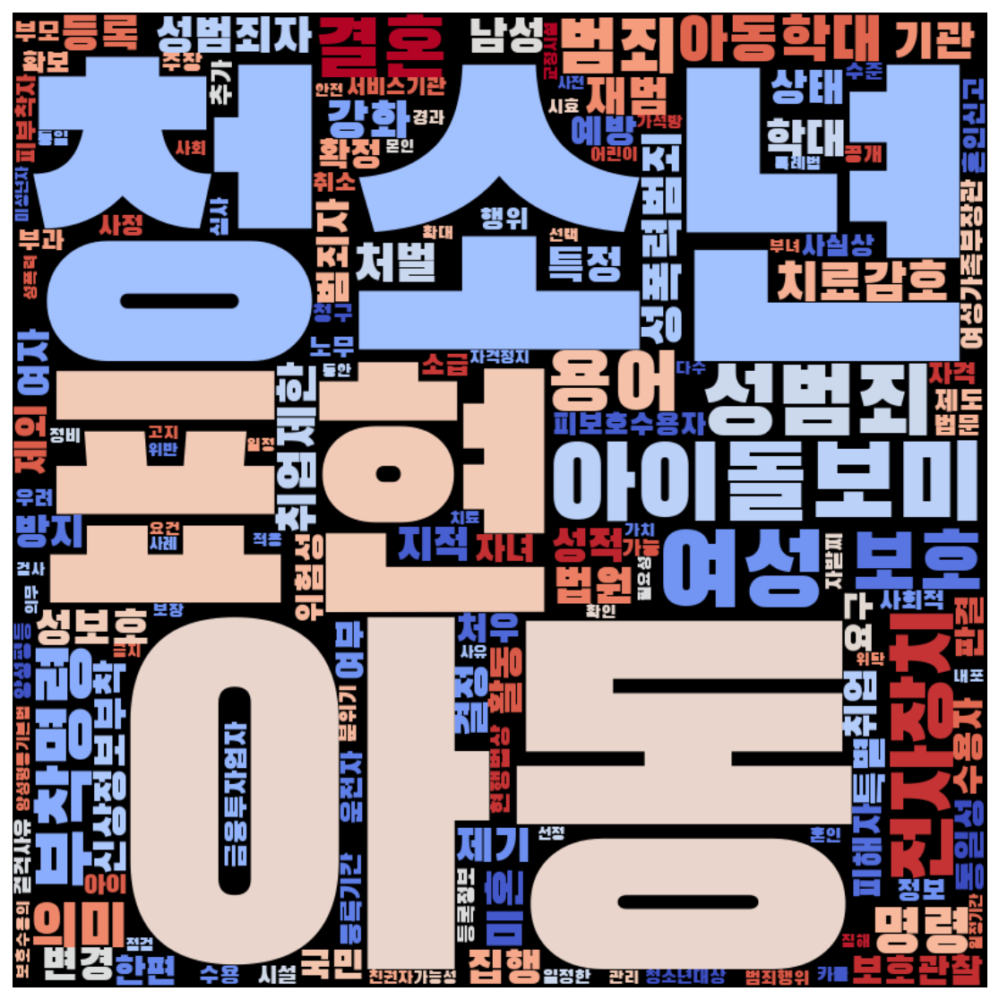

In [247]:
frewords_vis(men_g4_tokens)
wordcloud_vis(men_g4_tokens,'coolwarm')

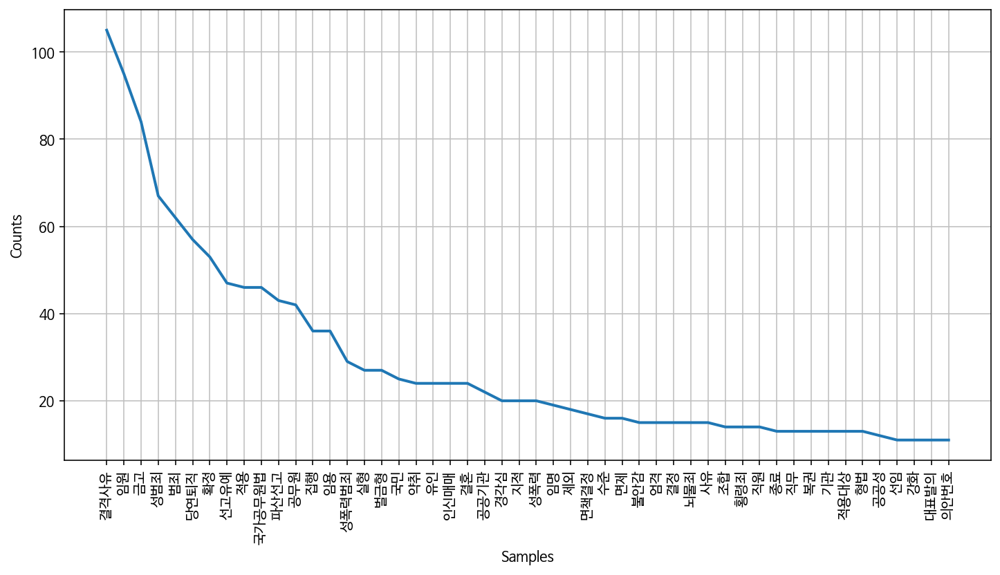

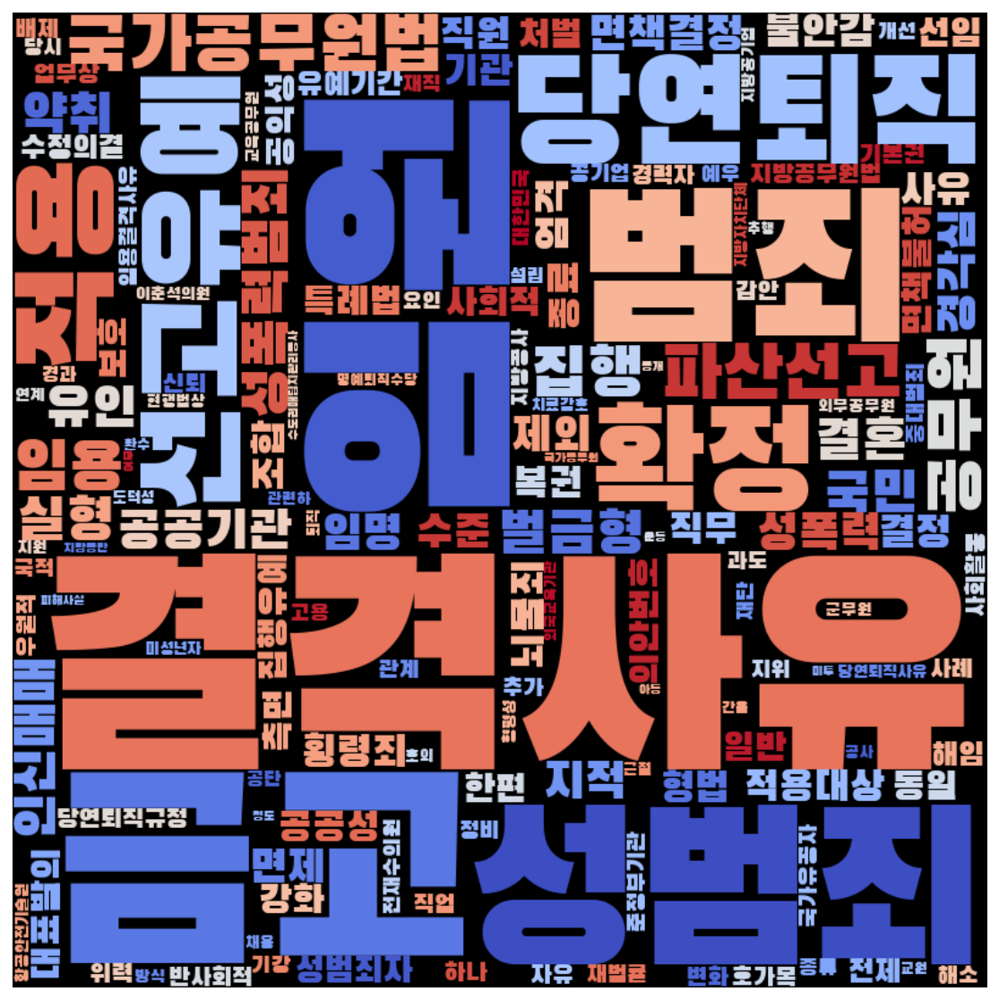

In [248]:
frewords_vis(men_g5_tokens)
wordcloud_vis(men_g5_tokens,'coolwarm')

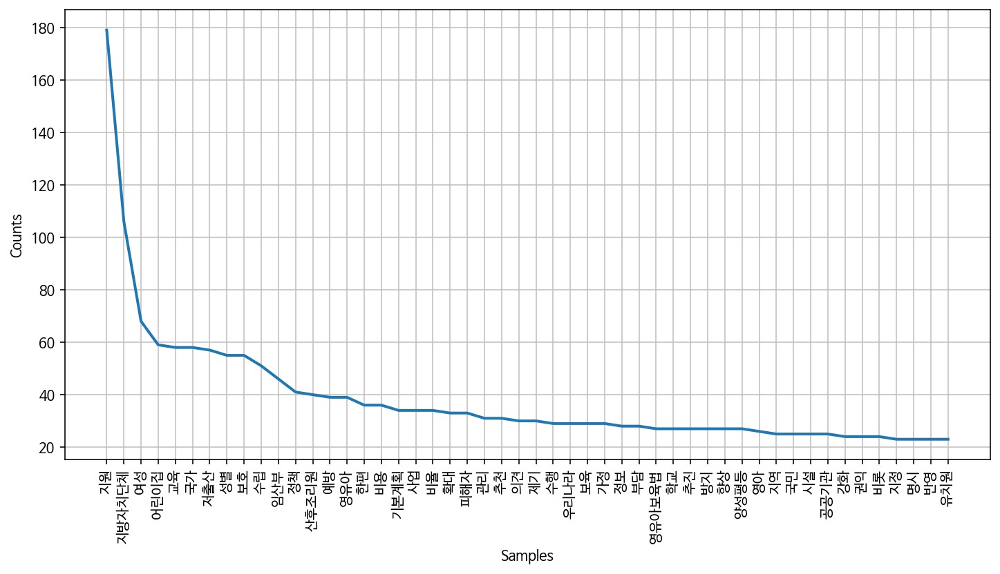

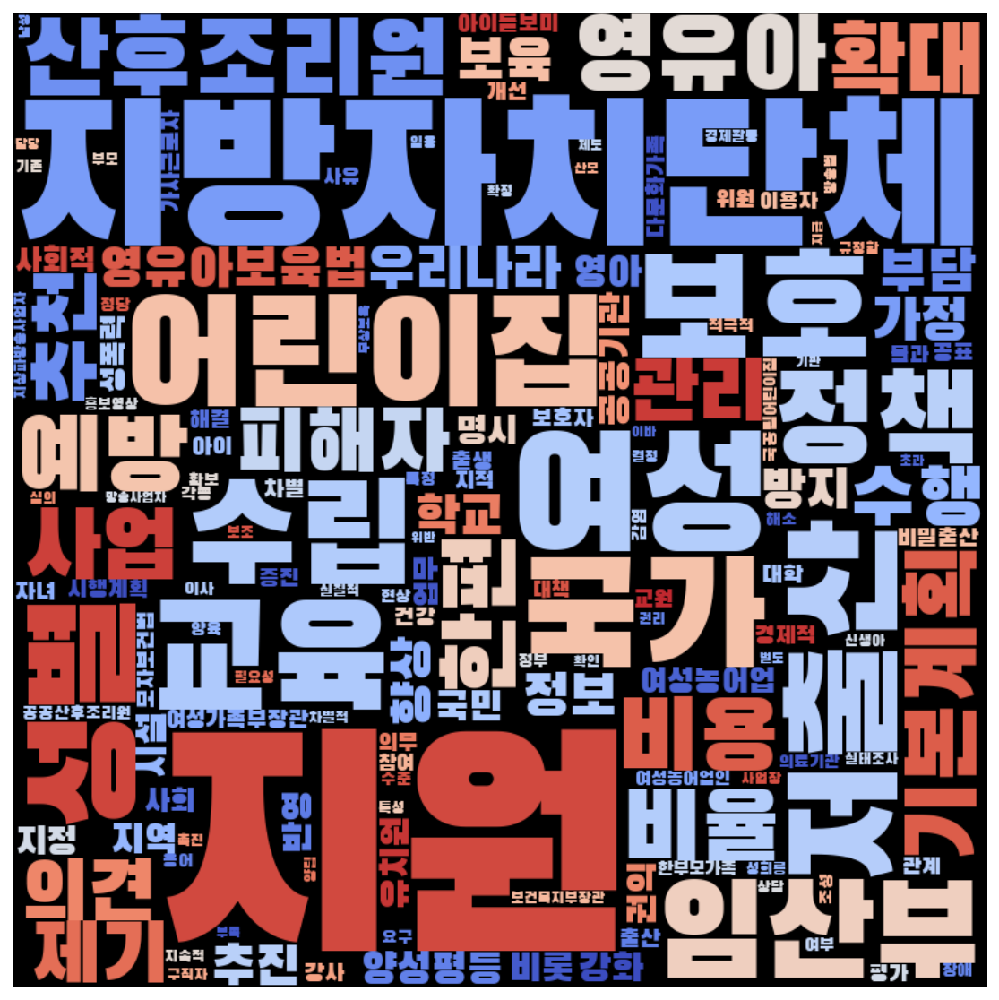

In [249]:
frewords_vis(men_g6_tokens)
wordcloud_vis(men_g6_tokens,'coolwarm')